In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
%matplotlib inline
import matplotlib.pyplot as plt

import sys 
import inspect
import seaborn as sns
import os

import perturbseq as perturb

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis')
sc.logging.print_versions()

scanpy==1.5.1 anndata==0.7.1 umap==0.4.4 numpy==1.17.2 scipy==1.4.1 pandas==0.24.2 scikit-learn==0.22 statsmodels==0.11.0 python-igraph==0.7.1 louvain==0.6.1 leidenalg==0.8.1


In [2]:
PROTEIN='KRAS'
DATA='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14'
SUBSAMPLED=DATA+'/'+PROTEIN+'/subsampled/A549.'+PROTEIN

counts=20000

FIGS=DATA+'/2020-09-15_Figures/'
DATADUMP=DATA+'/2020-09-15_Tables/'
os.system('mkdir -p '+FIGS)
print(FIGS)
os.system('mkdir -p '+DATADUMP)
print(DATADUMP)

sc.settings.figdir=FIGS

/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14/2020-09-15_Figures/
/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14/2020-09-15_Tables/


In [3]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [4]:
adata.obs_names[:5]

Index(['AGAATAGCAAAGGTGCch0', 'AGGGTGAAGCTCTCGGch0', 'CAAGAAAAGACAAGCCch0',
       'CTACGTCAGTGGAGAAch0', 'CTGAAGTGTAAAGGAGch0'],
      dtype='object')

In [74]:
perturb.tl.bulk(adata,grouping_variable='guide.compact')

In [75]:
import copy
sc_bulk=copy.deepcopy(adata.uns['bulk.guide.compact'].T)
sc_bulk=sc_bulk.drop(columns=['multiple'])

In [76]:
#save bulk for the clustering
res=DATA+'/'+PROTEIN+'/clustering/'+PROTEIN
os.system('mkdir -p '+DATA+'/'+PROTEIN+'/clustering/')
sc_bulk.to_csv(res+'.bulk.csv')
print(res+'.bulk.csv')

/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2020-02-14/KRAS/clustering/KRAS.bulk.csv


In [77]:
#go to the R clustering notebook to cluster the variants
#bye!

#back!

In [78]:
#make the anno table
#add scores and cluster information
#read in the annotation file to add the clusters to it

FDR=0.01
#original anno
ANNO=DATA+'/'+PROTEIN+'/anno'
anno=pd.read_csv(ANNO+'/'+PROTEIN+'.anno.complete2.csv',sep='\t')
anno.index=anno['Variant']

anno['Position']=anno['Position'].astype('Int32')
anno['Count_pancan']=anno['Count_pancan'].astype('Int32')
anno['Count_ExAC']=anno['Count_ExAC'].astype('Int32')

#scores
ref='K169K'
score='HotellingT2'
scores=pd.read_csv(DATA+'/'+PROTEIN+'/scoring/'+PROTEIN+'.scores_vs_'+ref+'.csv')
scores.index=scores['group2']
anno[score]=scores.loc[anno.index,score]
anno['FDR.'+score]=scores.loc[anno.index,'FDR.'+score]

#cluster info
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants_df.index=sorted_variants_df[0]
anno['cluster_color']=sorted_variants_df.loc[anno.index,1]

#functional data
f='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2019-06-07/KRAS/mutational_signatures/KRAS_mutationalSignatures_Andrew.txt'
mutsig=pd.read_csv(f,sep='\t')
mutsig.index=mutsig['Mutation']

#modify the names for the synonymous ones
import re
new_vars=[]
for i in range(mutsig.shape[0]):
    v=mutsig.index[i]
    new_var_here=v
    if 'B' in v:
        new_var_here=re.sub('B',v[0],v)
    new_vars.append(new_var_here)
mutsig.index=new_vars

anno['Z-Low-D7']=mutsig.loc[anno.index,'Z-Low-D7']
anno['Z-Low-D14']=mutsig.loc[anno.index,'Z-Low-D14']

anno.head()



,Variant,Variant.1,Position,From,To,mutation_type,Count_pancan,Count_ExAC,control_status,control_color,Library_synthesis,long_name,control_status2,text_color,HotellingT2,FDR.HotellingT2,cluster_color,Z-Low-D7,Z-Low-D14
Variant,,,,,,,,,,,,,,,,,,,
G12D,G12D,G12D,12,C,T,Single,1782,NaN,unknown,white,in,KRAS_G12D,hotspot,red,6675.185293,0.004016,red,7.30,6.41
G12V,G12V,G12V,12,C,A,Single,1539,NaN,unknown,white,in,KRAS_G12V,hotspot,red,4679.646249,0.004016,red,6.88,5.89
G12C,G12C,G12C,12,C,A,Single,1110,NaN,unknown,white,in,KRAS_G12C,hotspot,red,4750.879970,0.004016,red,5.55,4.74
G13D,G13D,G13D,13,C,T,Single,582,NaN,unknown,white,not in library,NaN,hotspot,red,NaN,NaN,NaN,5.68,4.90
G12A,G12A,G12A,12,C,G,Single,353,NaN,unknown,white,in,KRAS_G12A,hotspot,red,4642.709510,0.004016,red,3.28,2.30


In [79]:
#annotate the cluster color onto the adata
adata.obs['Cluster']=list(anno.loc[adata.obs['guide.compact'],'cluster_color'])

In [80]:
adata.obs['Cluster2']=list(anno.loc[adata.obs['guide.compact'],'cluster_color'])
adata.obs['Cluster2'][adata.obs['guide.compact']=='unassigned']='slateblue'

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


... storing 'Cluster' as categorical
... storing 'Cluster2' as categorical


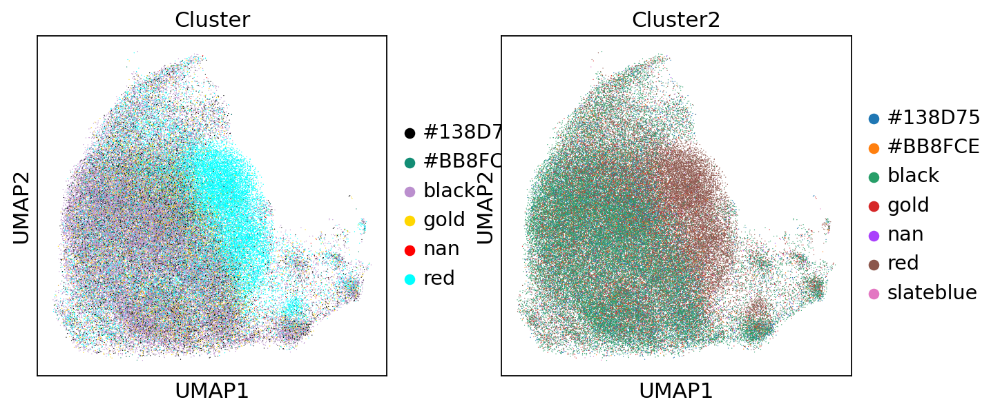

In [81]:
sc.pl.umap(adata,color=['Cluster','Cluster2'])

In [ ]:
adata.write(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad')

In [82]:
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants=list(sorted_variants_df[0])
print(sorted_variants)

['M111L', 'T127T', 'V112I', 'R149K', 'S17S', 'T74T', 'I163S', 'G75A', 'K147N', 'G77A', 'K88K', 'WT', 'A155G', 'Y166H', 'K176Q', 'T144T', 'C118S', 'T158T', 'A130V', 'D30D', 'K179R', 'S136N', 'T158A', 'T20T', 'D173D', 'V8V', 'A66A', 'M170L', 'K169K', 'T50T', 'R135T', 'F141L', 'R164Q', 'P110S', 'K178K', 'L159S', 'L79I', 'Q25H', 'K147T', 'E63K', 'V14I', 'T50I', 'T50P', 'E31K', 'Q99E', 'R41K', 'T20R', 'Q22H', 'C185Y', 'T20M', 'T144P', 'L52F', 'T74A', 'D57N', 'unassigned', 'N26Y', 'D33E', 'L19F', 'Q61K', 'P34L', 'K5E', 'P34R', 'G60D', 'Q61P', 'G60S', 'G60V', 'R68S', 'I36M', 'T58I', 'Q22K', 'K117R', 'A59T', 'AG59GV', 'D119G', 'G12Y', 'G12F', 'V14L', 'A59E', 'G12S', 'G12A', 'A59G', 'A146V', 'G13C', 'G12C', 'A146P', 'A146T', 'G12V', 'AG11TD', 'G12D', 'G12I', 'G12R', 'Q61A', 'Q61H', 'Q61R', 'Q61L', 'G13E', 'K117N', 'G13V', 'G13R']


In [83]:
#number of cells
#===== cells/variant
#======================

adata_full=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.analysis.h5ad')
print(adata_full)
new_mut=[]
for i in range(adata_full.n_obs):
    v=adata_full.obs['mut.std'][i]
    if v=='uninfected':
        v='unassigned'
    elif v=='H166Y':
        v='Y166H'
    else:
        v=v
    new_mut.append(v)
adata_full.obs['mut.std']=new_mut

#annotate the cluster color onto the adata

cells_per_variant=pd.DataFrame(adata_full.obs['mut.std'].value_counts())
cells_per_variant['variant']=list(cells_per_variant.index)
print(cells_per_variant.head())



Only considering the two last: ['.analysis', '.h5ad'].
Only considering the two last: ['.analysis', '.h5ad'].
AnnData object with n_obs × n_vars = 150044 × 1145 
    obs: 'KRAS_A146P', 'KRAS_A146T', 'KRAS_A146V', 'KRAS_A59E', 'KRAS_A59G', 'KRAS_A59T', 'KRAS_AG11TD', 'KRAS_AG59GV', 'KRAS_C118S', 'KRAS_D119G', 'KRAS_D33E', 'KRAS_D57N', 'KRAS_E31K', 'KRAS_E63K-', 'KRAS_G12A', 'KRAS_G12C', 'KRAS_G12D', 'KRAS_G12F', 'KRAS_G12I', 'KRAS_G12R', 'KRAS_G12S', 'KRAS_G12V', 'KRAS_G12Y', 'KRAS_G13C', 'KRAS_G13E', 'KRAS_G13R', 'KRAS_G13V', 'KRAS_G60D', 'KRAS_G60S', 'KRAS_G60V', 'KRAS_H166Y', 'KRAS_I163S', 'KRAS_I36M', 'KRAS_K117N', 'KRAS_K117R', 'KRAS_K147N', 'KRAS_K147T', 'KRAS_K176Q', 'KRAS_K5E', 'KRAS_L159S', 'KRAS_L19F', 'KRAS_L52F', 'KRAS_L79I', 'KRAS_M111L', 'KRAS_N26Y', 'KRAS_P110S', 'KRAS_P34L', 'KRAS_P34R', 'KRAS_Q22H', 'KRAS_Q22K', 'KRAS_Q25H', 'KRAS_Q61A', 'KRAS_Q61H', 'KRAS_Q61K', 'KRAS_Q61L', 'KRAS_Q61P', 'KRAS_Q61R', 'KRAS_Q99E', 'KRAS_R135T', 'KRAS_R149K', 'KRAS_R164Q', 'KRAS_R41K', '

In [84]:
adata_full=perturb.pp.subsample_cells(adata_full,2000,'mut.std')

In [85]:
adata_full.obs['Cluster']=list(anno.loc[adata_full.obs['mut.std'],'cluster_color'])

Trying to set attribute `.obs` of view, copying.


In [102]:
group_names=[]
group_dict={'black':'Neutral','#138D75':'Semi-neutral',
           '#BB8FCE':'Atypical','gold':'Semi-neutral gain',
           'red':'Gain-of-function'}
group_dict={'black':'N','#138D75':'sN',
           '#BB8FCE':'A','gold':'sN-G',
           'red':'G'}
for i in range(adata_full.n_obs):
    n=''
    c=adata_full.obs['Cluster'][i]
    if c in group_dict:
        n=group_dict[c]
    group_names.append(n)
adata_full.obs['Cluster.name']=group_names

group_names=[]
for i in range(adata.n_obs):
    n=''
    c=adata.obs['Cluster'][i]
    if c in group_dict:
        n=group_dict[c]
    group_names.append(n)
adata.obs['Cluster.name']=group_names

In [87]:

cells_per_variant_group=pd.DataFrame(adata_full.obs['Cluster.name'].value_counts())
cells_per_variant_group['variant']=list(cells_per_variant_group.index)


In [88]:
sorted_groups=['Neutral','Semi-neutral','Atypical','Semi-neutral gain','Gain-of-function']
sorted_groups=['N','sN','A','sN-G','G']

In [89]:
group_color=['black','#138D75','#BB8FCE','gold','red']
anno_groups=pd.DataFrame({'group':sorted_groups,
                         'color':group_color},index=sorted_groups)
print(anno_groups)
anno_groups.to_csv(ANNO+'/'+PROTEIN+'.anno_groups.csv',sep='\t')

     group    color
N        N    black
sN      sN  #138D75
A        A  #BB8FCE
sN-G  sN-G     gold
G        G      red


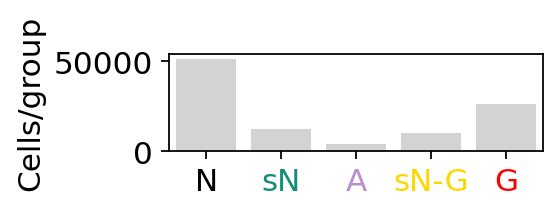

In [99]:
fig,plots=plt.subplots(1)
fig.set_size_inches(3,0.8)
plots.bar(cells_per_variant_group.loc[sorted_groups,'variant'],
           cells_per_variant_group.loc[sorted_groups,'Cluster.name'],
          color='lightgray')

#cells_per_variant.plot.bar(x='variant',y='mut.std',ax=plots)
#plots.set_xlim(0,2000)
plots.set_xlim(-0.5,len(sorted_groups)-0.5)
plots.grid(False)

a=[t.set_color(i) for (i,t) in
 zip(anno_groups.loc[sorted_groups,'color'],plots.xaxis.get_ticklabels())]
plots.set_ylabel('Cells/group')
#plots.set_xticklabels(sorted_groups), rotation=45,ha='right')

plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.groups.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.groups.png',bbox_inches = "tight")
plt.show()

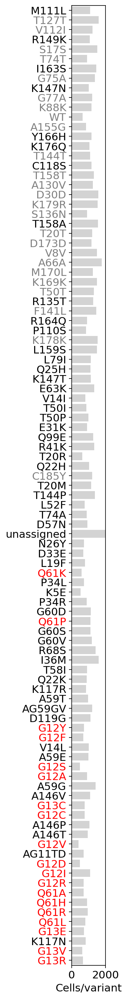

In [91]:
fig,plots=plt.subplots(1)
fig.set_size_inches(0.8,23)
plots.barh(cells_per_variant.loc[sorted_variants,'variant'].iloc[::-1],
           cells_per_variant.loc[sorted_variants,'mut.std'].iloc[::-1],
          color='lightgray')

#cells_per_variant.plot.bar(x='variant',y='mut.std',ax=plots)
plots.set_xlim(0,2000)
plots.set_ylim(-0.5,len(sorted_variants)-0.5)
plots.grid(False)
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'text_color'],plots.yaxis.get_ticklabels())]
plots.set_xlabel('Cells/variant')


plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.png',bbox_inches = "tight")
plt.show()

In [92]:
anno['Cells/variant']=cells_per_variant.loc[anno.index,'mut.std']

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


In [93]:
adata.obs['vbc.counts'].head()

AGAATAGCAAAGGTGCch0    0.000066
AGGGTGAAGCTCTCGGch0    0.000033
CAAGAAAAGACAAGCCch0    0.000208
CTACGTCAGTGGAGAAch0    0.000118
CTGAAGTGTAAAGGAGch0    0.000236
Name: vbc.counts, dtype: float64

In [94]:
vbc_counts=pd.DataFrame({'mut.std':adata.obs['guide.compact'],
                        'vbc_norm':10000*adata.obs['vbc.counts']})

#do DE test to find sig different ones
from scipy import stats

fdr=0.1

de_vbc=pd.DataFrame({'variant':list(set(vbc_counts['mut.std'])),
                    'p':-1,
                    'sign':1,
                    'mean_expr':-1})
for v in de_vbc['variant']:
    v_values=vbc_counts.loc[vbc_counts['mut.std']==v,'vbc_norm']
    wt_values=vbc_counts.loc[vbc_counts['mut.std']=='WT','vbc_norm']
    logratio=np.log2(np.mean(v_values)/np.mean(wt_values))
    ttest_out=stats.ttest_ind(v_values,wt_values, equal_var = False)
    p=ttest_out[1]
    de_vbc.loc[de_vbc['variant']==v,'p']=p
    de_vbc.loc[de_vbc['variant']==v,'sign']=np.sign(ttest_out[0])
    de_vbc.loc[de_vbc['variant']==v,'mean_expr']=np.mean(v_values)
    de_vbc.loc[de_vbc['variant']==v,'log2ratio_to_wt']=logratio
    
de_vbc=de_vbc.sort_values(by='p')
from statsmodels.stats.multitest import multipletests
de_vbc['p.bh']=multipletests(de_vbc['p'], alpha=0.05, method='fdr_bh')[1]
de_vbc['signed_minuslogp.bh']=-de_vbc['sign']*np.log10(de_vbc['p.bh'])
de_vbc.index=de_vbc['variant']
print(de_vbc.loc[de_vbc['p.bh']<fdr,:])
de_vbc=de_vbc.sort_values(by='signed_minuslogp.bh',ascending=True)

import copy
vbc_counts['Normalized variant\n barcode counts']=vbc_counts['vbc_norm']
vbc_counts_clip=copy.deepcopy(vbc_counts)
vbc_counts_clip['Normalized variant\n barcode counts'][vbc_counts_clip['Normalized variant\n barcode counts']>5.0]=5.0

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in log2
  app.launch_new_instance()


               variant              p  sign  mean_expr  log2ratio_to_wt  \
variant                                                                   
unassigned  unassigned  8.232632e-150  -1.0   0.000000             -inf   
Q61K              Q61K   5.259161e-50  -1.0   0.682810        -0.981610   
multiple      multiple   1.423335e-46   1.0   2.264851         0.748250   
Q61L              Q61L   1.466745e-26  -1.0   0.867673        -0.635943   
T74A              T74A   3.810008e-22  -1.0   0.917723        -0.555036   
G12A              G12A   8.065837e-19   1.0   1.880001         0.479567   
K178K            K178K   1.787272e-16   1.0   1.810542         0.425255   
Q61R              Q61R   1.538130e-14  -1.0   0.989151        -0.446904   
L159S            L159S   1.783007e-13   1.0   1.752377         0.378147   
Q61A              Q61A   1.839250e-13  -1.0   1.000501        -0.430444   
T58I              T58I   3.979572e-11  -1.0   1.046082        -0.366172   
G12C              G12C   

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [95]:
var_expr_color={}
for i in range(de_vbc.shape[0]):
    col='lightgray'
    mut=de_vbc.iloc[i,0]
    pbh=de_vbc.iloc[i,1]
    direction=de_vbc.iloc[i,2]
    logratio=de_vbc['log2ratio_to_wt'][i]
    val=-np.log10(pbh)
    if np.abs(logratio)>0.5849: #1.5 fold change
        col='red'
    var_expr_color[mut]=col

In [96]:
variants=perturb.util.get_perturbations(adata,compact=True)
variants.append('unassigned')
print(variants)
constr_expr_avg=vbc_counts.groupby('mut.std').mean()
anno['variant expression']=0
anno.loc[variants,'variant_expression']=constr_expr_avg.loc[variants,
                                                                   'Normalized variant\n barcode counts']


['A130V', 'A146P', 'A146T', 'A146V', 'A155G', 'A59E', 'A59G', 'A59T', 'A66A', 'AG11TD', 'AG59GV', 'C118S', 'C185Y', 'D119G', 'D173D', 'D30D', 'D33E', 'D57N', 'E31K', 'E63K', 'F141L', 'G12A', 'G12C', 'G12D', 'G12F', 'G12I', 'G12R', 'G12S', 'G12V', 'G12Y', 'G13C', 'G13E', 'G13R', 'G13V', 'G60D', 'G60S', 'G60V', 'G75A', 'G77A', 'I163S', 'I36M', 'K117N', 'K117R', 'K147N', 'K147T', 'K169K', 'K176Q', 'K178K', 'K179R', 'K5E', 'K88K', 'L159S', 'L19F', 'L52F', 'L79I', 'M111L', 'M170L', 'N26Y', 'P110S', 'P34L', 'P34R', 'Q22H', 'Q22K', 'Q25H', 'Q61A', 'Q61H', 'Q61K', 'Q61L', 'Q61P', 'Q61R', 'Q99E', 'R135T', 'R149K', 'R164Q', 'R41K', 'R68S', 'S136N', 'S17S', 'T127T', 'T144P', 'T144T', 'T158A', 'T158T', 'T20M', 'T20R', 'T20T', 'T50I', 'T50P', 'T50T', 'T58I', 'T74A', 'T74T', 'V112I', 'V14I', 'V14L', 'V8V', 'WT', 'Y166H', 'unassigned']


In [97]:
anno['variant_expression'].describe()

count    99.000000
mean      1.344807
std       0.237248
min       0.000000
25%       1.245680
50%       1.348324
75%       1.473713
max       1.880001
Name: variant_expression, dtype: float64

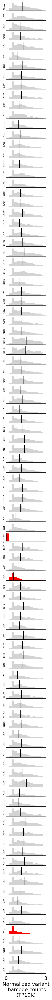

In [98]:
def plot_variant_expr(vbc_counts_clip,sorted_variants,var_expr_color,mini=0.0,maxi=0.0005):
    fig, ax = plt.subplots(len(sorted_variants),1)
    fig.set_size_inches(2,50)
    for idx in range(len(sorted_variants)):
        v=sorted_variants[idx]
        color=var_expr_color[v]
        a=vbc_counts_clip.loc[vbc_counts_clip['mut.std']==v,'Normalized variant\n barcode counts']
        if v=='uninfected':
            a=0.0*a
        wt=vbc_counts_clip.loc[vbc_counts_clip['mut.std']=='WT','Normalized variant\n barcode counts']
        multi=5
        bins=[x/multi for x in range(int(maxi*multi))]
        #print(bins)
        outplot=sns.distplot(a, ax=ax[idx], kde=False,hist=True,
                             norm_hist=True,color=color,
                             kde_kws={"shade": False},bins=bins,
                            hist_kws=dict(alpha=1))
        ax[idx].set_xlim(mini,maxi)
        # Get the two lines from the axes to generate shading
        ###l1 = outplot.lines[0]

        # Get the xy data from the lines so that we can shade
        ##x1 = l1.get_xydata()[:,0]
        ##y1 = l1.get_xydata()[:,1]
        ##outplot.fill_between(x1,y1, color=color, alpha=1)
        med=np.median(a)
        ax[idx].axes.get_xaxis().set_ticks([])
        ax[idx].axes.get_yaxis().set_ticks([])
        ax[idx].spines['right'].set_visible(False)
        ax[idx].spines['top'].set_visible(False)
        ax[idx].axvline(x=med,color='black')
        ax[idx].set_xlabel('')
        ax[idx].set_ylabel(v,fontsize=5)
    ax[idx].set_xticks([mini,maxi])
    ax[idx].set_xlabel('Normalized variant\n barcode counts\n(TP10K)')
        
plot_variant_expr(vbc_counts_clip,sorted_variants,var_expr_color,mini=0.0,maxi=3)
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr.png',bbox_inches = "tight")

In [103]:
vbc_counts=pd.DataFrame({'mut.std':adata.obs['Cluster.name'],
                        'vbc_norm':10000*adata.obs['vbc.counts']})

#do DE test to find sig different ones
from scipy import stats

fdr=0.1

de_vbc=pd.DataFrame({'variant':list(set(vbc_counts['mut.std'])),
                    'p':-1,
                    'sign':1,
                    'mean_expr':-1})
for v in de_vbc['variant']:
    v_values=vbc_counts.loc[vbc_counts['mut.std']==v,'vbc_norm']
    wt_values=vbc_counts.loc[vbc_counts['mut.std']=='N','vbc_norm']
    logratio=np.log2(np.mean(v_values)/np.mean(wt_values))
    ttest_out=stats.ttest_ind(v_values,wt_values, equal_var = False)
    p=ttest_out[1]
    de_vbc.loc[de_vbc['variant']==v,'p']=p
    de_vbc.loc[de_vbc['variant']==v,'sign']=np.sign(ttest_out[0])
    de_vbc.loc[de_vbc['variant']==v,'mean_expr']=np.mean(v_values)
    de_vbc.loc[de_vbc['variant']==v,'log2ratio_to_wt']=logratio
    
de_vbc=de_vbc.sort_values(by='p')
from statsmodels.stats.multitest import multipletests
de_vbc['p.bh']=multipletests(de_vbc['p'], alpha=0.05, method='fdr_bh')[1]
de_vbc['signed_minuslogp.bh']=-de_vbc['sign']*np.log10(de_vbc['p.bh'])
de_vbc.index=de_vbc['variant']
print(de_vbc.loc[de_vbc['p.bh']<fdr,:])
de_vbc=de_vbc.sort_values(by='signed_minuslogp.bh',ascending=True)

import copy
vbc_counts['Normalized variant\n barcode counts']=vbc_counts['vbc_norm']
vbc_counts_clip=copy.deepcopy(vbc_counts)
vbc_counts_clip['Normalized variant\n barcode counts'][vbc_counts_clip['Normalized variant\n barcode counts']>5.0]=5.0

        variant              p  sign  mean_expr  log2ratio_to_wt  \
variant                                                            
A             A  8.751381e-148  -1.0   0.910155        -0.611752   
                  4.338460e-63   1.0   2.264851         0.703480   
G             G   2.491136e-13  -1.0   1.333448        -0.060775   
sN           sN   1.761237e-03  -1.0   1.358342        -0.034089   
sN-G       sN-G   2.185906e-02  -1.0   1.364323        -0.027751   

                  p.bh  signed_minuslogp.bh  
variant                                      
A        5.250828e-147          -146.279772  
          1.301538e-62            61.885543  
G         4.982273e-13           -12.302573  
sN        2.641856e-03            -2.578091  
sN-G      2.623087e-02            -1.581187  


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [104]:
var_expr_color={}
for i in range(de_vbc.shape[0]):
    col='lightgray'
    mut=de_vbc.iloc[i,0]
    pbh=de_vbc.iloc[i,1]
    direction=de_vbc.iloc[i,2]
    logratio=de_vbc['log2ratio_to_wt'][i]
    val=-np.log10(pbh)
    if np.abs(logratio)>0.5849: #1.5 fold change
        col='red'
    var_expr_color[mut]=col

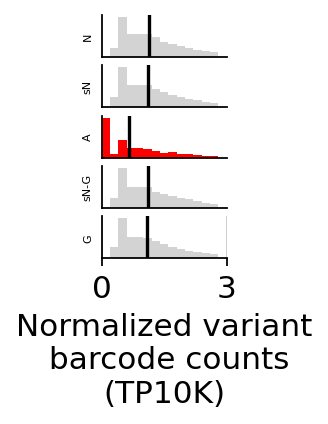

In [107]:
def plot_variant_expr(vbc_counts_clip,sorted_variants,var_expr_color,mini=0.0,maxi=0.0005):
    fig, ax = plt.subplots(len(sorted_variants),1)
    fig.set_size_inches(1,2)
    for idx in range(len(sorted_variants)):
        v=sorted_variants[idx]
        color=var_expr_color[v]
        a=vbc_counts_clip.loc[vbc_counts_clip['mut.std']==v,'Normalized variant\n barcode counts']
        if v=='uninfected':
            a=0.0*a
        wt=vbc_counts_clip.loc[vbc_counts_clip['mut.std']=='WT','Normalized variant\n barcode counts']
        multi=5
        bins=[x/multi for x in range(int(maxi*multi))]
        #print(bins)
        outplot=sns.distplot(a, ax=ax[idx], kde=False,hist=True,
                             norm_hist=True,color=color,
                             kde_kws={"shade": False},bins=bins,
                            hist_kws=dict(alpha=1))
        ax[idx].set_xlim(mini,maxi)
        # Get the two lines from the axes to generate shading
        ###l1 = outplot.lines[0]

        # Get the xy data from the lines so that we can shade
        ##x1 = l1.get_xydata()[:,0]
        ##y1 = l1.get_xydata()[:,1]
        ##outplot.fill_between(x1,y1, color=color, alpha=1)
        med=np.median(a)
        ax[idx].axes.get_xaxis().set_ticks([])
        ax[idx].axes.get_yaxis().set_ticks([])
        ax[idx].spines['right'].set_visible(False)
        ax[idx].spines['top'].set_visible(False)
        ax[idx].axvline(x=med,color='black')
        ax[idx].set_xlabel('')
        ax[idx].set_ylabel(v,fontsize=5)
    ax[idx].set_xticks([mini,maxi])
    ax[idx].set_xlabel('Normalized variant\n barcode counts\n(TP10K)')
        
plot_variant_expr(vbc_counts_clip,sorted_groups,var_expr_color,mini=0.0,maxi=3)
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr.groups.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr.groups.png',bbox_inches = "tight")

In [26]:
anno['Control']=anno['control_color']
anno['Cluster']=anno['cluster_color']
anno['Cluster2']=anno['Cluster']
anno.loc['unassigned','Cluster2']='slateblue'

In [27]:
anno.loc['unassigned','variant_expression']=0

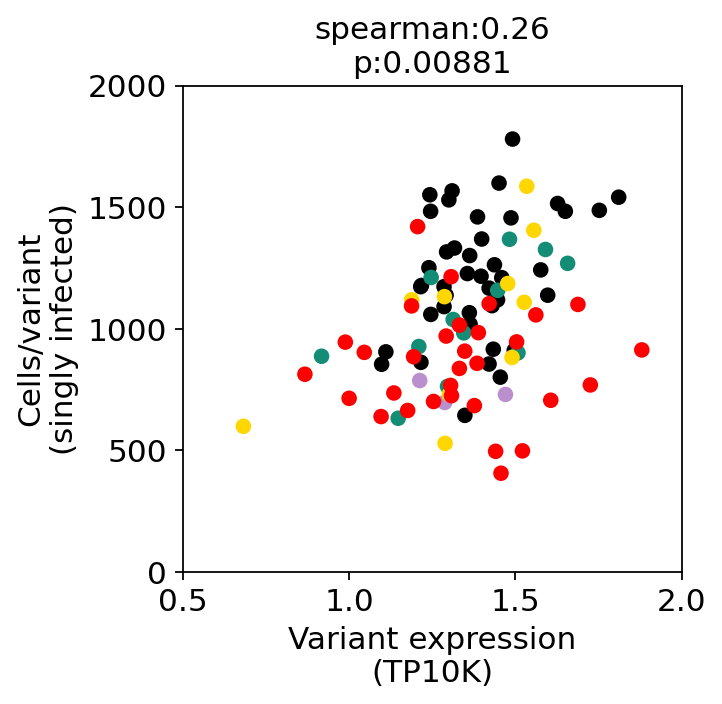

In [32]:
#average expression vs number of cells

def fun_scatter(x,y,xname='x',yname='y',width=4,height=4,corrtype='spearman',
                xlim=None,ylim=None,
                **kwargs):
    from scipy.stats import spearmanr, pearsonr
    if corrtype=='spearman':
        corr=spearmanr(x,y,nan_policy='omit')
    if corrtype=='pearson':
        corr=pearsonr(x,y)
    c,p="%.2g" % corr[0],"%.3g" % corr[1]
    fig,plots=plt.subplots(1)
    fig.set_size_inches(width,height)
    plots.scatter(x,y,**kwargs)
    plots.set_xlabel(xname)
    plots.set_ylabel(yname)
    if xlim!=None:
        plots.set_xlim(xlim)
    if ylim!=None:
        plots.set_ylim(ylim)
    plots.set_title(corrtype+':'+str(c)+'\n'+'p:'+str(p))
    
fun_scatter(anno.loc[sorted_variants,'variant_expression'],
            anno.loc[sorted_variants,'Cells/variant'],
           c=anno.loc[sorted_variants,'Cluster'])
plt.ylim(0,2000)
plt.xlim(0.5,2)
plt.grid(False)
plt.xlabel('Variant expression\n(TP10K)')
plt.ylabel('Cells/variant\n(singly infected)')

plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr_vs_numcells.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.vbc_expr_vs_numcells.png',bbox_inches = "tight")

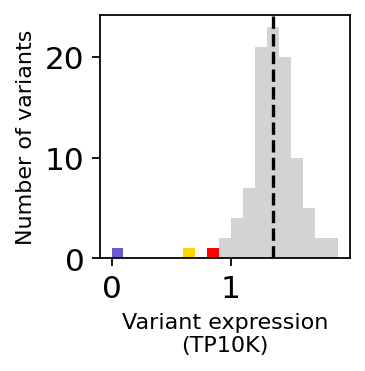

In [31]:
#histogram expression
fig,plots=plt.subplots(1)
fig.set_size_inches(2,2)
bins=[x/10 for x in range(20)]
plots.hist(anno.loc[sorted_variants,'variant_expression'],color='lightgray',
          bins=bins)
plots.axvline(x=anno.loc['WT','variant_expression'],
             color='black',linestyle='--')
for v in ['Q61L','Q61K']:
    plots.hist(anno.loc[v,
        'variant_expression'],color=anno.loc[v,'cluster_color'],bins=bins)
plots.hist(anno.loc['unassigned',
        'variant_expression'],color='slateblue',bins=bins)
plots.grid(False)
plots.set_xlabel('Variant expression\n(TP10K)',fontsize=10)
plots.set_ylabel('Number of variants',fontsize=10)

plt.savefig(FIGS+'/'+PROTEIN+'.expr_hist.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.expr_hist.png',bbox_inches = "tight")

In [25]:
anno.to_csv(ANNO+'/'+PROTEIN+'.anno.withresults.csv',sep='\t')

Starting point
===

In [3]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [9]:
FDR=0.01
#original anno
ANNO=DATA+'/'+PROTEIN+'/anno'
anno=pd.read_csv(ANNO+'/'+PROTEIN+'.anno.withresults.csv',sep='\t',index_col=0)


#get the threshold
def get_threshold_at_FDR(fdr_data,method,FDR=0.1,higher=True):
    fdr_passed=fdr_data.loc[fdr_data['FDR.'+method]<=FDR,:]
    if higher:
        fdr_passed=fdr_passed.sort_values(by=method,ascending=True)
    else:
        fdr_passed=fdr_passed.sort_values(by=method,ascending=False)
    score_thresh_value=float(list(fdr_passed[method])[0])
    return(score_thresh_value)

score='HotellingT2'
score_thresh_value=get_threshold_at_FDR(anno,score,FDR=0.01,higher=True)
print(score_thresh_value)

77.66342602192381


In [10]:
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants=list(sorted_variants_df[0])
print(sorted_variants)

['M111L', 'T127T', 'V112I', 'R149K', 'S17S', 'T74T', 'I163S', 'G75A', 'K147N', 'G77A', 'K88K', 'WT', 'A155G', 'Y166H', 'K176Q', 'T144T', 'C118S', 'T158T', 'A130V', 'D30D', 'K179R', 'S136N', 'T158A', 'T20T', 'D173D', 'V8V', 'A66A', 'M170L', 'K169K', 'T50T', 'R135T', 'F141L', 'R164Q', 'P110S', 'K178K', 'L159S', 'L79I', 'Q25H', 'K147T', 'E63K', 'V14I', 'T50I', 'T50P', 'E31K', 'Q99E', 'R41K', 'T20R', 'Q22H', 'C185Y', 'T20M', 'T144P', 'L52F', 'T74A', 'D57N', 'unassigned', 'N26Y', 'D33E', 'L19F', 'Q61K', 'P34L', 'K5E', 'P34R', 'G60D', 'Q61P', 'G60S', 'G60V', 'R68S', 'I36M', 'T58I', 'Q22K', 'K117R', 'A59T', 'AG59GV', 'D119G', 'G12Y', 'G12F', 'V14L', 'A59E', 'G12S', 'G12A', 'A59G', 'A146V', 'G13C', 'G12C', 'A146P', 'A146T', 'G12V', 'AG11TD', 'G12D', 'G12I', 'G12R', 'Q61A', 'Q61H', 'Q61R', 'Q61L', 'G13E', 'K117N', 'G13V', 'G13R']


In [8]:
import copy
def get_corr_mat(df,axis=0,corr_type='spearman'):
    
    from scipy.stats import spearmanr
    from scipy.stats import pearsonr
    
    if axis==0: #do it for rows
        df_here=np.array(copy.deepcopy(df))
    if axis==1:
        df_here=np.array(copy.deepcopy(df.T))
        
    corr_mat=np.zeros((df_here.shape[0],df_here.shape[0]))
    for i in range(df_here.shape[0]):
        #if i%10==0:
         #   display_progress(i,df_here.shape[0])
        for j in range(i,df_here.shape[0]):
            a=df_here[i,:]
            b=df_here[j,:]
            if np.std(a)==0 or np.std(b)==0:
                if corr_type in ['pearson','spearman']:
                    continue
            if corr_type=='pearson':
                val=pearsonr(a,b)[0]
            if corr_type=='spearman':
                val=spearmanr(a,b)[0]
            if corr_type=='diff':
                val=np.mean(np.abs(a-b))
            corr_mat[i,j]=val
            corr_mat[j,i]=val
    if axis==0: #do it for rows
        corr_mat=pd.DataFrame(corr_mat,index=df.index,columns=df.index)
    if axis==1: #do it for rows
        corr_mat=pd.DataFrame(corr_mat,index=df.columns,columns=df.columns)
    return(corr_mat)

sc_bulk=adata.uns['bulk.guide.compact']
corr_mat=get_corr_mat(sc_bulk,axis=0,corr_type='spearman')

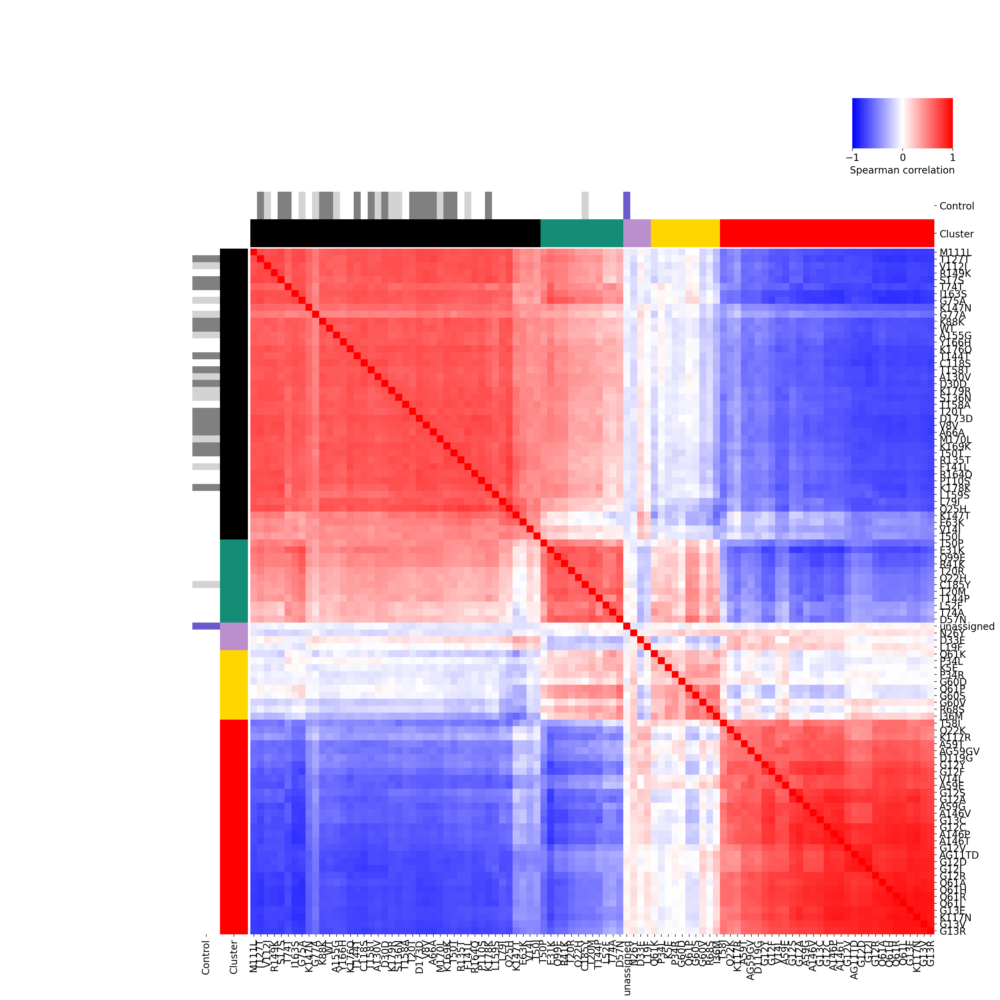

In [30]:
x=1
sns.clustermap(corr_mat.loc[sorted_variants,sorted_variants],
               cmap='bwr',vmin=-x,vmax=x,
               col_cluster=False,row_cluster=False,
              figsize=(20,20),xticklabels=True,yticklabels=True,
               cbar_pos=(0.85, 0.85, 0.1, 0.05),
                 cbar_kws={'orientation':'horizontal',
                "label": "Spearman correlation",
                'ticks':[-x,0,x]},
              row_colors=anno.loc[:,['Control','Cluster']],
              col_colors=anno.loc[:,['Control','Cluster']])

plt.savefig(FIGS+'/'+PROTEIN+'.corrMat.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.corrMat.png',bbox_inches = "tight")

Effect size
==

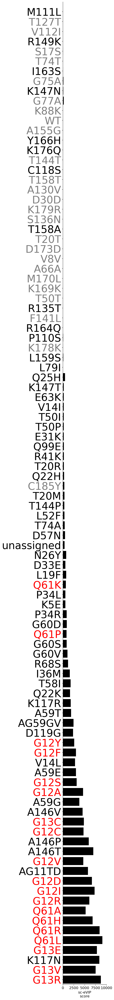

In [163]:
colors=[]
for i in sorted_variants[::-1]:
    if anno.loc[i,score]<score_thresh_value:
        colors_app='lightgray'
    else:
        colors_app='black'
    colors.append(colors_app)

fig,plots = plt.subplots(1,1)
fig.set_size_inches(3,69)
anno[score]=anno[score].astype(float)
plots.barh(sorted_variants[::-1],list(anno.loc[sorted_variants[::-1],score]),
          color=colors)
plots.set_ylim(-0.5,len(sorted_variants[::-1]))
plots.spines['top'].set_visible(False)
plots.spines['right'].set_visible(False)
plots.spines['bottom'].set_visible(True)
plots.spines['left'].set_visible(True)
plots.set_xlabel('sc-eVIP\nscore')
#plots.set_xscale('log')
#plots.set_xlim(1,20000)
plots.set_xlim(0,10000)
plots.set_yticks(sorted_variants[::-1])
plots.set_yticklabels(sorted_variants[::-1])
plots.set_yticklabels(plots.get_yticklabels(), fontsize=40)
plots.grid(False)
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'text_color'],plots.yaxis.get_ticklabels())]

plt.savefig(FIGS+'/'+PROTEIN+'.scevip_score_bar.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.scevip_score_bar.png',bbox_inches = "tight")

In [116]:
#get average scores by group
m_groups=[]
sd_groups=[]
for g_idx in range(len(sorted_groups)):
    g=sorted_groups[g_idx]
    vals=anno.loc[anno['Cluster']==anno_groups.loc[g,'color'],score]
    m_groups.append(np.mean(vals))
    sd_groups.append(np.std(vals))
anno_groups[score+'.mean']=m_groups
anno_groups[score+'.sd']=sd_groups
print(anno_groups)

     group    color  HotellingT2.mean  HotellingT2.sd
N        N    black         70.222793       86.600843
sN      sN  #138D75        302.270700       88.154479
A        A  #BB8FCE        617.983077      154.055027
sN-G  sN-G     gold        913.078778      292.877889
G        G      red       4978.560904     2308.340159


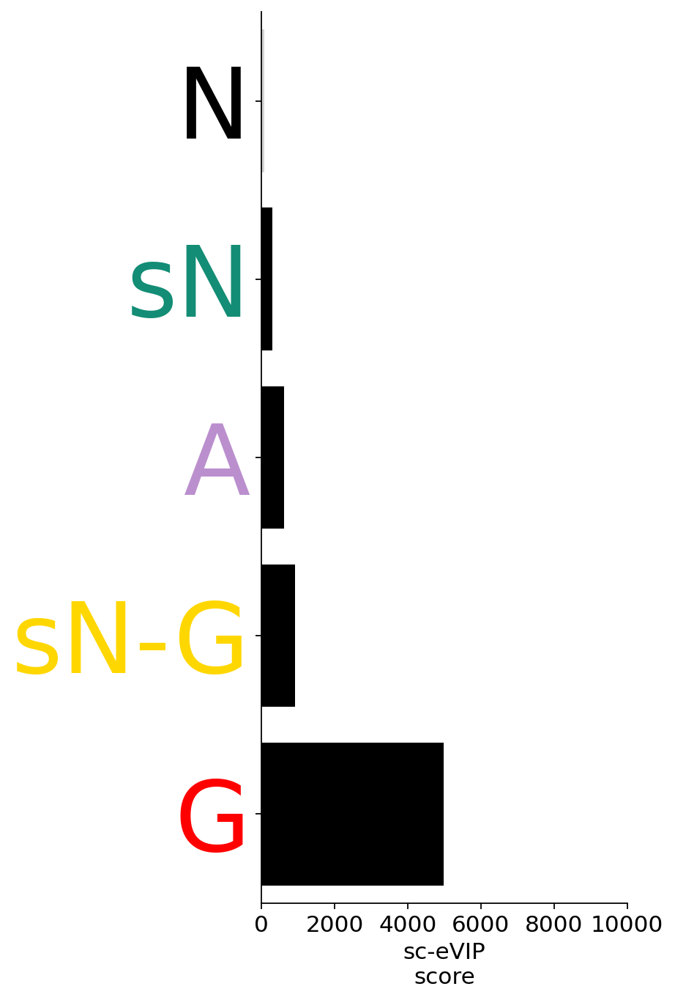

In [165]:
import matplotlib as mpl

colors=[]
for i in sorted_groups[::-1]:
    if anno_groups.loc[i,score+'.mean']<score_thresh_value:
        colors_app='lightgray'
    else:
        colors_app='black'
    colors.append(colors_app)

fig,plots = plt.subplots(1,1)
fig.set_size_inches(4,10)
anno_groups[score+'.mean']=anno_groups[score+'.mean'].astype(float)
plots.barh(sorted_groups[::-1],list(anno_groups.loc[sorted_groups[::-1],score+'.mean']),
          color=colors)
plots.set_ylim(-0.5,len(sorted_groups[::-1])-0.5)
plots.spines['top'].set_visible(False)
plots.spines['right'].set_visible(False)
plots.spines['bottom'].set_visible(True)
plots.spines['left'].set_visible(True)
plots.set_xlabel('sc-eVIP\nscore')
#plots.set_xscale('log')
plots.set_xlim(0,10000)
plots.set_yticks(sorted_groups[::-1])
plots.set_yticklabels(sorted_groups[::-1])
plots.set_yticklabels(plots.get_yticklabels(), fontsize=60)
plots.grid(False)
a=[t.set_color(i) for (i,t) in
 zip(anno_groups.loc[sorted_groups[::-1],'color'],plots.yaxis.get_ticklabels())]
plt.savefig(FIGS+'/'+PROTEIN+'.scevip_score_bar.groups.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.scevip_score_bar.groups.png',bbox_inches = "tight")

In [168]:
anno.columns

Index(['Variant.1', 'Variant.1.1', 'Position', 'From', 'To', 'mutation_type',
       'Count_pancan', 'Count_ExAC', 'control_status', 'control_color',
       'Library_synthesis', 'long_name', 'control_status2', 'text_color',
       'HotellingT2', 'FDR.HotellingT2', 'cluster_color', 'Z-Low-D7',
       'Z-Low-D14', 'Cells/variant', 'variant expression',
       'variant_expression', 'Control', 'Cluster', 'Cluster2'],
      dtype='object')

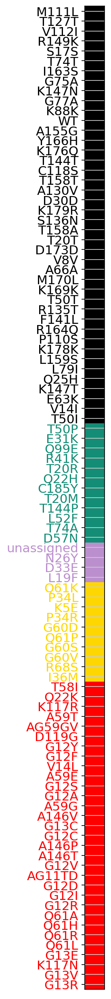

In [170]:
fig,plots = plt.subplots(1,1)
fig.set_size_inches(0.4,20)

plots.barh(anno.loc[sorted_variants[::-1],'Variant.1'],1.1,
         color=anno.loc[sorted_variants[::-1],'Cluster'],
          height=1)
plots.set_xlim(0,1.0)
plots.set_ylim(-0.5,len(sorted_variants)-0.5)
plots.set_xticks([])
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'Cluster'],plots.yaxis.get_ticklabels())]


plt.savefig(FIGS+'/'+PROTEIN+'.clusterColors.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.clusterColors.png',bbox_inches = "tight")




In [171]:
anno_groups

,group,color,HotellingT2.mean,HotellingT2.sd
N,N,black,70.222793,86.600843
sN,sN,#138D75,302.270700,88.154479
A,A,#BB8FCE,617.983077,154.055027
sN-G,sN-G,gold,913.078778,292.877889
G,G,red,4978.560904,2308.340159


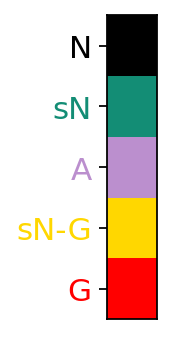

In [175]:
fig,plots = plt.subplots(1,1)
fig.set_size_inches(0.4,2.5)

plots.barh(anno_groups.loc[sorted_groups[::-1],'group'],1.1,
         color=anno_groups.loc[sorted_groups[::-1],'color'],
          height=1)
plots.set_xlim(0,1.0)
plots.set_ylim(-0.5,len(sorted_groups)-0.5)
plots.set_xticks([])
a=[t.set_color(i) for (i,t) in
 zip(anno_groups.loc[sorted_groups[::-1],'color'],plots.yaxis.get_ticklabels())]
plots.grid(False)

plt.savefig(FIGS+'/'+PROTEIN+'.clusterColors.groups.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.clusterColors.groups.png',bbox_inches = "tight")


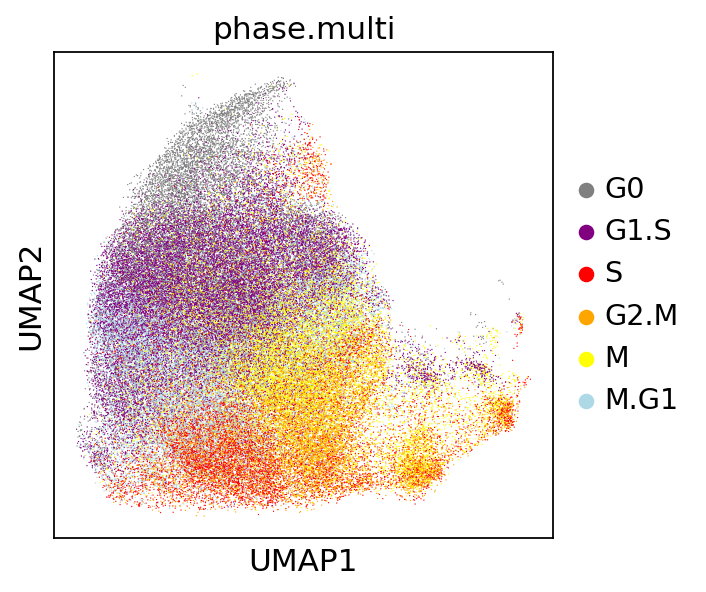

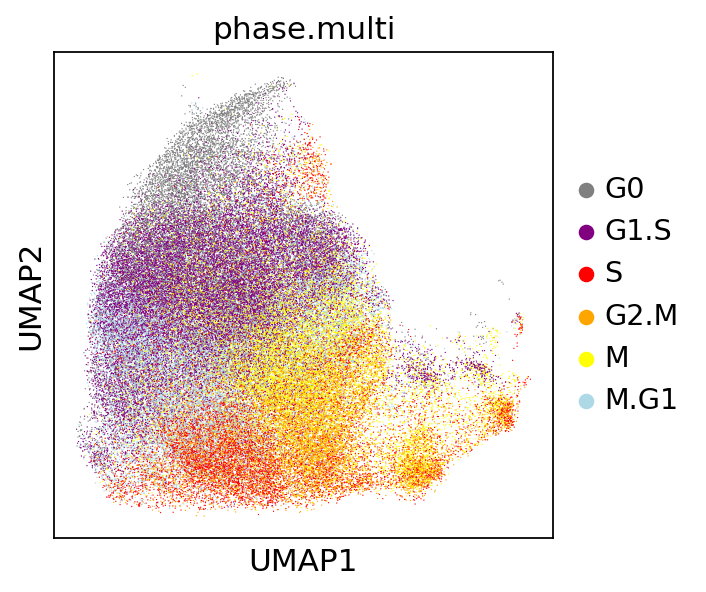

In [178]:
sc.pl.umap(adata,color=['phase.multi'],save=PROTEIN+'cellcycle.png')
sc.pl.umap(adata,color=['phase.multi'],save=PROTEIN+'cellcycle.pdf')

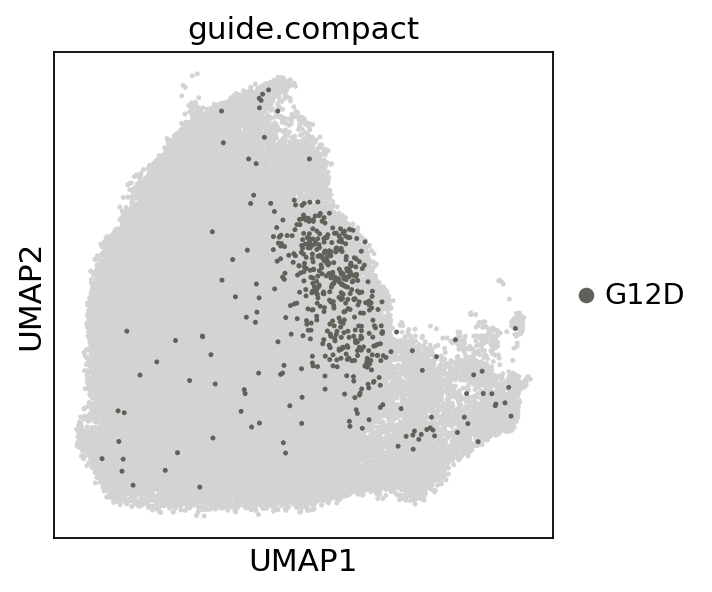

In [180]:
sc.pl.umap(adata,color=['guide.compact'],groups=['G12D'],s=20)

Gene programs
====

In [5]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [37]:
for pro in ['P'+str(x) for x in range(14)]:
    del adata.obs[pro]

In [38]:
adata

AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


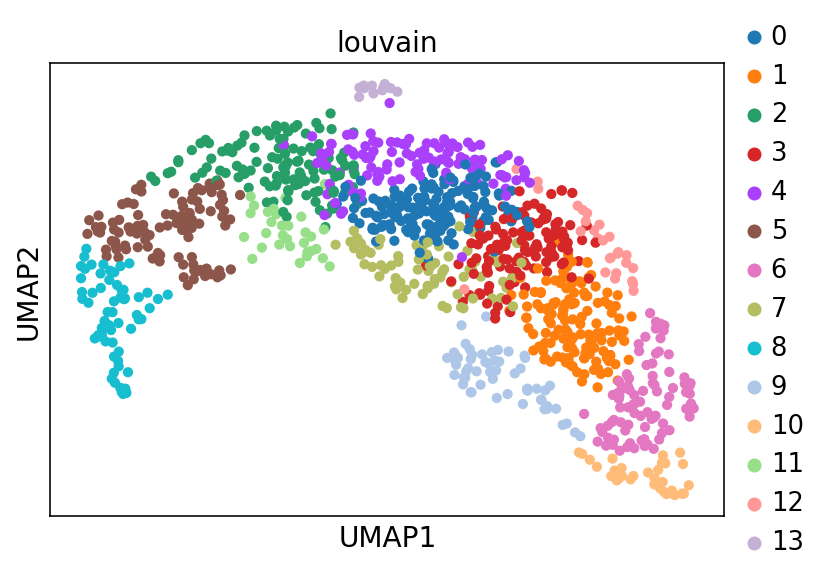

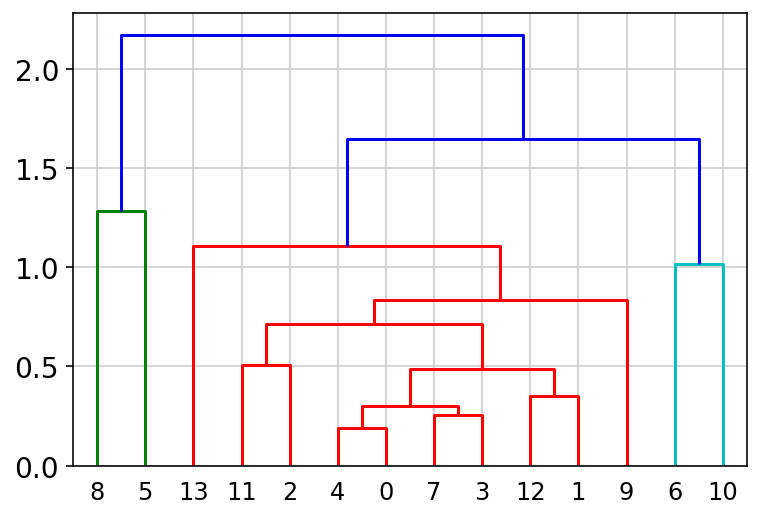

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 9 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


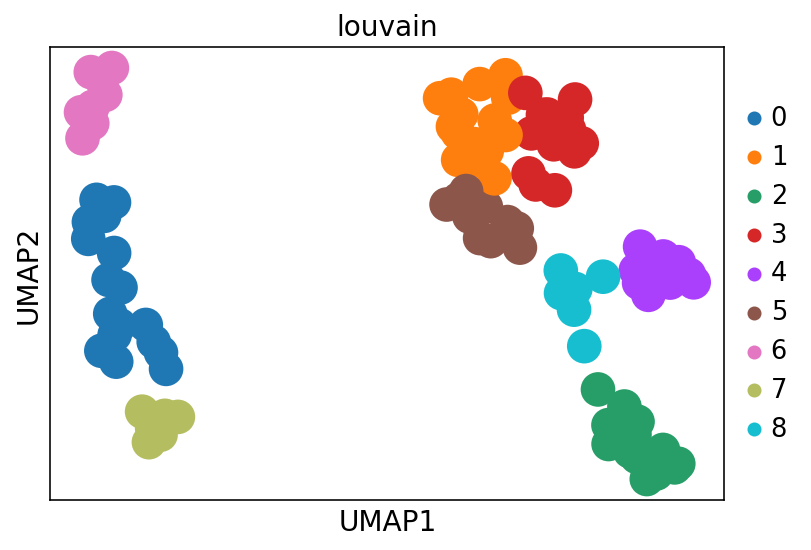

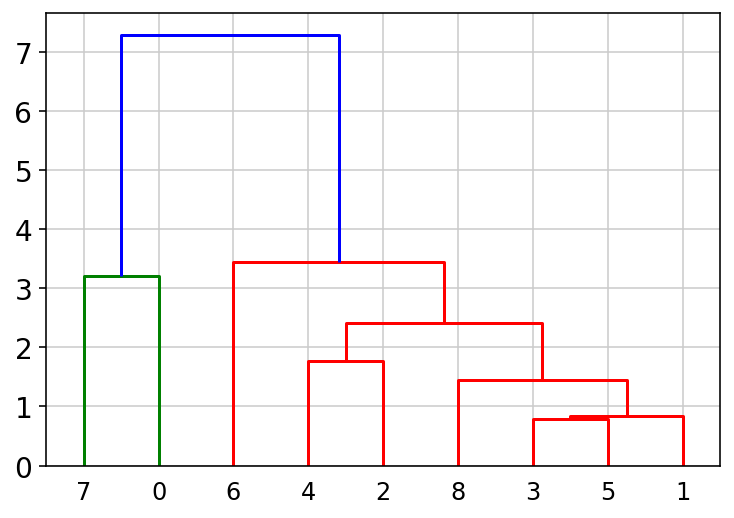

In [39]:
perturb.tl.gene_programs_and_perturbation_modules(adata,cluster_within=False,
                                                  cmap_programs='Paired')

In [40]:
sc_bulk=adata.uns['bulk.guide.compact'].T.loc[adata.var_names,sorted_variants]
sc_bulk['module']=adata.var['bulk.guide.compact.program']
sc_bulk=sc_bulk.sort_values(by='module')
sc_bulk=sc_bulk.drop(columns=['module'])

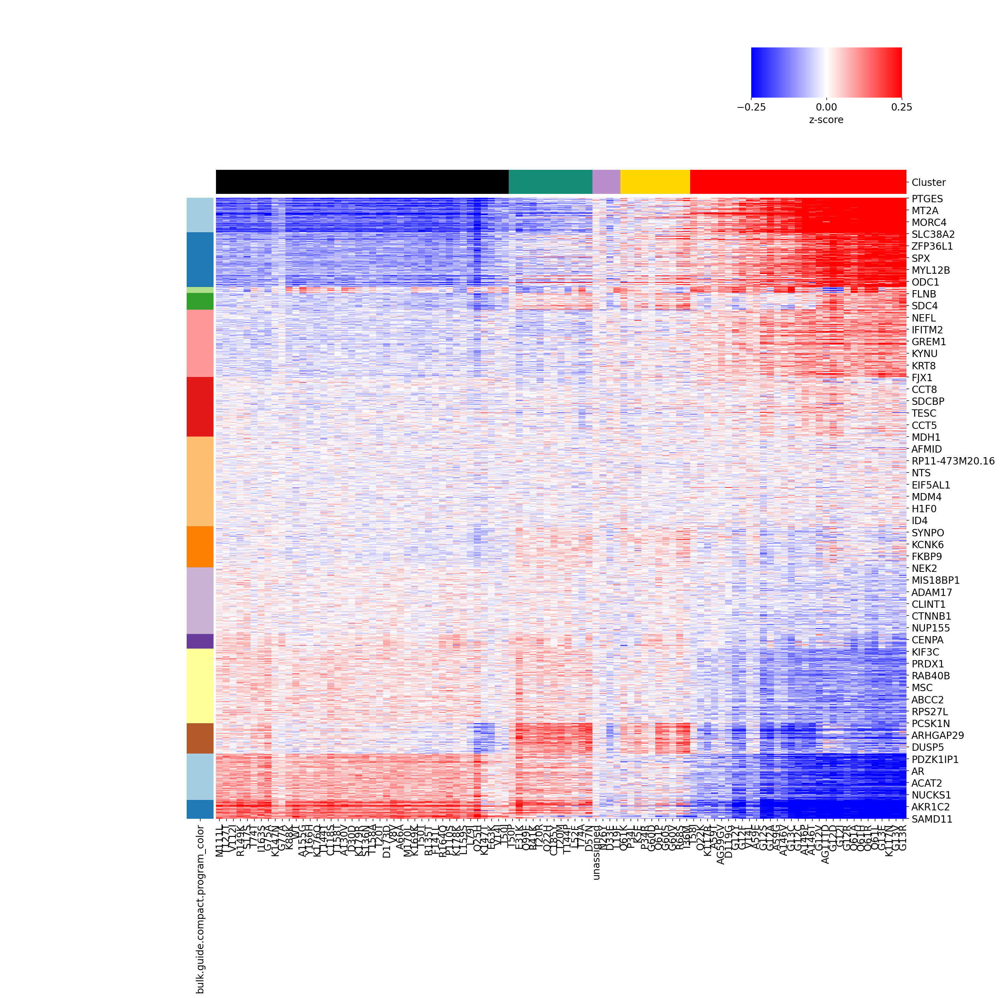

In [41]:
x=0.25
sns.clustermap(sc_bulk,
    #adata.uns['bulk.guide.compact'].T.loc[:,sorted_variants],
               row_cluster=False,col_cluster=False,
               xticklabels=True,
               figsize=(20,20),
               cbar_pos=(0.75, 0.9, 0.15, 0.05),
                 cbar_kws={'orientation':'horizontal',
                "label": "z-score",
                'ticks':[-x,0,x]},
               cmap='bwr',vmin=-x,vmax=x,
              row_colors=adata.var['bulk.guide.compact.program_color'],
               col_colors=anno.loc[:,'Cluster'])

plt.savefig(FIGS+'/'+PROTEIN+'.regMat.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.regMat.png',bbox_inches = "tight")

In [42]:
def score_programs(adata_here,program_name='bulk.guide.compact.program',
                  pref=None,copy=False):
    
    if copy: adata_here = adata_here.copy()
    
    if pref is None:
        pref=program_name
    programs=list(set(adata_here.var[program_name]))
    for pro in programs:
        print('scoring',pro)
        pro_genes=adata_here.var_names[adata_here.var[program_name]==pro]
        adata.obs[pref+str(pro)]=adata[:,pro_genes].X.mean(axis=1)
        
    if copy:
        return(adata_here)
    
score_programs(adata,pref='P')

scoring 0
scoring 1
scoring 2
scoring 3
scoring 4
scoring 5
scoring 6
scoring 7
scoring 8
scoring 9
scoring 10
scoring 11
scoring 12
scoring 13


In [43]:
adata

AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [44]:
adata.write(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad')

... storing 'bulk.guide.compact.program_color' as categorical


Starting point
===

In [12]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [25]:
cls2=[]
for i in range(adata.n_obs):
    m=adata.obs['guide.compact'][i]
    if m=='unassigned':
        cl='slateblue'
    else:
        cl=adata.obs['Cluster'][i]
    cls2.append(cl)
adata.obs['cluster_color2']=cls2

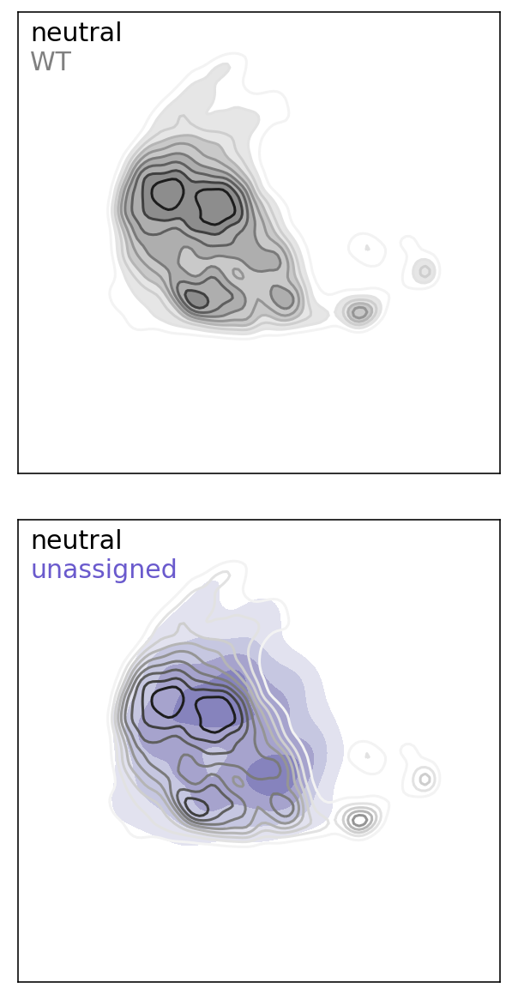

In [26]:
#KRAS UMAPs
#sc-evip plots
def sc_eVIP_plot(adata_subset,variant,ref1='uninfected',ref2='WT',variable_for_groups='mut.std',
                subsample_references=True,variant_color='Purples',variant_color2='blue',variant_label=''):
    
    coords=pd.DataFrame({'umap1':adata_subset.obsm['X_umap'][:,0],
                    'umap2':adata_subset.obsm['X_umap'][:,1],
                    'group':adata_subset.obs[variable_for_groups]})
    coords.index=adata_subset.obs_names
    fig, plots = plt.subplots(2,1)
    fig.set_size_inches(5,10)
    title_text=''
    le=5
    a=1
    maxi=0.025
    
    import matplotlib.gridspec as gridspec
    gs1 = gridspec.GridSpec(2,1)
    gs1.update(wspace=0.0, hspace=0.0) # set the spacing between axes. 
    fig.subplots_adjust(wspace=0.0, hspace=0.1)
        
    if subsample_references:
        cells_variant=adata_subset.obs_names[adata_subset.obs[variable_for_groups]==variant]
        cells1=adata_subset.obs_names[adata_subset.obs[variable_for_groups]==ref1]
        num_cells1=len(cells1)
        cells2=adata_subset.obs_names[adata_subset.obs[variable_for_groups]==ref2]
        num_cells2=len(cells2)
        if num_cells1<num_cells2:
            cells2=cells2[:num_cells1]
        if num_cells1>num_cells2:
            cells1=cells1[:num_cells2]
        print(len(cells1),len(cells2),len(cells_variant))
        cells_keep=list(set(cells_variant).union(set(cells1).union(set(cells2))))
        coords=coords.loc[cells_keep,:]
    

    group=ref1
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap="Purples", shade=True, shade_lowest=False,alpha=a,n_levels=le,
                    ax=plots[1],vmax=0.03)#,vmax=maxi)
    group=variant
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap=variant_color, shade=False, shade_lowest=False,alpha=a,n_levels=le*2,ax=plots[1])

    group=ref2
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap='Greys', shade=True, shade_lowest=False,alpha=a/2,n_levels=le,
                    ax=plots[0])#,vmax=maxi)
    group=variant
    ax = sns.kdeplot(coords.loc[coords['group']==group,'umap1'], coords.loc[coords['group']==group,'umap2'],
                     cmap=variant_color, shade=False, shade_lowest=False,alpha=a,n_levels=le*2,ax=plots[0])


    x=10
    xlim1,xlim2,ylim1,ylim2=-x,x,-x,x
    plots[1].set_xlim(xlim1,xlim2)
    plots[1].set_ylim(ylim1,ylim2)
    plots[0].set_xlim(xlim1,xlim2)
    plots[0].set_ylim(ylim1,ylim2)
    plots[1].grid(False)
    plots[0].grid(False)
    plots[1].set_xticks([])
    plots[1].set_yticks([])
    plots[0].set_xticks([])
    plots[0].set_yticks([])
    plots[1].set_xlabel('')
    plots[1].set_ylabel('')
    plots[0].set_xlabel('')
    plots[0].set_ylabel('')
    for idx in range(2):
        plots[idx].text(xlim1+0.5,ylim2-ylim2/8,variant_label,color=variant_color2,fontsize=15)
        if idx==1:
            plots[idx].text(xlim1+0.5,ylim2-2*ylim2/8,'unassigned',color='slateblue',fontsize=15)
        else:
            plots[idx].text(xlim1+0.5,ylim2-2*ylim2/8,'WT',color='gray',fontsize=15)

sc_eVIP_plot(adata,'black',ref1='slateblue',ref2='black',variant_color='Greys',variant_color2='black',
             variant_label='neutral',variable_for_groups='cluster_color2',subsample_references=False)
plt.savefig(FIGS+'/'+PROTEIN+'.umap_neutral.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_neutral.png',bbox_inches = "tight")

In [52]:
set(adata.obs['cluster_color2'])

{'#138D75', '#BB8FCE', 'black', 'gold', 'nan', 'red', 'slateblue'}

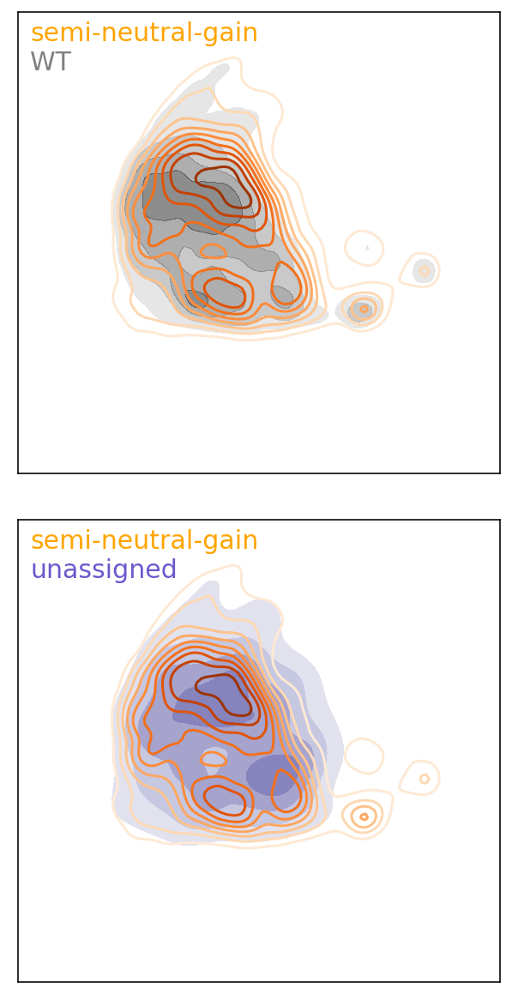

In [27]:
sc_eVIP_plot(adata,'gold',ref1='slateblue',ref2='black',variant_color='Oranges',variant_color2='orange',
             variant_label='semi-neutral-gain',variable_for_groups='cluster_color2',subsample_references=False)
plt.savefig(FIGS+'/'+PROTEIN+'.umap_semiwtgain.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_semiwtgain.png',bbox_inches = "tight")

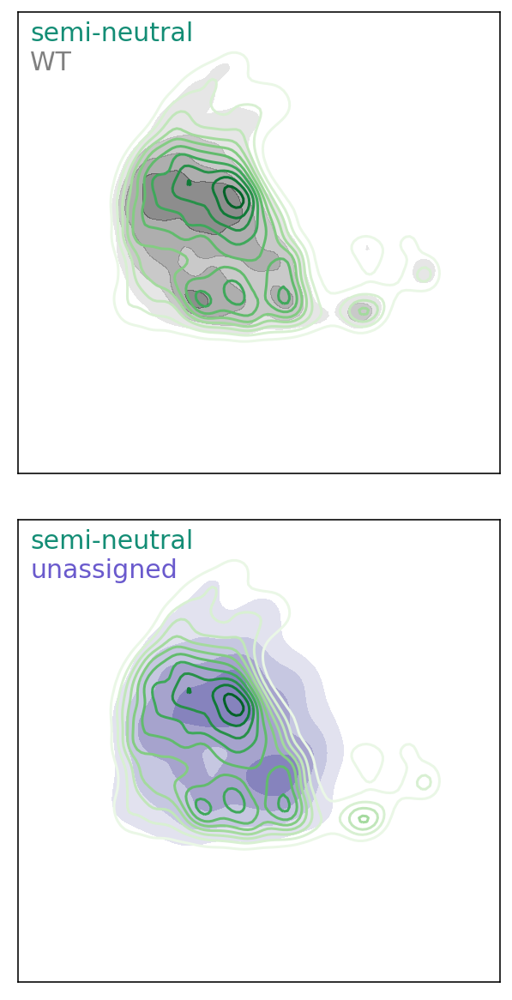

In [28]:
sc_eVIP_plot(adata,'#138D75',ref1='slateblue',ref2='black',variant_color='Greens',variant_color2='#138D75',
             variant_label='semi-neutral',variable_for_groups='cluster_color2',subsample_references=False)
plt.savefig(FIGS+'/'+PROTEIN+'.umap_semiwt.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_semiwt.png',bbox_inches = "tight")

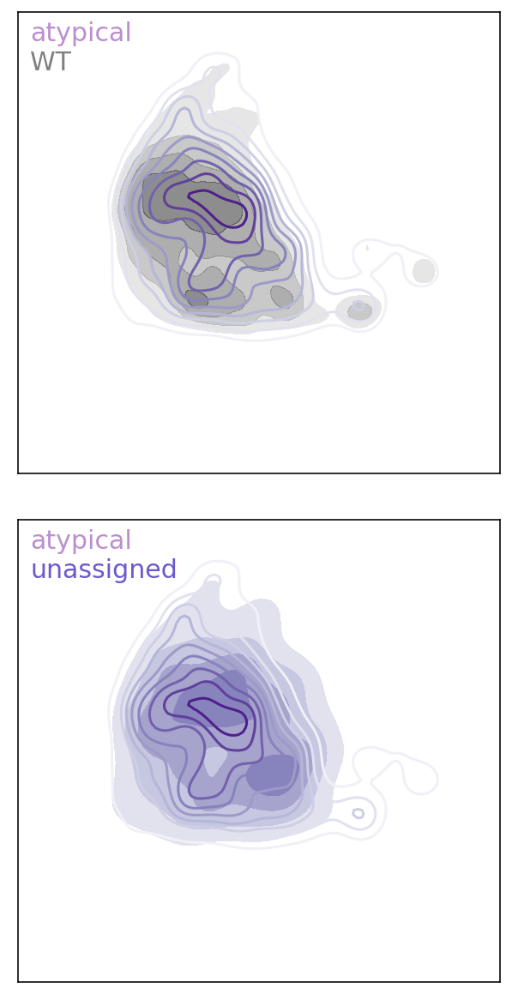

In [29]:
sc_eVIP_plot(adata,'#BB8FCE',ref1='slateblue',ref2='black',variant_color='Purples',variant_color2='#BB8FCE',
             variant_label='atypical',variable_for_groups='cluster_color2',subsample_references=False)
plt.savefig(FIGS+'/'+PROTEIN+'.umap_atypical.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_atypical.png',bbox_inches = "tight")

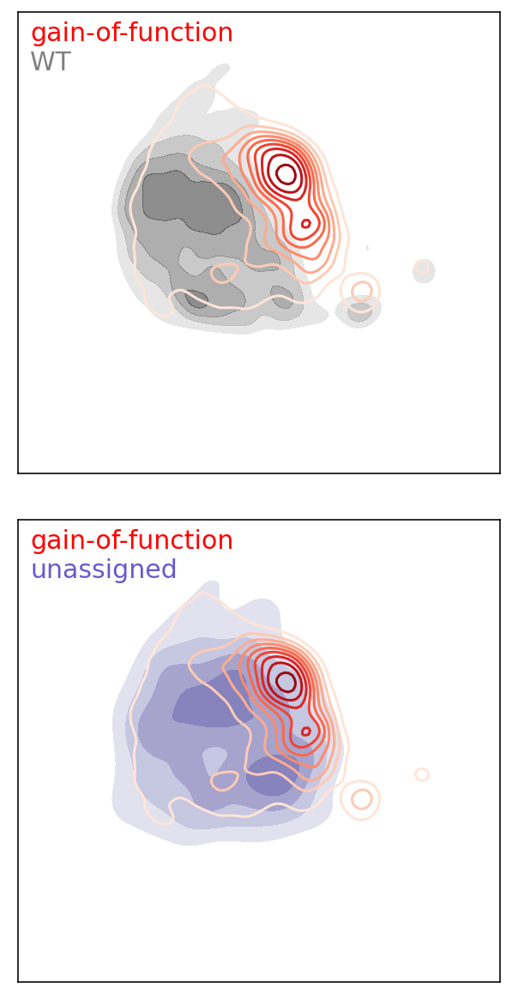

In [30]:
sc_eVIP_plot(adata,'red',ref1='slateblue',ref2='black',variant_color='Reds',variant_color2='red',
             variant_label='gain-of-function',variable_for_groups='cluster_color2',subsample_references=False)
plt.savefig(FIGS+'/'+PROTEIN+'.umap_gain.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_gain.png',bbox_inches = "tight")

644 644 496


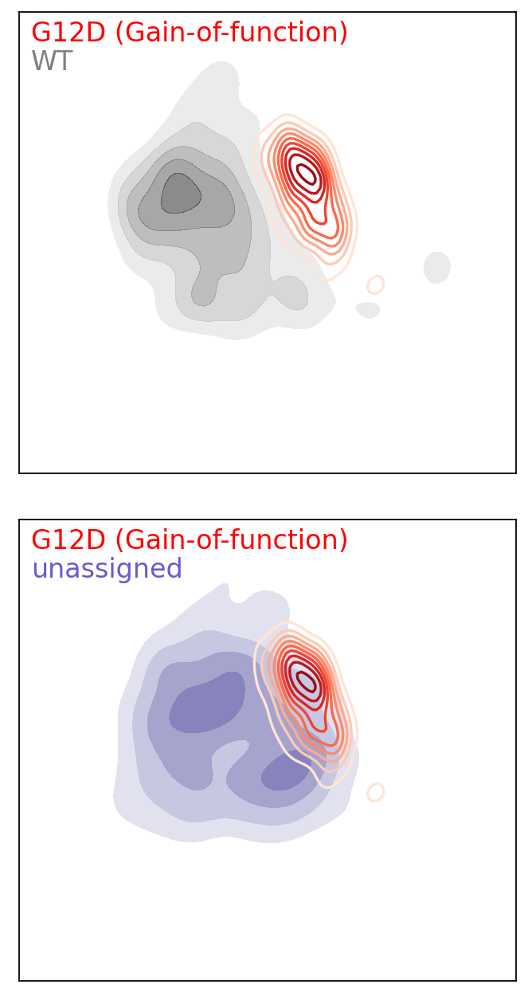

In [182]:
sc_eVIP_plot(adata,'G12D',ref1='unassigned',ref2='WT',variant_color='Reds',variant_color2='red',
             variant_label='G12D (Gain-of-function)',variable_for_groups='guide.compact')
plt.savefig(FIGS+'/'+PROTEIN+'.umap_G12D.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_G12D.png',bbox_inches = "tight")

644 644 1000


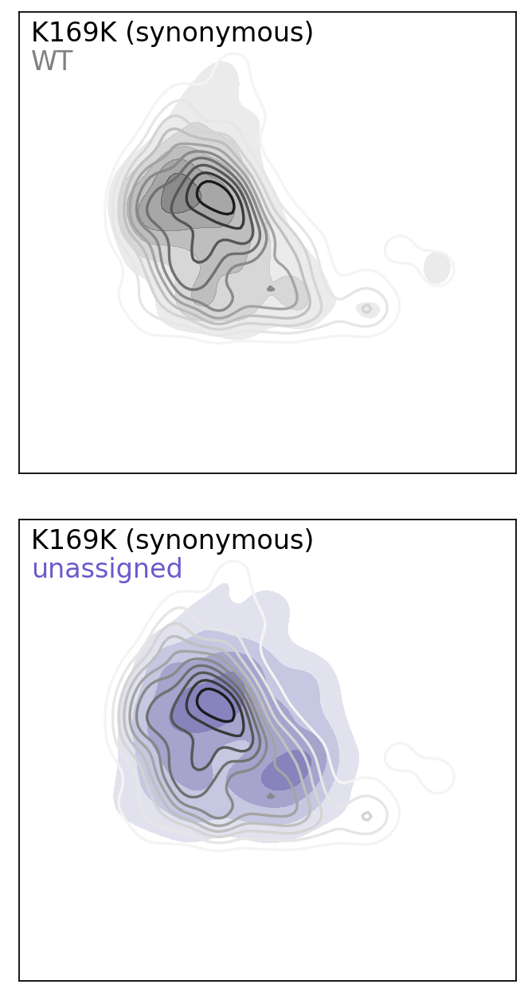

In [184]:
sc_eVIP_plot(adata,'K169K',ref1='unassigned',ref2='WT',variant_color='Greys',variant_color2='black',
             variant_label='K169K (synonymous)',variable_for_groups='guide.compact')
plt.savefig(FIGS+'/'+PROTEIN+'.umap_K169K.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.umap_K169K.png',bbox_inches = "tight")

In [6]:
adata

AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [48]:
adata.obs['Cluster'].cat.reorder_categories(['black','#138D75', '#BB8FCE', 'gold', 'red','nan'], inplace = True)
adata.uns['Cluster_colors']=['black','#138D75', '#BB8FCE', 'gold', 'red','cyan']

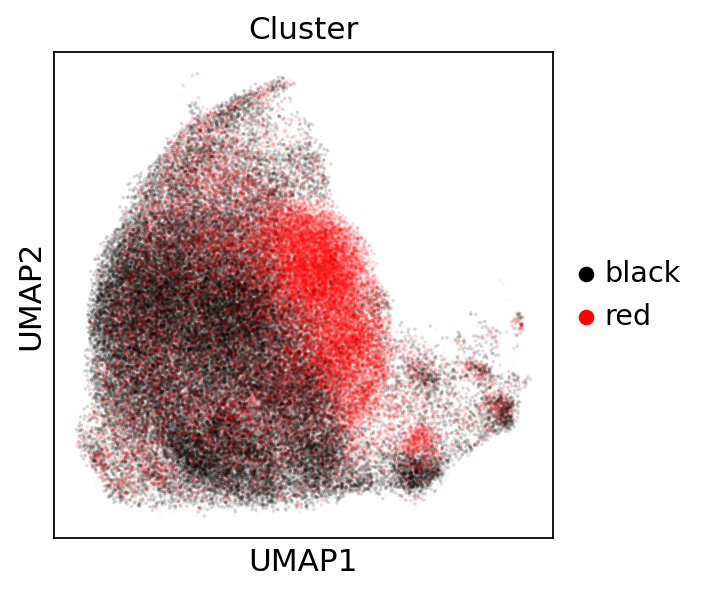

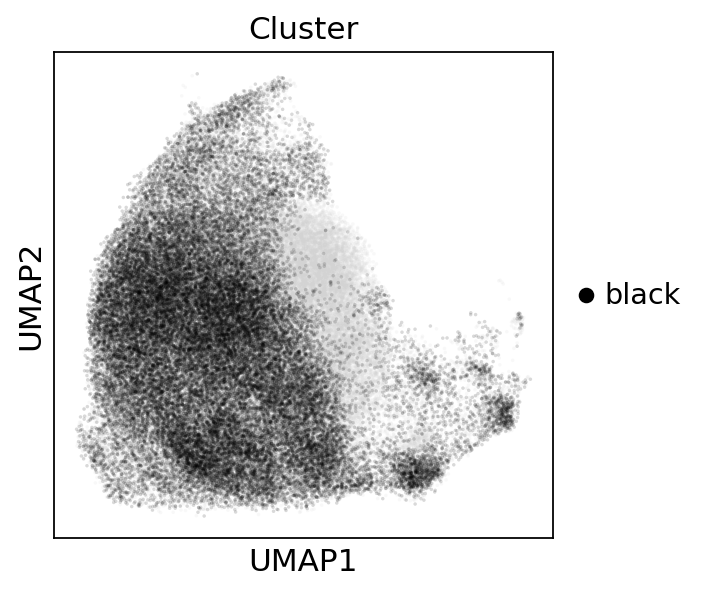

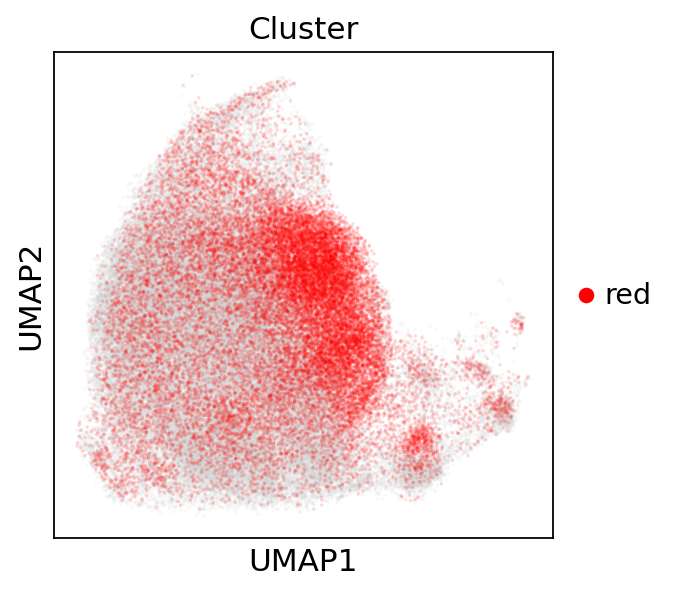

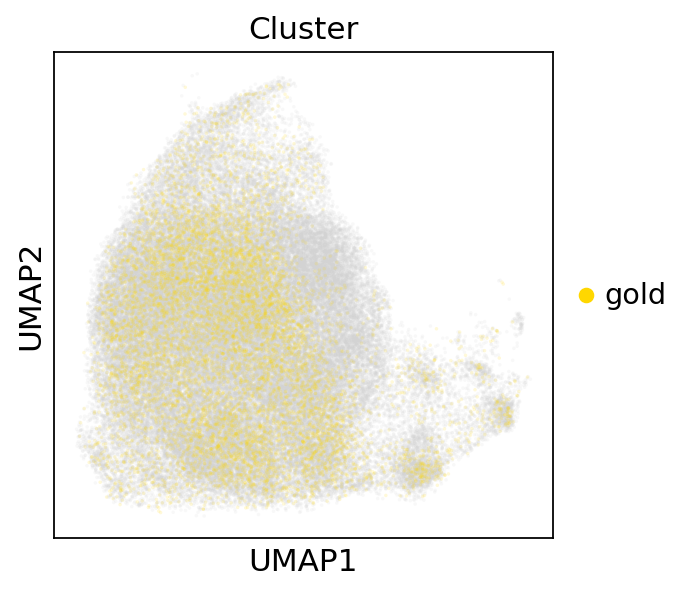

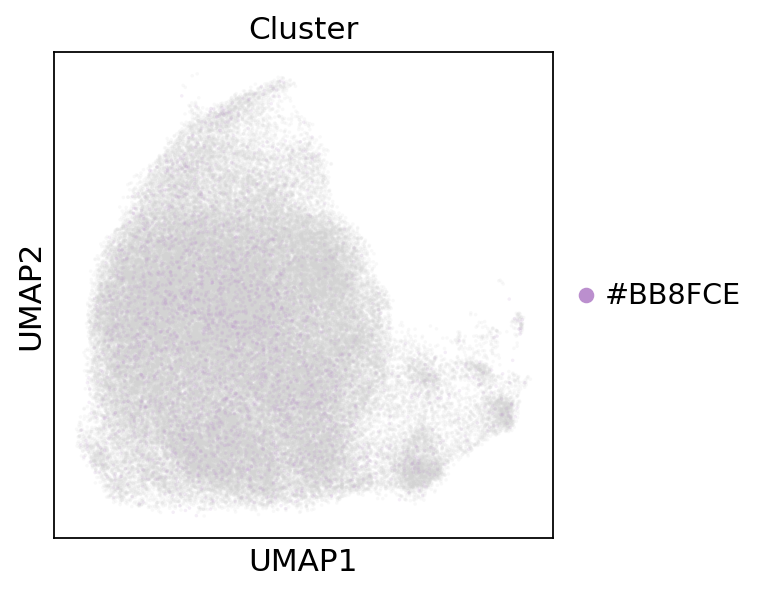

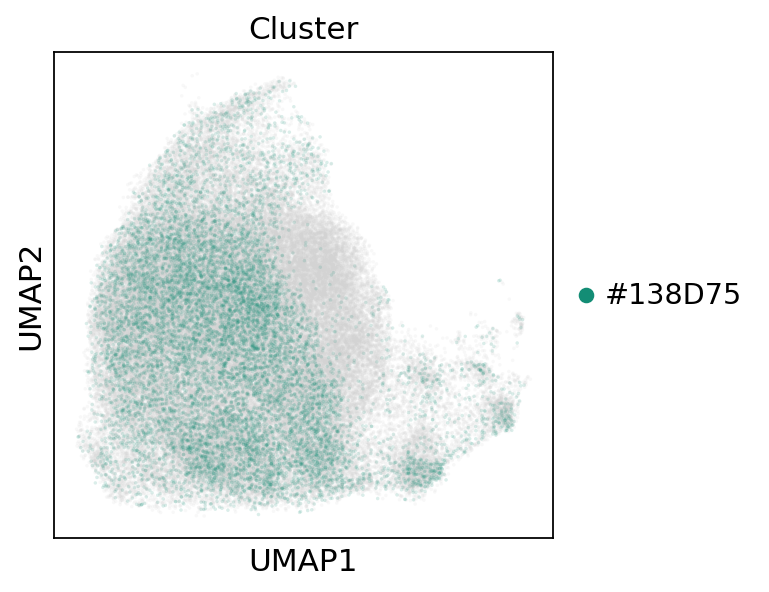

In [45]:
s=10
a=0.15
sc.set_figure_params(figsize=(4,4),dpi=80)
sc.pl.umap(adata,color=['Cluster'],groups=['black','red'],s=s,alpha=a)
sc.pl.umap(adata,color=['Cluster'],groups=['black'],s=s,alpha=a)
sc.pl.umap(adata,color=['Cluster'],groups=['red'],s=s,alpha=a)
sc.pl.umap(adata,color=['Cluster'],groups=['gold'],s=s,alpha=a)
sc.pl.umap(adata,color=['Cluster'],groups=['#BB8FCE'],s=s,alpha=a)
sc.pl.umap(adata,color=['Cluster'],groups=['#138D75'],s=s,alpha=a)

In [38]:
sc.tl.embedding_density(adata, basis='umap', groupby='Cluster')

computing density on 'umap'
--> added
    'umap_density_Cluster', densities (adata.obs)
    'umap_density_Cluster_params', parameter (adata.uns)


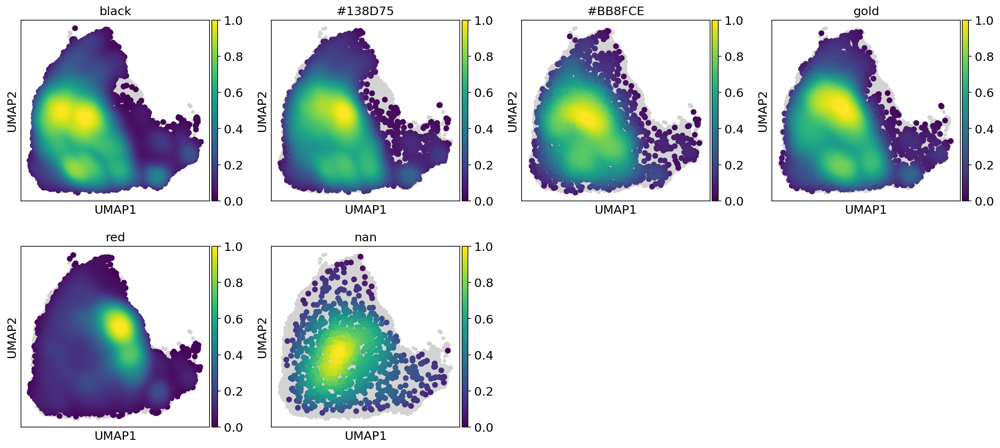

In [43]:
sc.pl.embedding_density(adata,key='umap_density_Cluster',color_map='viridis')

... storing 'cluster_color2' as categorical


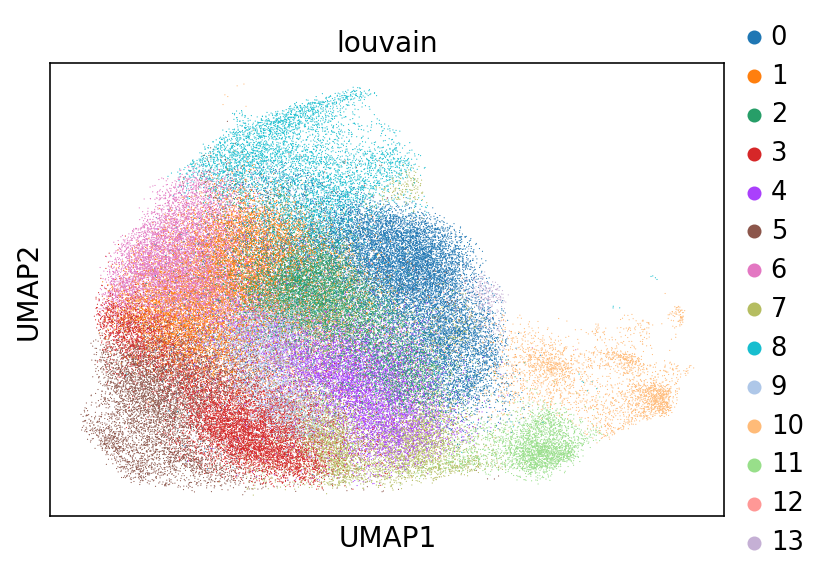

In [49]:
sc.pl.umap(adata,color=['louvain'])

In [50]:
my_programs=['P'+str(x) for x in range(14)]

In [44]:
#dotplots in all their glory
def get_bulk_programs_with_sig(adata_here,score_names,ref='unassigned',
                               variant_col='mut.std',fdr=0.1):
    
    variants=list(set(adata_here.obs[variant_col]))
    programs=score_names
    
    bulk_programs=pd.DataFrame(0,index=variants,columns=programs)
    p=pd.DataFrame(1,index=variants,columns=programs)
    
    #get scores of ref
    ref_scores={}
    for cl in programs:
        print(cl)
        if ref is None:
            ref_values=adata_here.obs[cl]
        else:
            ref_values=adata_here[adata_here.obs[variant_col]==ref,:].obs[cl]
        for variant in variants:
            variant_values=adata_here[adata_here.obs[variant_col]==variant,:].obs[cl]
            from scipy.stats import ks_2samp
            ksp=ks_2samp(ref_values,variant_values)[1]
            diff=np.mean(variant_values)-np.mean(ref_values)
            bulk_programs.loc[variant,cl]=diff
            p.loc[variant,cl]=ksp
    #will need multiple testing on the pvalues
    pval_m=p
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    p=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)

    return(bulk_programs,p)
        


In [52]:
bulk_programs_wt,p_wt=get_bulk_programs_with_sig(adata,my_programs,
                                           ref='WT',variant_col='guide.compact',
                                           fdr=0.1)

P0
P1
P2
P3
P4
P5
P6
P7
P8
P9
P10
P11
P12
P13


In [53]:
bulk_programs,p=get_bulk_programs_with_sig(adata,my_programs,
                                           ref='unassigned',variant_col='guide.compact',
                                           fdr=0.1)

P0
P1
P2
P3
P4
P5
P6
P7
P8
P9
P10
P11
P12
P13


In [54]:
adata.uns['bulk.programs.vs_unassigned.avg']=bulk_programs
adata.uns['bulk.programs.vs_unassigned.p']=p
adata.uns['bulk.programs.vs_WT.avg']=bulk_programs_wt
adata.uns['bulk.programs.vs_WT.p']=p_wt

In [45]:
def get_bulk_programs(adata_here,score_names,
                               variant_col='mut.std',fdr=0.1):
    
    variants=list(set(adata_here.obs[variant_col]))
    programs=score_names
    
    bulk_programs=pd.DataFrame(0,index=variants,columns=programs)
    p=pd.DataFrame(1,index=variants,columns=programs)
    
    #get scores of ref
    ref_scores={}
    for cl in programs:
        print(cl)
        for variant in variants:
            variant_values=adata_here[adata_here.obs[variant_col]==variant,:].obs[cl]
            bulk_programs.loc[variant,cl]=np.mean(variant_values)

    return(bulk_programs)

In [55]:


bulk_programs_values=get_bulk_programs(adata,my_programs,
                                           variant_col='guide.compact',
                                           fdr=0.1)
adata.uns['bulk.programs.avg']=bulk_programs_values

P0
P1
P2
P3
P4
P5
P6
P7
P8
P9
P10
P11
P12
P13


In [56]:
adata.write(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad')

Starting point
==

In [13]:
adata=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.regress_out_vbc.analysis.1000cells.new_format.h5ad',cache=False)
adata

Only considering the two last: ['.new_format', '.h5ad'].
Only considering the two last: ['.new_format', '.h5ad'].


AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [58]:
sorted_variants_df=pd.read_csv(DATA+'/'+PROTEIN+'/clustering/'+PROTEIN+'.corrL1.sorted_variants.csv',header=None)
sorted_variants=list(sorted_variants_df[0])
print(sorted_variants)

['M111L', 'T127T', 'V112I', 'R149K', 'S17S', 'T74T', 'I163S', 'G75A', 'K147N', 'G77A', 'K88K', 'WT', 'A155G', 'Y166H', 'K176Q', 'T144T', 'C118S', 'T158T', 'A130V', 'D30D', 'K179R', 'S136N', 'T158A', 'T20T', 'D173D', 'V8V', 'A66A', 'M170L', 'K169K', 'T50T', 'R135T', 'F141L', 'R164Q', 'P110S', 'K178K', 'L159S', 'L79I', 'Q25H', 'K147T', 'E63K', 'V14I', 'T50I', 'T50P', 'E31K', 'Q99E', 'R41K', 'T20R', 'Q22H', 'C185Y', 'T20M', 'T144P', 'L52F', 'T74A', 'D57N', 'unassigned', 'N26Y', 'D33E', 'L19F', 'Q61K', 'P34L', 'K5E', 'P34R', 'G60D', 'Q61P', 'G60S', 'G60V', 'R68S', 'I36M', 'T58I', 'Q22K', 'K117R', 'A59T', 'AG59GV', 'D119G', 'G12Y', 'G12F', 'V14L', 'A59E', 'G12S', 'G12A', 'A59G', 'A146V', 'G13C', 'G12C', 'A146P', 'A146T', 'G12V', 'AG11TD', 'G12D', 'G12I', 'G12R', 'Q61A', 'Q61H', 'Q61R', 'Q61L', 'G13E', 'K117N', 'G13V', 'G13R']


In [28]:
my_programs=['P'+str(x) for x in range(14)]

In [46]:
def dotplot_programs(bulk_programs,p,myorder,sorted_variants,
                     best_p=1e-5,fdr=0.01,vmin=-0.5,vmax=0.5,w=5,h=25,
                    title='Difference',cbar_percent="5%",widths=[1,1]):
    
    
    mlog_bestp=-np.log10(best_p)
    
    bulk_programs_long=pd.DataFrame(bulk_programs.loc[sorted_variants[::-1],myorder[::-1]].unstack())   
    idx=bulk_programs_long.index.to_frame()
    bulk_programs_long['variants']=idx[1]
    bulk_programs_long['cl']=idx[0]
    
    p_long=pd.DataFrame(p.loc[sorted_variants[::-1],myorder[::-1]].unstack()) 
    idx=p_long.index.to_frame()
    p_long['variants']=idx[1]
    p_long['cl']=idx[0]
    
    
    import matplotlib
    import matplotlib.cm as cm
    norm = matplotlib.colors.Normalize(clip=True,vmin=vmin,vmax=vmax)
    mapper = cm.ScalarMappable(norm=norm, cmap=cm.bwr)
    colors=mapper.to_rgba(bulk_programs_long[0])

    #fig,plots=plt.subplots(1,2)
    #fig.set_size_inches(w,h)
    from matplotlib import gridspec

    fig = plt.figure()
    spec = gridspec.GridSpec(ncols=2, nrows=1,
                     width_ratios=widths)
    fig.set_size_inches(w,h)
    plots = [fig.add_subplot(spec[0]),fig.add_subplot(spec[1])]
    
    mini_size=1
    x_vector=bulk_programs_long['cl']
    y_vector=bulk_programs_long['variants']
    sizes=p_long[0]
    sizes[sizes<best_p]=best_p
    borders=0.5*(sizes<=fdr)*1.0
    sizes=-np.log10(sizes)*100.0/(-np.log10(best_p))
    
    scatter_output=plots[0].scatter(x_vector,y_vector,
                       c=colors,s=sizes,
                       edgecolor='black',
                         linewidth=borders)
    
    plots[0].grid(False)
    plots[0].set_xticks(myorder)
    plots[0].set_xticklabels(myorder)
    plots[0].set_xticklabels(plots[0].get_xticklabels(), rotation=270)
    plots[0].set_ylim(-0.5,len(sorted_variants)-0.5)
    plots[0].set_xlim(-0.5,len(myorder)-0.5)
    
    #sizes
    handles, labels = scatter_output.legend_elements(prop="sizes", alpha=0.6,num=5)
    labels2=[]
    import re
    for i in range(len(labels)):
        i_num=float(re.sub('\$\\\\mathdefault{','',re.sub('}\$','',labels[i])))
        i_num_processed=np.power(10,1.0*i_num*np.log10(best_p)/100.0)
        i_num_processed=i_num/100.0*(-np.log10(best_p))
        labels2.append(i_num_processed)
    min_size=labels2[0]
    max_size=labels2[len(labels2)-1]
    min_handle=handles[0]
    labels_ends=[min_size,max_size]
    handles_ends=[handles[0],handles[len(handles)-1]]
    legend2 = plots[1].legend(handles_ends, labels_ends, loc="upper right", title="P-value\n-log10(p)")
    
    plots[1].grid(False)
    plots[1].set_xticks([])
    plots[1].set_yticks([])
    plots[1].spines['right'].set_visible(False)
    plots[1].spines['left'].set_visible(False)
    plots[1].spines['top'].set_visible(False)
    plots[1].spines['bottom'].set_visible(False)
    
    import matplotlib as mpl
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
    divider = make_axes_locatable(plots[1])
    cax = divider.append_axes("bottom", size=cbar_percent, pad=0.25)
    cb=fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cm.bwr), 
                    cax=cax,orientation='horizontal',
                   cmap=cm.bwr)
    cb.set_label(title)

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


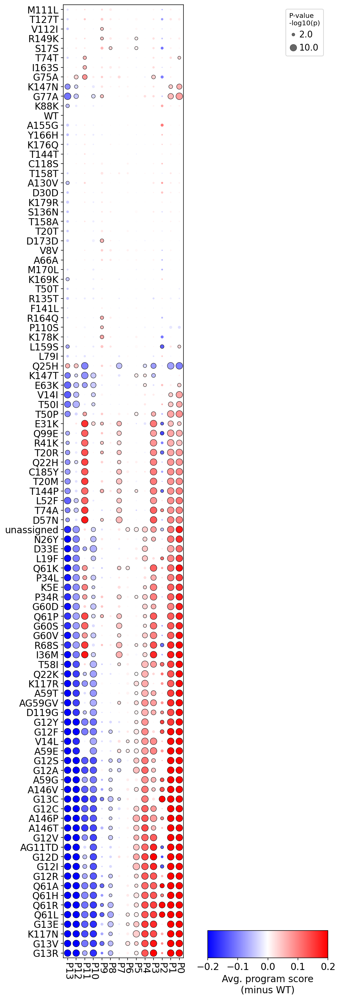

In [30]:
dotplot_programs(adata.uns['bulk.programs.vs_WT.avg'],
                 adata.uns['bulk.programs.vs_WT.p'],
                 myorder=my_programs,
                 sorted_variants=sorted_variants,
                 best_p=1e-10,
                 vmin=-0.2,vmax=0.2,
                title='Avg. program score\n(minus WT)',
                cbar_percent='3%',w=7,h=25)

plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_WT.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_WT.png',bbox_inches = "tight")

In [51]:
for gene in ['MKI67']:
    adata.obs[gene]=adata.raw[:,gene].X.flatten()

AttributeError: flatten not found

In [ ]:
bulk_signatures,p_signatures=get_bulk_programs_with_sig(adata,signatures,
                                           ref='unassigned',variant_col='guide.compact',
                                           fdr=0.1)

In [33]:
anno.columns

Index(['Variant.1', 'Variant.1.1', 'Position', 'From', 'To', 'mutation_type',
       'Count_pancan', 'Count_ExAC', 'control_status', 'control_color',
       'Library_synthesis', 'long_name', 'control_status2', 'text_color',
       'HotellingT2', 'FDR.HotellingT2', 'cluster_color', 'Z-Low-D7',
       'Z-Low-D14', 'Cells/variant', 'variant expression',
       'variant_expression', 'Control', 'Cluster', 'Cluster2'],
      dtype='object')

P0


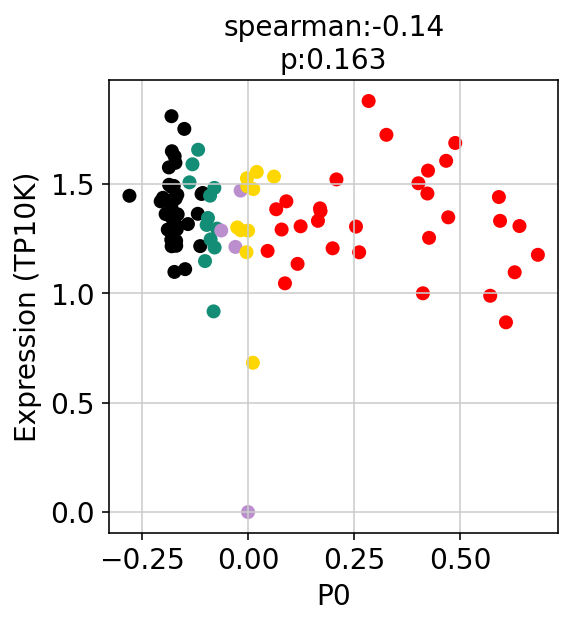

P1


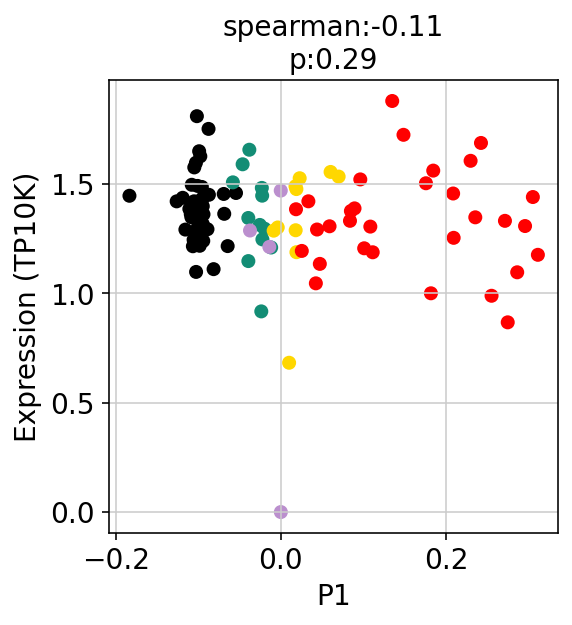

P2


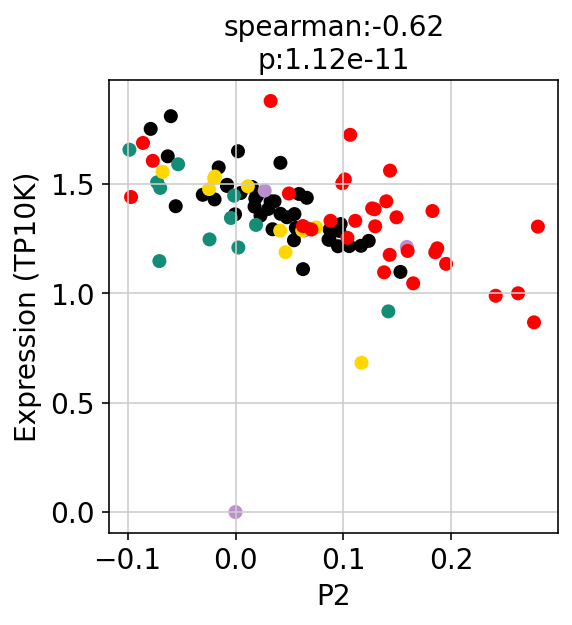

P3


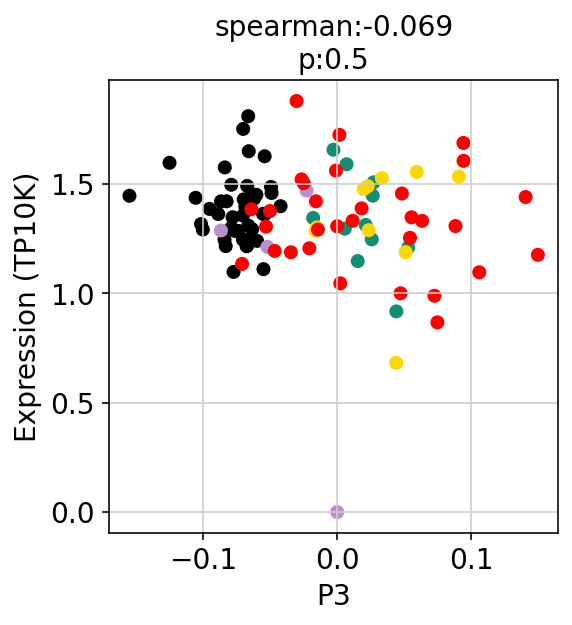

P4


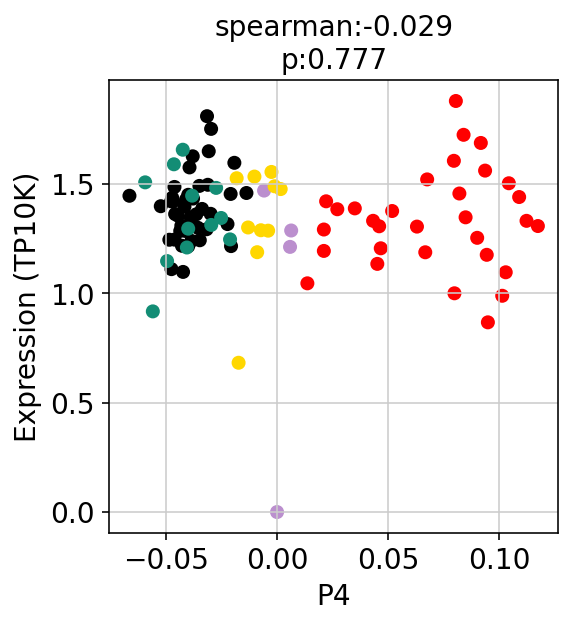

P5


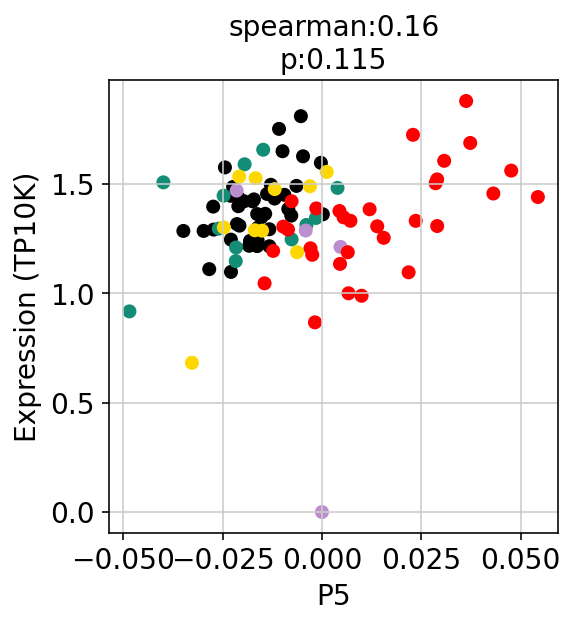

P6


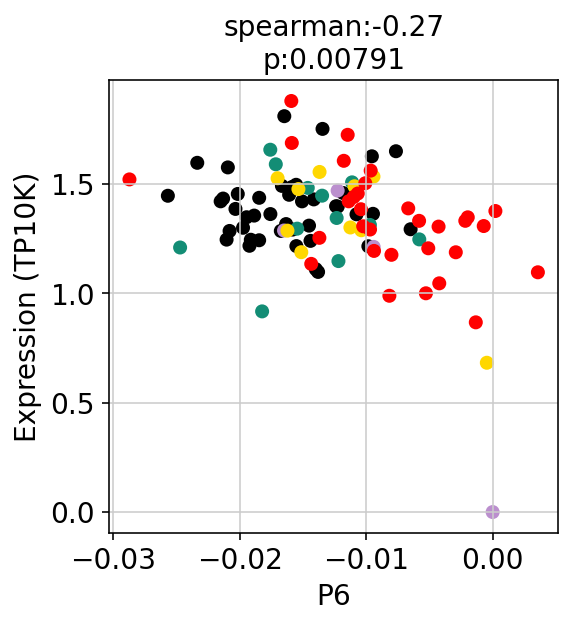

P7


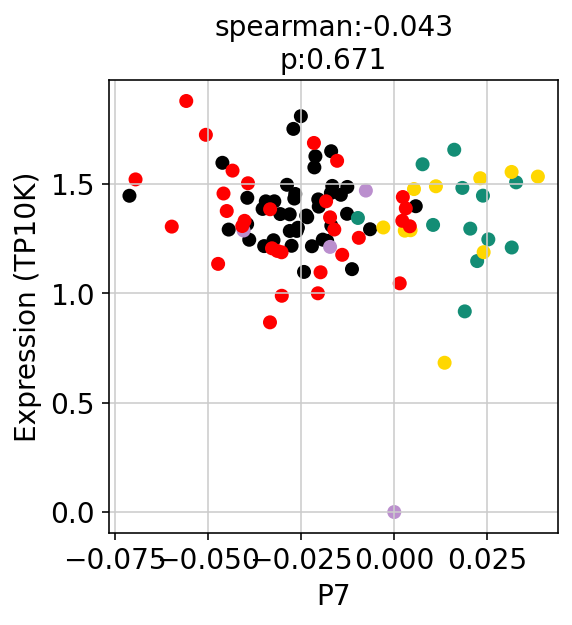

P8


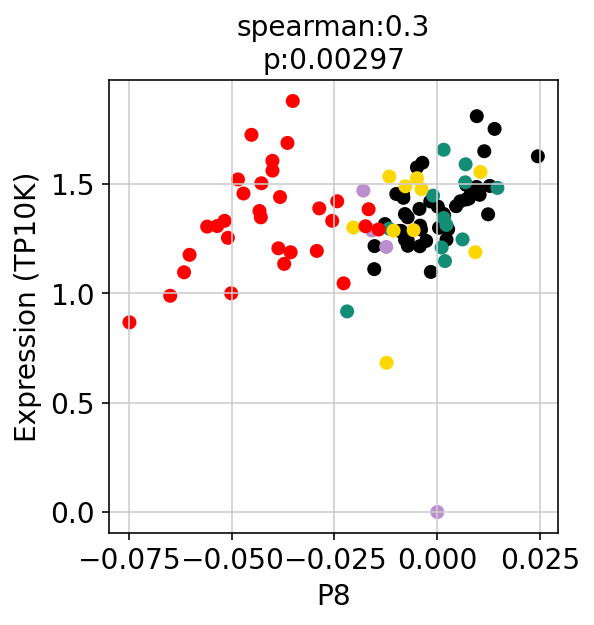

P9


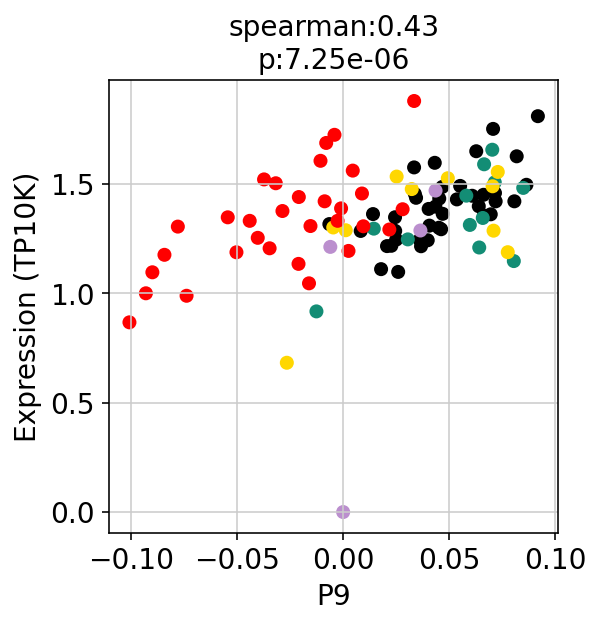

P10


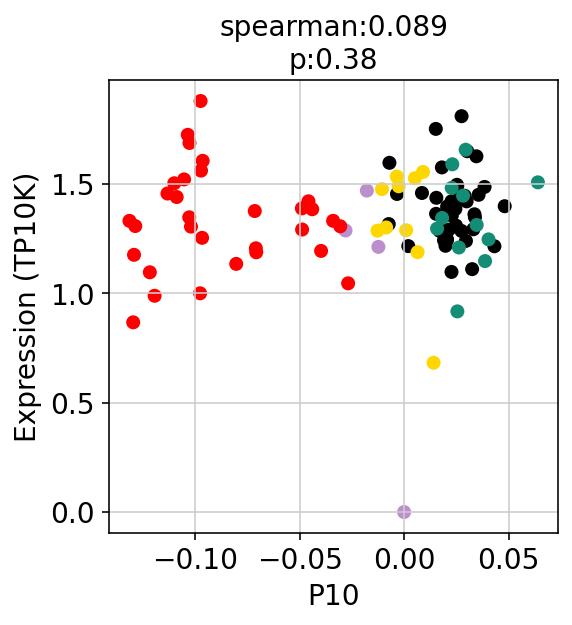

P11


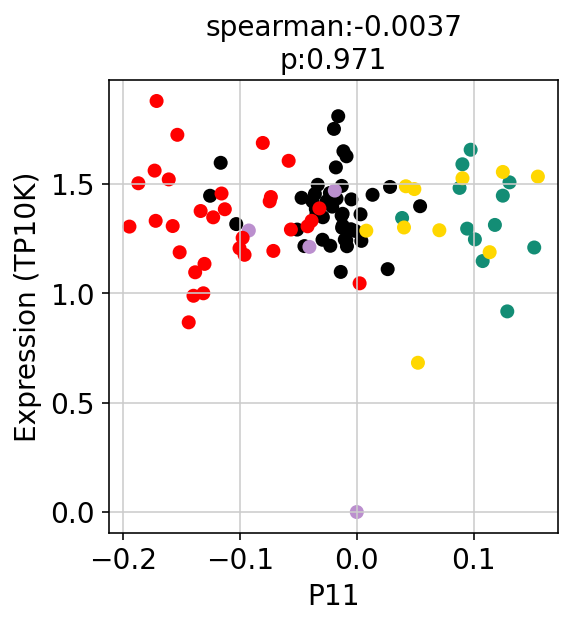

P12


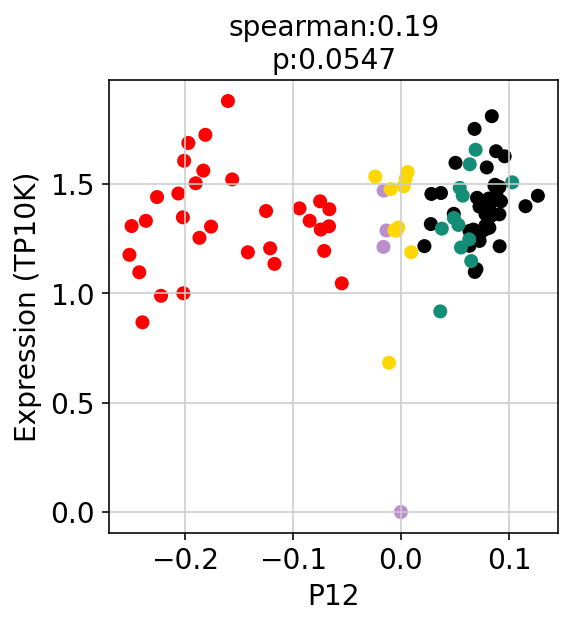

P13


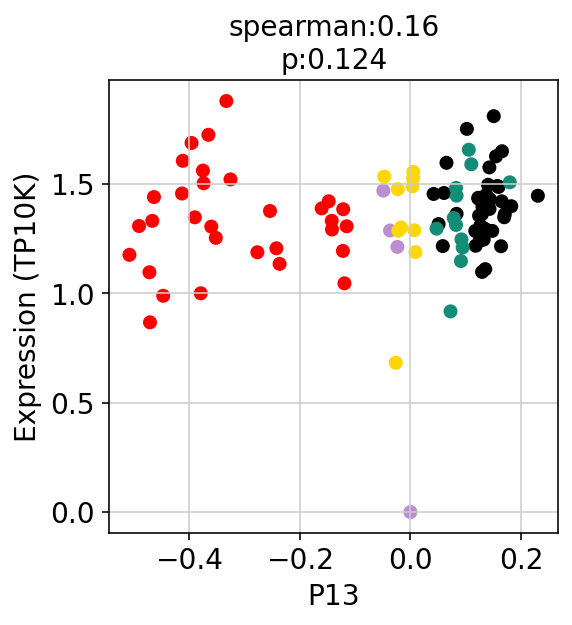

In [37]:
def fun_scatter(x,y,xname='x',yname='y',width=4,height=4,corrtype='spearman',
                xlim=None,ylim=None,
                **kwargs):
    from scipy.stats import spearmanr, pearsonr
    if corrtype=='spearman':
        corr=spearmanr(x,y,nan_policy='omit')
    if corrtype=='pearson':
        corr=pearsonr(x,y)
    c,p="%.2g" % corr[0],"%.3g" % corr[1]
    fig,plots=plt.subplots(1)
    fig.set_size_inches(width,height)
    plots.scatter(x,y,**kwargs)
    plots.set_xlabel(xname)
    plots.set_ylabel(yname)
    if xlim!=None:
        plots.set_xlim(xlim)
    if ylim!=None:
        plots.set_ylim(ylim)
    plots.set_title(corrtype+':'+str(c)+'\n'+'p:'+str(p))

for pro in my_programs:
    print(pro)
    fun_scatter(adata.uns['bulk.programs.vs_unassigned.avg'].loc[sorted_variants,pro],
               anno.loc[sorted_variants,'variant_expression'],
               color=anno.loc[sorted_variants,'Cluster'])
    plt.xlabel(pro)
    plt.ylabel('Expression (TP10K)')
    plt.show()
    
    

P0


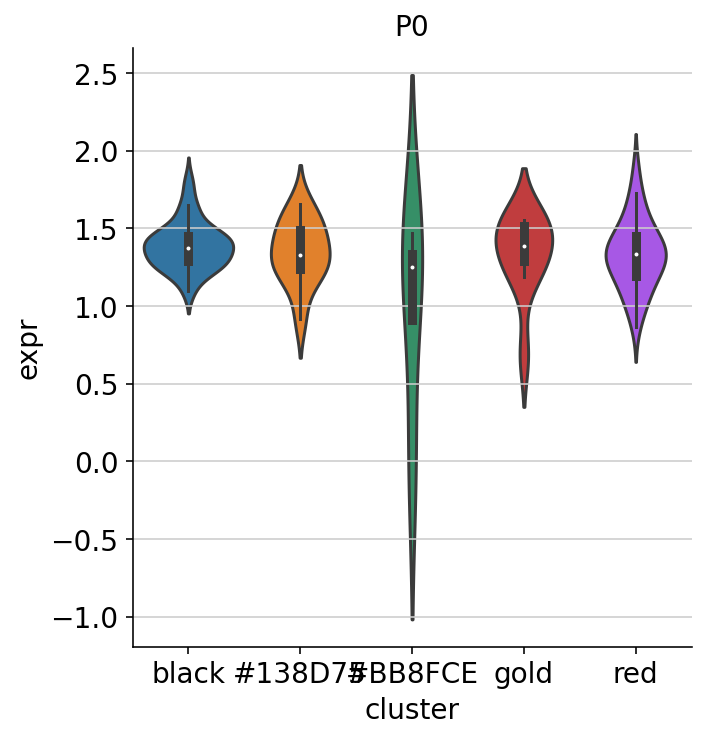

P1


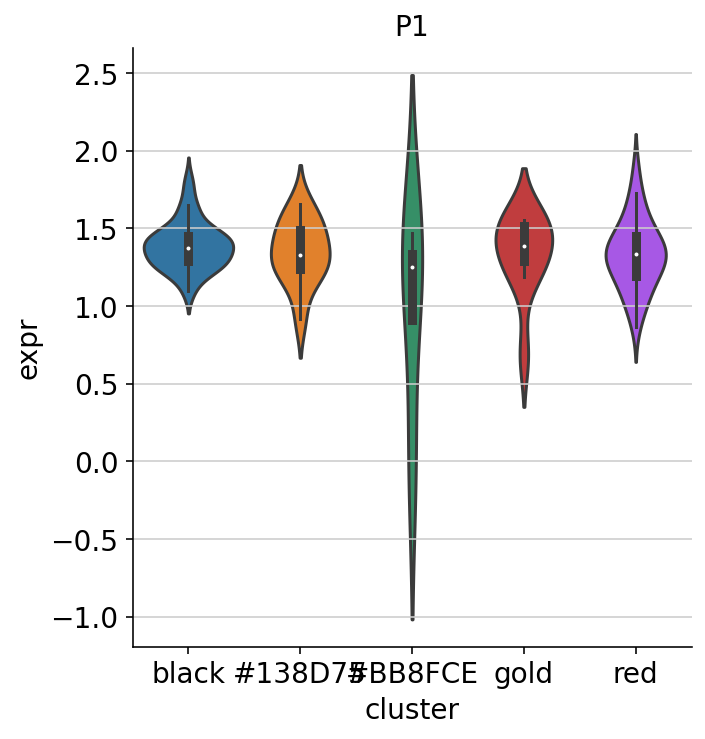

P2


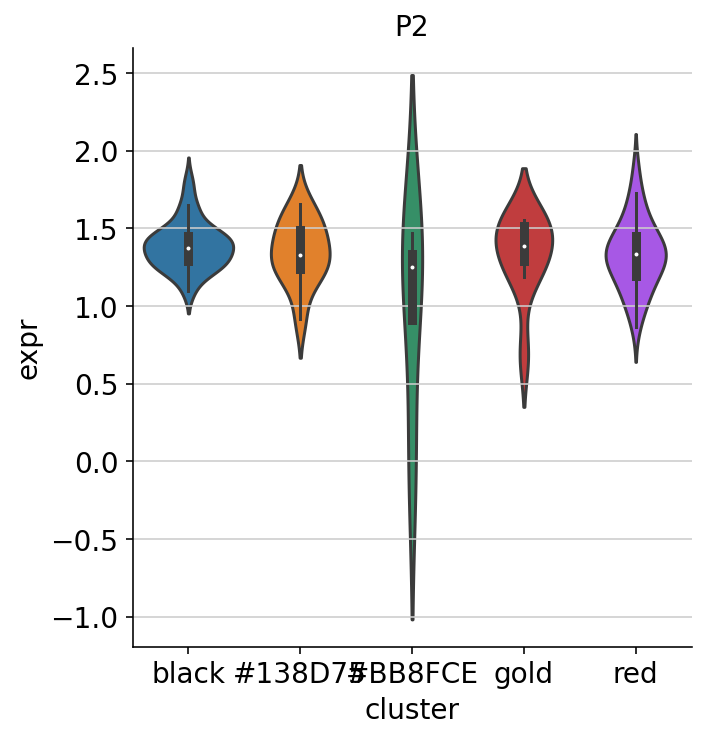

P3


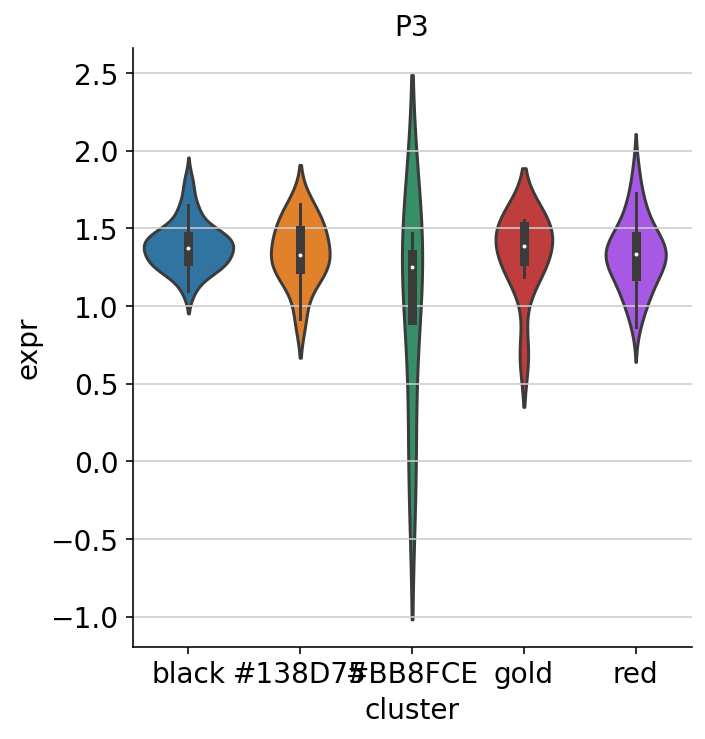

P4


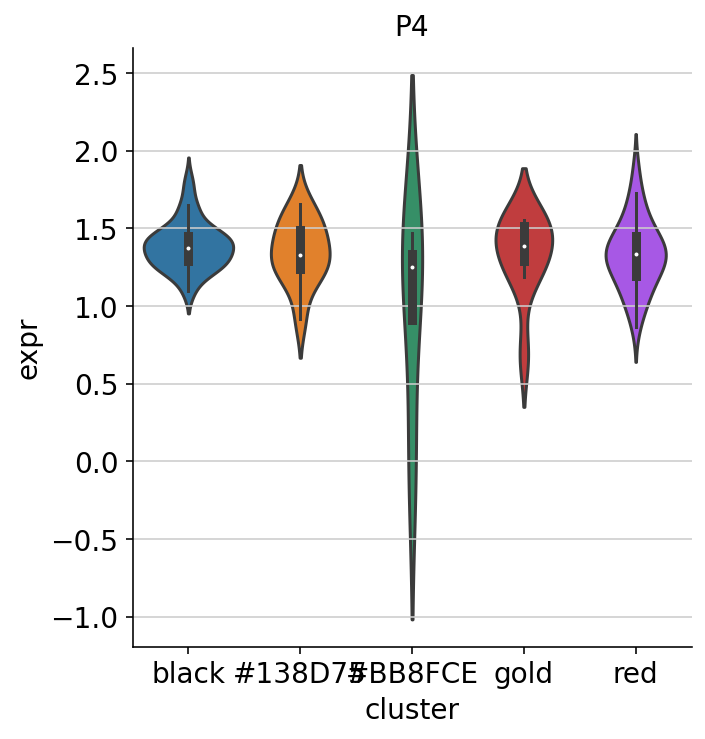

P5


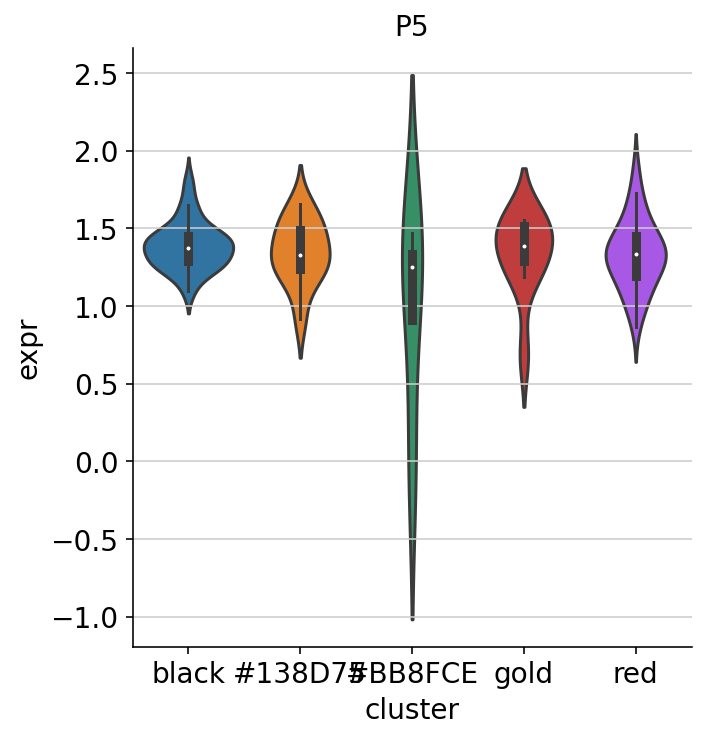

P6


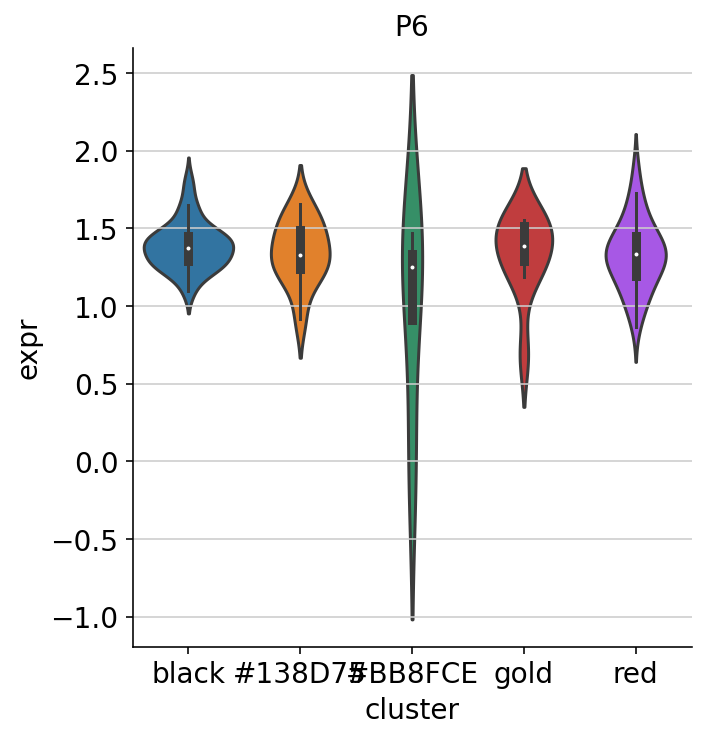

P7


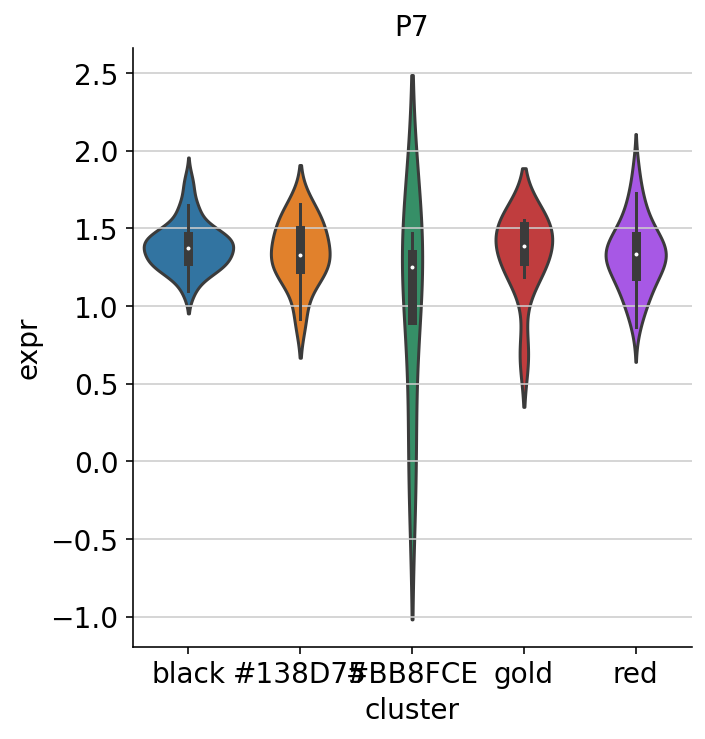

P8


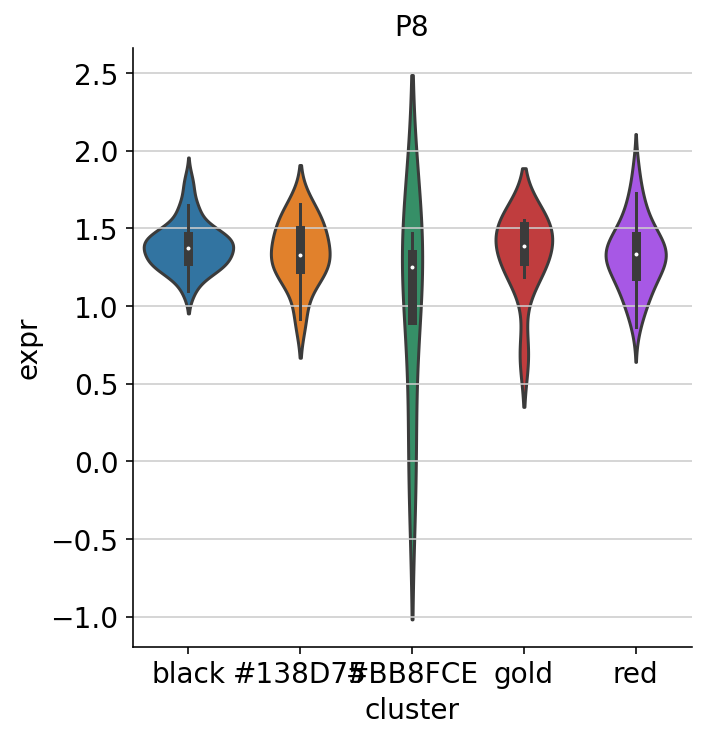

P9


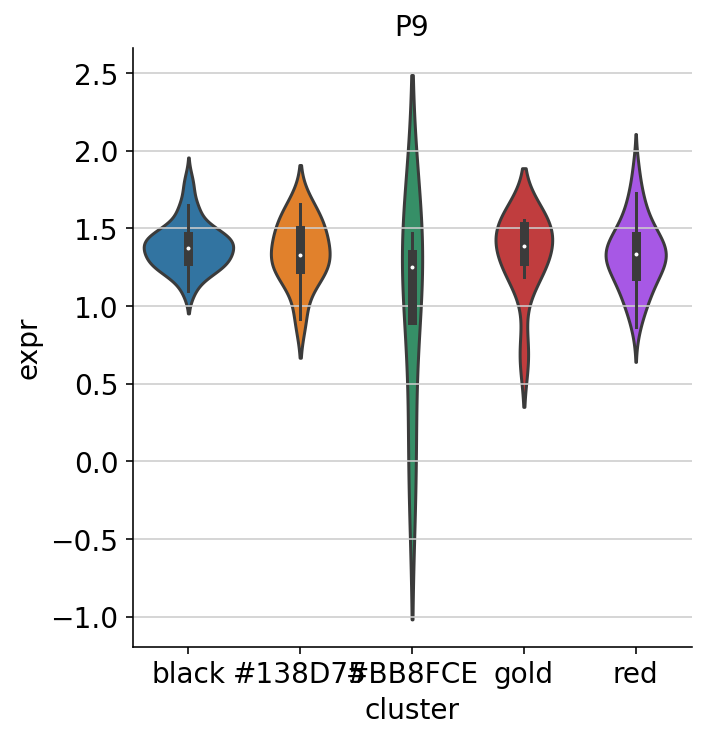

P10


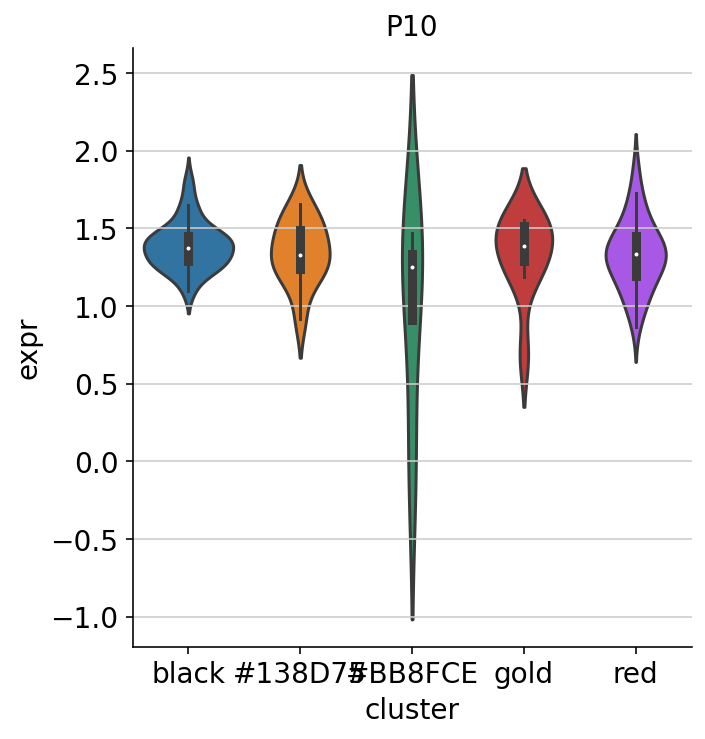

P11


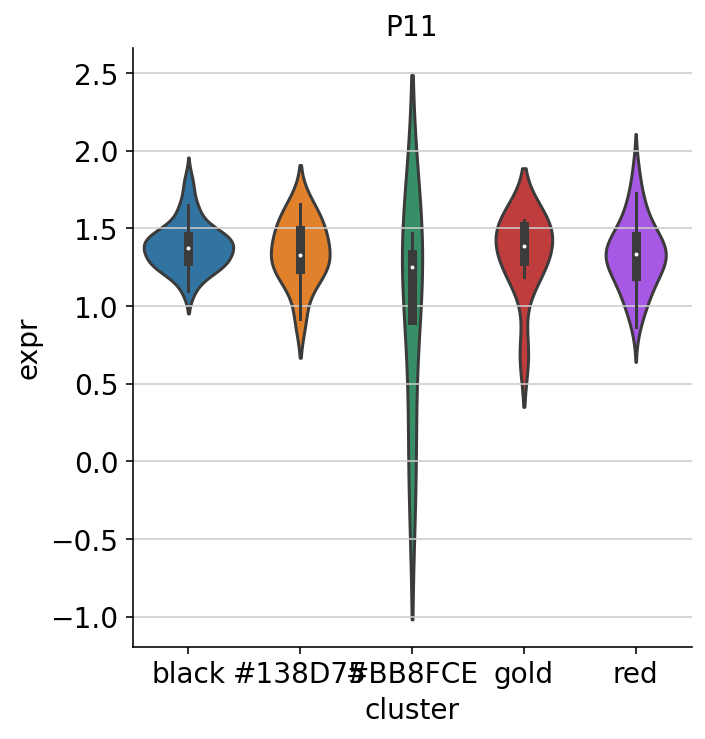

P12


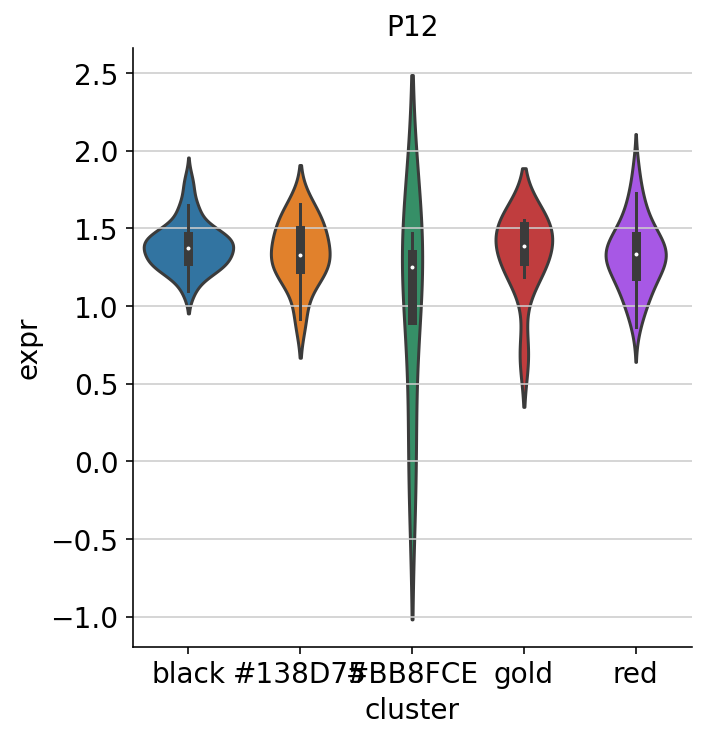

P13


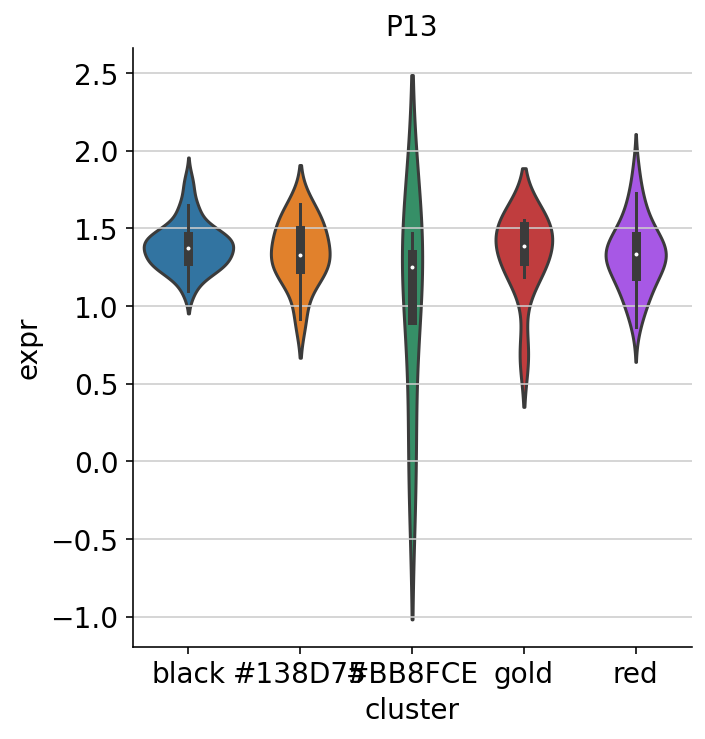

In [43]:
for pro in my_programs:
    print(pro)
    datahere=pd.DataFrame({pro:adata.uns['bulk.programs.vs_unassigned.avg'].loc[sorted_variants,pro],
                          'expr':anno.loc[sorted_variants,'variant_expression'],
                          'cluster':anno.loc[sorted_variants,'Cluster']})

    sns.catplot(x='cluster',y='expr',data=datahere, kind='violin')
    plt.title(pro)
    plt.show()

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


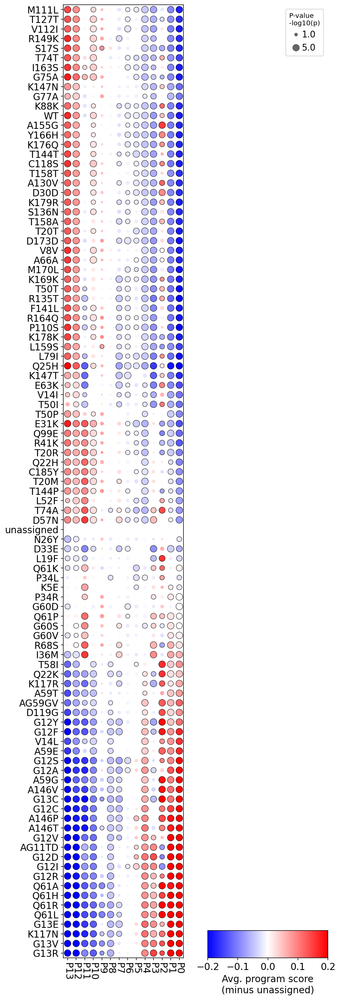

In [63]:
dotplot_programs(adata.uns['bulk.programs.vs_unassigned.avg'],
                 adata.uns['bulk.programs.vs_unassigned.p'],
                 myorder=my_programs,
                 sorted_variants=sorted_variants,
                 best_p=1e-5,
                 vmin=-0.2,vmax=0.2,
                title='Avg. program score\n(minus unassigned)',
                cbar_percent='3%',w=7,h=25)

plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_unassigned.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_dotplot_vs_unassigned.png',bbox_inches = "tight")

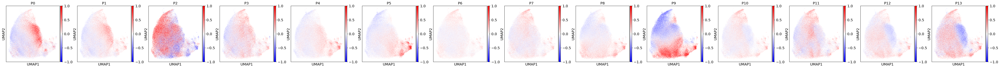

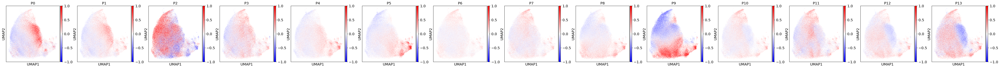

In [64]:
#plot the umaps
x=1
sc.set_figure_params(figsize=(4,4),dpi=80)
sc.pl.umap(adata,color=my_programs,cmap='bwr',ncols=len(my_programs),vmin=-x,vmax=x,
          save=PROTEIN+'_program_scores.pdf')
sc.pl.umap(adata,color=my_programs,cmap='bwr',ncols=len(my_programs),vmin=-x,vmax=x,
          save=PROTEIN+'_program_scores.png')

In [65]:
def ecdf_program(adata_here,score_names,grouping_variable,grouping_variable_color):
    
    n_pro=len(score_names)
    fig,plots=plt.subplots(1,n_pro)
    fig.set_size_inches(n_pro*3,2)
    fig.subplots_adjust(wspace=0.2, hspace=0)

    c=0
    for cl_idx in range(len(score_names)):
        cl=score_names[cl_idx]
        big_number=100

        plotting_data=pd.DataFrame({'to_plot':adata_here.obs[cl],
                                       'group':adata_here.obs[grouping_variable]})

        for group in list(set(plotting_data['group'])):
            
            chosen_color=grouping_variable_color.loc[group]
            a=plotting_data.loc[plotting_data['group']==group,'to_plot']
            mini=np.quantile(plotting_data['to_plot'],0.00001)
            maxi=np.quantile(plotting_data['to_plot'],0.99)

            steps=5000
            bins=[mini+(x*1.00)/steps*(maxi-mini) for x in range(steps)]
            bins.append(big_number)
            n, bins2, patches=plots[c].hist(a,
                cumulative=True,color=chosen_color,histtype='step',density=True,bins=bins)
            plots[c].grid(False)
            plots[c].set_xlabel(cl)
            plots[c].set_title(cl)

        plots[c].set_xlim(mini,maxi)
        #plots[c].set_xticks([round(mini,2),round(maxi,2)])
        if c==0:
            plots[c].set_ylabel('ECDF')
            plots[c].set_yticks([0,1])
        else:
            plots[c].set_yticks([0,1])
        c+=1

P0 ['TSC22D1', 'SMOX', 'MT2A', 'TGM2', 'IGFBP4', 'DUSP4', 'DDX10', 'SFRP1', 'SLC25A37', 'CDCP1']
(10, 99)
P1 ['RP11-783K16.5', 'CTNNAL1', 'EREG', 'TNNT1', 'CLMP', 'IGFBP6', 'LDHA', 'DKK1', 'EPHA2', 'PRKCA']
(10, 99)
P2 ['GNB2L1', 'RPL5', 'RPS4X', 'RPL7A', 'RPS7', 'RPL6', 'RPS24', 'RPL26', 'RPS3', 'SLC25A6']
(10, 99)
P3 ['LINC00707', 'ITGB1', 'SPINT2', 'AC093673.5', 'CD9', 'TM4SF1', 'XXyac-YM21GA2.4', 'FOSL2', 'SVIL', 'RAB3B']
(10, 99)
P4 ['TBXAS1', 'PSMD8', 'HIST1H1C', 'AGR2', 'STC2', 'MTHFD2', 'SSBP1', 'PDK4', 'HOXB6', 'TBX3']
(10, 99)
P5 ['CDC123', 'CCT7', 'LARS', 'GGH', 'PGK1', 'PA2G4', 'CCT8', 'MTIF2', 'MIR4435-2HG', 'REEP4']
(10, 99)
P6 ['SYCE1L', 'SERINC2', 'RP11-297J22.1', 'RP11-54H7.4', 'CDKN1A', 'SUMF2', 'HIST3H2A', 'SYTL2', 'ZMAT3', 'ATP6AP2']
(10, 99)
P7 ['DOCK5', 'NRP2', 'CTTN', 'SLC26A2', 'LGALS3', 'EVA1B', 'ABL2', 'CDC42', 'DST', 'HES6']
(10, 99)
P8 ['ATP1B1', 'CKAP2', 'ADAM17', 'BTBD6', 'SMC4', 'SPDL1', 'FEN1', 'TRIM59', 'ZC3H4', 'EIF2S3']
(10, 99)
P9 ['MKI67', 'CENPA', 

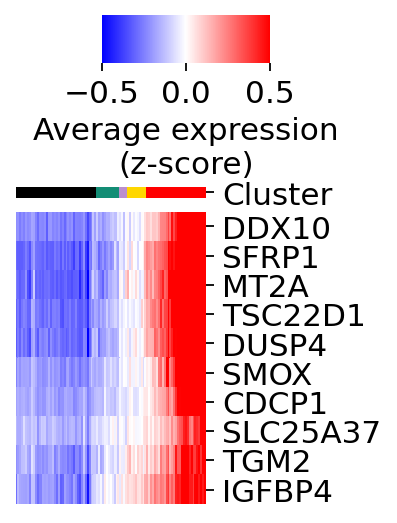

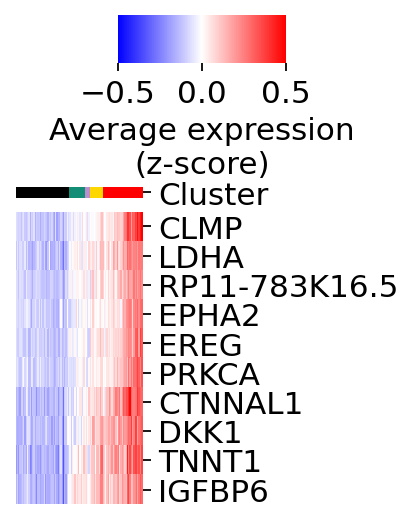

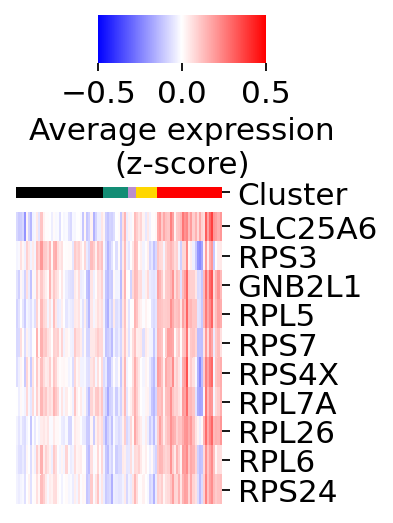

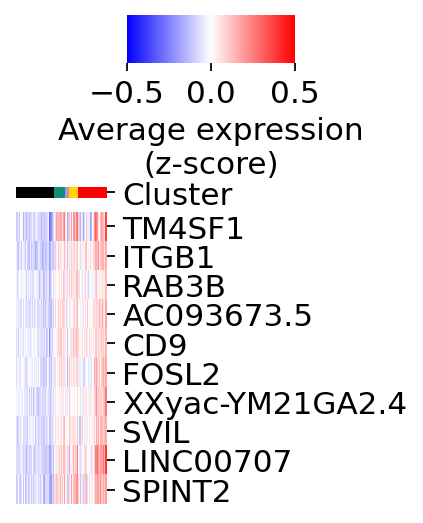

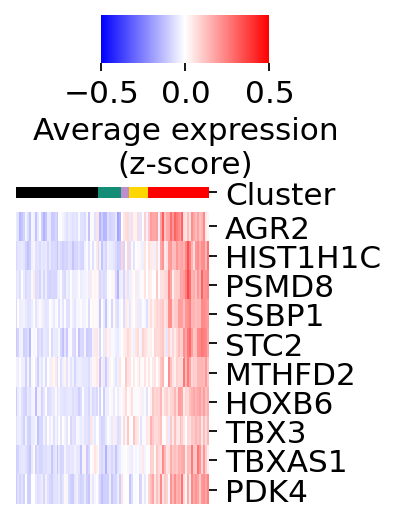

...

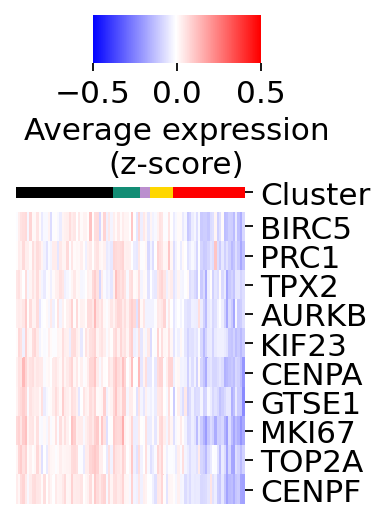

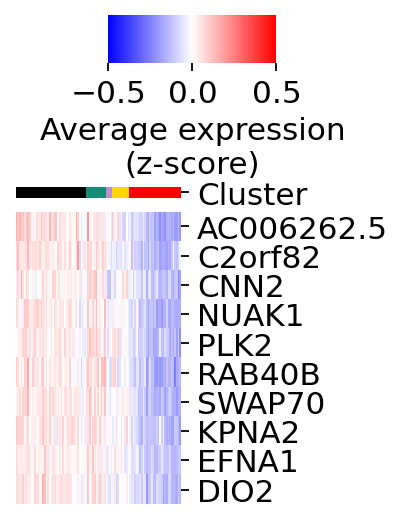

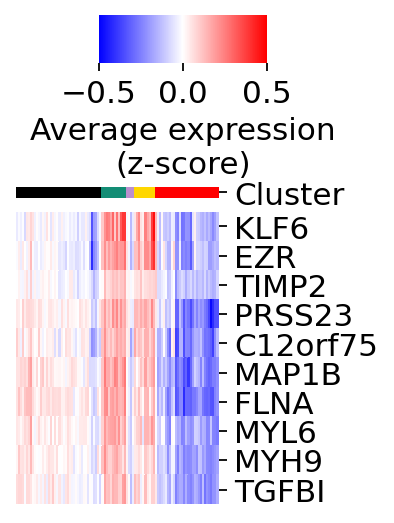

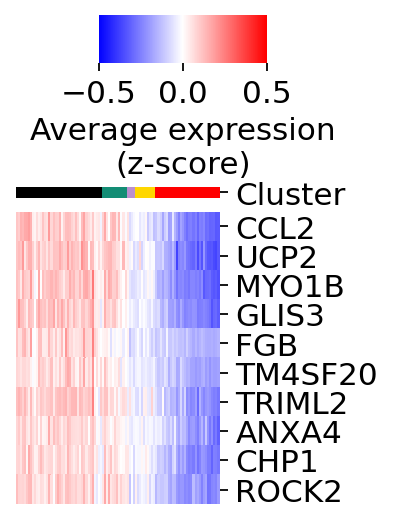

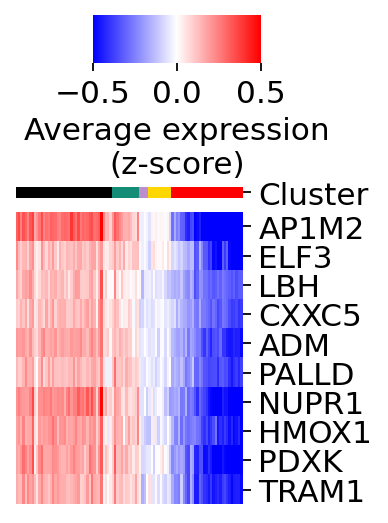

In [76]:
n=10
x=0.5
pref='P'
pro_variable='bulk.guide.compact.program'
score_names=list(set(adata.var[pro_variable]))
sc_bulk=adata.uns['bulk.guide.compact']

for cl in score_names:
    genes_cl=adata.var_names[adata.var[pro_variable]==cl]
    gene_corr=pd.DataFrame({'gene':genes_cl,'corr':0},index=genes_cl)
    for gene in genes_cl:
        from scipy.stats import spearmanr,pearsonr
        c=spearmanr(sc_bulk.loc[sorted_variants,gene],
                   bulk_programs.loc[sorted_variants,pref+str(cl)])[0]
        gene_corr.loc[gene,'corr']=c
    genes_top=list(gene_corr.sort_values(by='corr',ascending=False)['corr'][:n].index)
    print(pref+str(cl),genes_top)
    
    
    print(sc_bulk.loc[sorted_variants,genes_top].T.shape)
    g=sns.clustermap(sc_bulk.loc[sorted_variants,genes_top].T,cmap='bwr',vmin=-x,vmax=x,
                  col_cluster=False,figsize=(3,3),
                     cbar_pos=(0.35, 1, 0.35, 0.1),
                 cbar_kws={'orientation':'horizontal',
                "label": "Average expression\n(z-score)",
                'ticks':[-x,0,x]},
                     #(3,5),#(30,5),#(3,5),
                     col_colors=anno['Cluster'],yticklabels=True,xticklabels=False)
    #g.cax.set_visible(False)
    g.ax_row_dendrogram.set_visible(False)
    g.ax_col_dendrogram.set_visible(False)
    
    plt.savefig(FIGS+'/'+PROTEIN+'.program_genes_'+pref+str(cl)+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.program_genes_'+pref+str(cl)+'.png',bbox_inches = "tight")

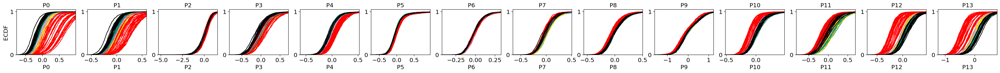

In [77]:
ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             my_programs,
             grouping_variable='guide.compact',
             grouping_variable_color=anno['Cluster'])

plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_variant.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_variant.png',bbox_inches = "tight")
    

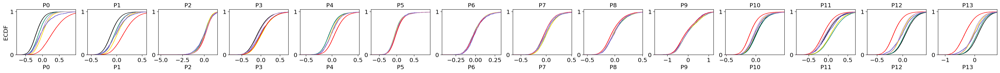

In [78]:
colors=list(set(anno['Cluster2']))
colors_df=pd.DataFrame({'color':colors},index=colors)

ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             my_programs,
             grouping_variable='Cluster2',
             grouping_variable_color=colors_df)

plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_module.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.programs_ecdf_module.png',bbox_inches = "tight")


In [20]:
def programs2go(program2gene_dict,organism="hsapiens"):
    
    gotable=pd.DataFrame(columns=['name','p_value','program'])
    
    for program in [12]:#list(program2gene_dict.keys())[:2]:
        genes=program2gene_dict[program]
        go_res=sc.queries.enrich(genes, org=organism,
                                gprofiler_kwargs={'no_evidences': False})
        #sc.queries.enrich(genes, gprofiler_kwargs={'no_evidences': False})
        go_res=go_res.loc[go_res['significant'],:]
        #print(go_res.head())
        gotable_current=go_res.loc[go_res['source']=='GO:BP',
                                   ['name','p_value','intersections']]
        print(gotable_current)
        gotable_current.to_csv('test.csv')
        if gotable_current.shape[0]==0:
            continue
        #correct p-value for multiple testing
        from statsmodels.stats.multitest import multipletests
        gotable_current['p_value']=multipletests(gotable_current['p_value'],method='fdr_bh')[1]
        gotable_current['program']='Pro: '+str(program)
        gotable=pd.concat([gotable,gotable_current],axis=0)
    go_table_result=gotable.pivot(index='name',columns='program')[['p_value']]
    go_table_result=go_table_result.fillna(1)
    go_table_result=-np.log10(go_table_result)
    
    #go through each program and print me the sig go terms
    for program in go_table_result.columns:
        keep=go_table_result.loc[go_table_result[program]>1.0,:]
        keep=keep.sort_values(by=program,ascending=False)[program]
        print(program)
        print(keep)
        print('======')
    return(go_table_result)




pro_variable='bulk.guide.compact.program'
score_names=list(set(adata.var[pro_variable]))
sc_bulk=adata.uns['bulk.guide.compact']
pro2gene={}
for cl in score_names:
    pro2gene[cl]=adata.var_names[adata.var[pro_variable]==cl]

gos=programs2go(pro2gene)

                                                 name   p_value  \
2             negative regulation of cellular process  0.000257   
4           negative regulation of cell communication  0.000343   
5                    negative regulation of signaling  0.000356   
6         negative regulation of response to stimulus  0.000394   
7                       response to organic substance  0.000518   
11          negative regulation of biological process  0.001168   
13         negative regulation of signal transduction  0.001353   
14                               response to chemical  0.001490   
15             cellular response to chemical stimulus  0.001566   
17           positive regulation of metabolic process  0.002126   
18  positive regulation of cellular metabolic process  0.002285   
19                                       MAPK cascade  0.002459   
21     signal transduction by protein phosphorylation  0.002800   
22                positive regulation of MAPK cascade  0.00327

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:22: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



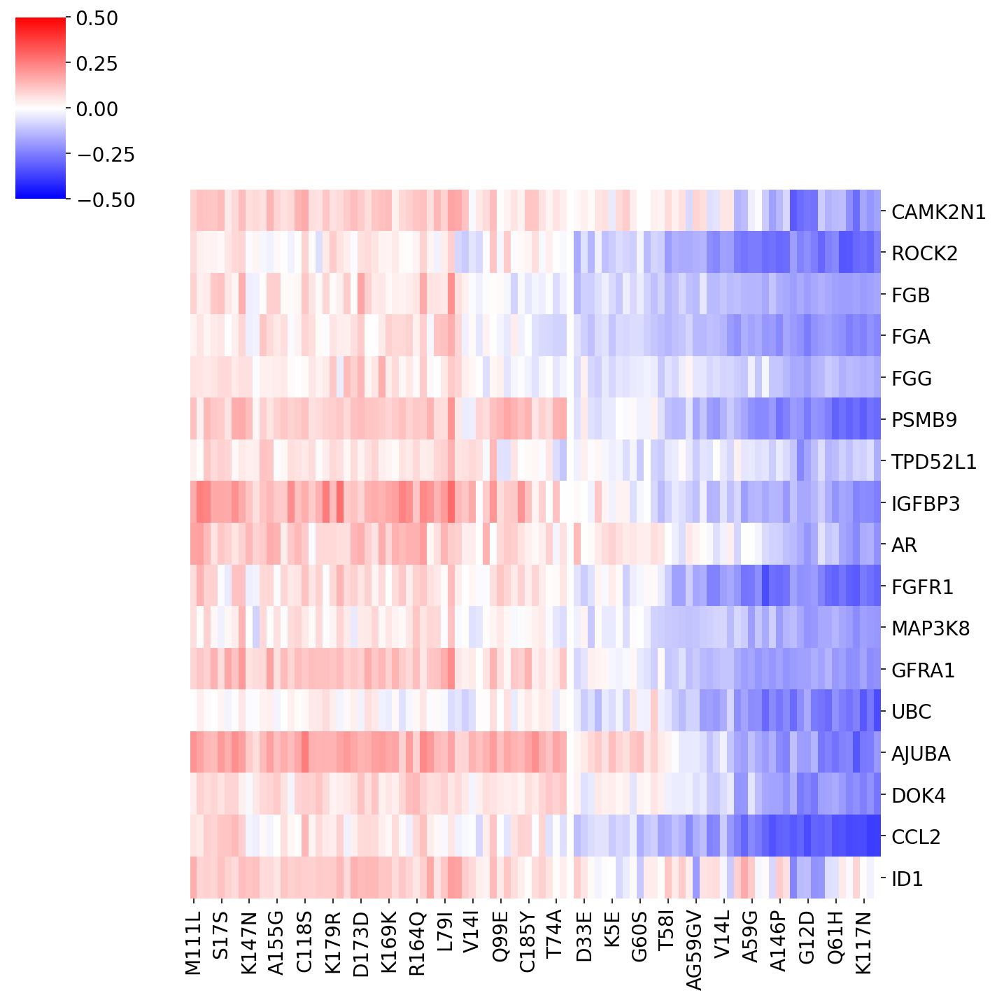

In [41]:
x=0.5
genes_here=['CAMK2N1', 'ROCK2', 'FGB', 'FGA', 'FGG', 
            'PSMB9', 'TPD52L1', 'IGFBP3', 
            'AR', 'FGFR1', 'MAP3K8', 'GFRA1',
            'UBC', 'AJUBA', 'DOK4', 'CCL2', 'ID1']
sns.clustermap((sc_bulk.loc[sorted_variants,genes_here]-sc_bulk.loc['unassigned',genes_here]).T,
              cmap='bwr',vmin=-x,vmax=x,col_cluster=False,
              row_cluster=False)

In [35]:
from Bio import Entrez

def human_gene_summary_from_entrez(gene_name='RRP9'):
    Entrez.email = "oursu@broadinstitute.org" # Always tell NCBI who you are
    term = "{}[Gene Name] AND Homo Sapiens[Organism]".format(gene_name)
    handle = Entrez.esearch(db='gene', term=term)
    result = Entrez.read(handle)
    handle.close()

    gene_id = result["IdList"][0]    

    handle = Entrez.esummary(db="gene", id=gene_id)
    result = Entrez.read(handle)
    handle.close()

    res = result['DocumentSummarySet']['DocumentSummary'][0]
    return res['Name'], res['Summary']

for gene in genes_here:
    print(gene)
    import time
    time.sleep(5)
    print(human_gene_summary_from_entrez(gene_name=gene))
    

CAMK2N1
('CAMK2N1', '')
ROCK2
('ROCK2', 'The protein encoded by this gene is a serine/threonine kinase that regulates cytokinesis, smooth muscle contraction, the formation of actin stress fibers and focal adhesions, and the activation of the c-fos serum response element. This protein, which is an isozyme of ROCK1 is a target for the small GTPase Rho. [provided by RefSeq, Jul 2008]')
FGB
('FGB', 'The protein encoded by this gene is the beta component of fibrinogen, a blood-borne glycoprotein comprised of three pairs of nonidentical polypeptide chains. Following vascular injury, fibrinogen is cleaved by thrombin to form fibrin which is the most abundant component of blood clots. In addition, various cleavage products of fibrinogen and fibrin regulate cell adhesion and spreading, display vasoconstrictor and chemotactic activities, and are mitogens for several cell types. Fibrinogen serves key roles in hemostasis and antimicrobial host defense. Mutations in this gene lead to several disord

HTTPError: HTTP Error 429: Too Many Requests

In [37]:

for gene in ['PSMB9', 'TPD52L1', 'IGFBP3']:
    print(gene)
    import time
    time.sleep(5)
    print(human_gene_summary_from_entrez(gene_name=gene))


PSMB9
('PSMB9', 'The proteasome is a multicatalytic proteinase complex with a highly ordered ring-shaped 20S core structure. The core structure is composed of 4 rings of 28 non-identical subunits; 2 rings are composed of 7 alpha subunits and 2 rings are composed of 7 beta subunits. Proteasomes are distributed throughout eukaryotic cells at a high concentration and cleave peptides in an ATP/ubiquitin-dependent process in a non-lysosomal pathway. An essential function of a modified proteasome, the immunoproteasome, is the processing of class I MHC peptides. This gene encodes a member of the proteasome B-type family, also known as the T1B family, that is a 20S core beta subunit. This gene is located in the class II region of the MHC (major histocompatibility complex). Expression of this gene is induced by gamma interferon and this gene product replaces catalytic subunit 1 (proteasome beta 6 subunit) in the immunoproteasome. Proteolytic processing is required to generate a mature subunit. 

In [42]:
for gene in ['AR', 'FGFR1', 'MAP3K8', 'GFRA1']:
    print(gene)
    import time
    time.sleep(5)
    print(human_gene_summary_from_entrez(gene_name=gene))


AR
('AR', "The androgen receptor gene is more than 90 kb long and codes for a protein that has 3 major functional domains: the N-terminal domain, DNA-binding domain, and androgen-binding domain. The protein functions as a steroid-hormone activated transcription factor. Upon binding the hormone ligand, the receptor dissociates from accessory proteins, translocates into the nucleus, dimerizes, and then stimulates transcription of androgen responsive genes. This gene contains 2 polymorphic trinucleotide repeat segments that encode polyglutamine and polyglycine tracts in the N-terminal transactivation domain of its protein. Expansion of the polyglutamine tract from the normal 9-34 repeats to the pathogenic 38-62 repeats causes spinal bulbar muscular atrophy (SBMA, also known as Kennedy's disease). Mutations in this gene are also associated with complete androgen insensitivity (CAIS). Alternative splicing results in multiple transcript variants encoding different isoforms. [provided by RefS

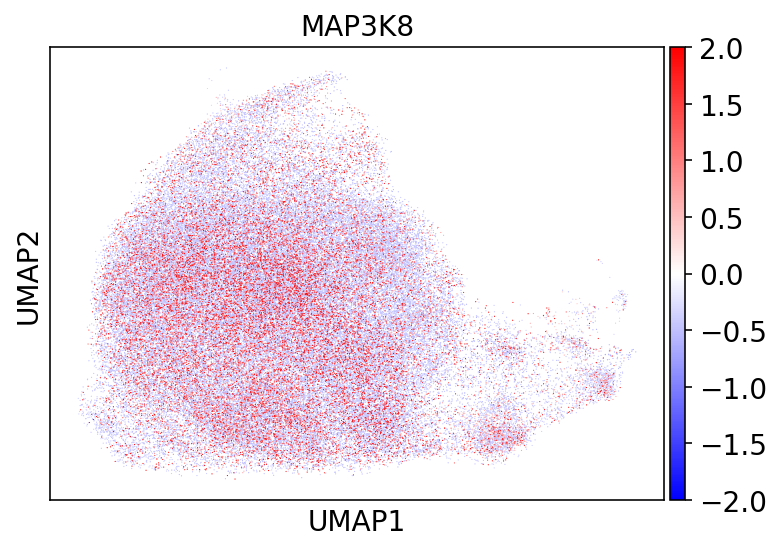

In [50]:
x=2
sc.pl.umap(adata,color=['MAP3K8'],cmap='bwr',use_raw=False,
          vmin=-x,vmax=x)

In [43]:
for gene in ['AR', 'FGFR1', 'MAP3K8', 'GFRA1']:
    print(gene)
    import time
    time.sleep(5)
    print(human_gene_summary_from_entrez(gene_name=gene))


AR
('AR', "The androgen receptor gene is more than 90 kb long and codes for a protein that has 3 major functional domains: the N-terminal domain, DNA-binding domain, and androgen-binding domain. The protein functions as a steroid-hormone activated transcription factor. Upon binding the hormone ligand, the receptor dissociates from accessory proteins, translocates into the nucleus, dimerizes, and then stimulates transcription of androgen responsive genes. This gene contains 2 polymorphic trinucleotide repeat segments that encode polyglutamine and polyglycine tracts in the N-terminal transactivation domain of its protein. Expansion of the polyglutamine tract from the normal 9-34 repeats to the pathogenic 38-62 repeats causes spinal bulbar muscular atrophy (SBMA, also known as Kennedy's disease). Mutations in this gene are also associated with complete androgen insensitivity (CAIS). Alternative splicing results in multiple transcript variants encoding different isoforms. [provided by RefS

In [51]:
for gene in ['UBC', 'AJUBA', 'DOK4', 'CCL2', 'ID1']:
    print(gene)
    import time
    time.sleep(5)
    print(human_gene_summary_from_entrez(gene_name=gene))


UBC
('UBC', 'This gene represents a ubiquitin gene, ubiquitin C. The encoded protein is a polyubiquitin precursor. Conjugation of ubiquitin monomers or polymers can lead to various effects within a cell, depending on the residues to which ubiquitin is conjugated. Ubiquitination has been associated with protein degradation, DNA repair, cell cycle regulation, kinase modification, endocytosis, and regulation of other cell signaling pathways. [provided by RefSeq, Aug 2010]')
AJUBA
('AJUBA', '')
DOK4
('DOK4', '')
CCL2
('CCL2', 'This gene is one of several cytokine genes clustered on the q-arm of chromosome 17. Chemokines are a superfamily of secreted proteins involved in immunoregulatory and inflammatory processes. The superfamily is divided into four subfamilies based on the arrangement of N-terminal cysteine residues of the mature peptide. This chemokine is a member of the CC subfamily which is characterized by two adjacent cysteine residues. This cytokine displays chemotactic activity fo

In [36]:
print(human_gene_summary_from_entrez(gene_name='FGG'))

('FGG', 'The protein encoded by this gene is the gamma component of fibrinogen, a blood-borne glycoprotein comprised of three pairs of nonidentical polypeptide chains. Following vascular injury, fibrinogen is cleaved by thrombin to form fibrin which is the most abundant component of blood clots. In addition, various cleavage products of fibrinogen and fibrin regulate cell adhesion and spreading, display vasoconstrictor and chemotactic activities, and are mitogens for several cell types. Mutations in this gene lead to several disorders, including dysfibrinogenemia, hypofibrinogenemia and thrombophilia. Alternative splicing results in transcript variants encoding different isoforms. [provided by RefSeq, Aug 2015]')


In [ ]:
print(human_gene_summary_from_entrez(gene_name='FGG'))

In [79]:
def programs2go(program2gene_dict,organism="hsapiens"):
    
    gotable=pd.DataFrame(columns=['name','p_value','program'])
    
    for program in program2gene_dict:
        genes=program2gene_dict[program]
        go_res=sc.queries.enrich(genes, org=organism)
        go_res=go_res.loc[go_res['significant'],:]
        #print(go_res.head())
        gotable_current=go_res.loc[go_res['source']=='GO:BP',['name','p_value']]
        if gotable_current.shape[0]==0:
            continue
        #correct p-value for multiple testing
        from statsmodels.stats.multitest import multipletests
        gotable_current['p_value']=multipletests(gotable_current['p_value'],method='fdr_bh')[1]
        gotable_current['program']='Pro: '+str(program)
        gotable=pd.concat([gotable,gotable_current],axis=0)
    go_table_result=gotable.pivot(index='name',columns='program')[['p_value']]
    go_table_result=go_table_result.fillna(1)
    go_table_result=-np.log10(go_table_result)
    
    #go through each program and print me the sig go terms
    for program in go_table_result.columns:
        keep=go_table_result.loc[go_table_result[program]>1.0,:]
        keep=keep.sort_values(by=program,ascending=False)[program]
        print(program)
        print(keep)
        print('======')
    return(go_table_result)





score_names=list(set(adata.var[pro_variable]))
sc_bulk=adata.uns['bulk.guide.compact']
pro2gene={}
for cl in score_names:
    pro2gene[cl]=adata.var_names[adata.var[pro_variable]==cl]

gos=programs2go(pro2gene)

('p_value', 'Pro: 0')
name
inflammatory response               1.644907
mesodermal cell differentiation     1.644907
oncogene-induced cell senescence    1.544246
tissue development                  1.542531
gastrulation                        1.322200
Name: (p_value, Pro: 0), dtype: float64
('p_value', 'Pro: 1')
name
response to chemical                                    5.479947
response to organic substance                           5.479947
response to oxygen-containing compound                  4.913152
regulation of cell population proliferation             4.285873
cell population proliferation                           3.506816
cell communication                                      3.206180
cellular response to chemical stimulus                  3.154741
response to stimulus                                    2.968127
response to hormone                                     2.829905
programmed cell death                                   2.783560
positive regulation of cell pop

Continuum analysis
===

(with PCA)

In [11]:
for pc in range(50):
    adata.obs['PC'+str(pc)]=-adata.obsm['X_pca'][:,pc]
adata

AnnData object with n_obs × n_vars = 90262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60V', 'G12

In [12]:
gain_pos_var=list(anno.loc[anno['Position'].isin([12,13,61]),:].index)
neutrals=list(anno.loc[anno['control_status']=='synonymous',:].index)
print(gain_pos_var)
print(neutrals)

['G12D', 'G12V', 'G12C', 'G13D', 'G12A', 'G12R', 'Q61H', 'G12S', 'G13C', 'Q61R', 'Q61L', 'Q61K', 'G12F', 'G13V', 'G13E', 'G13R', 'G12L', 'G12Y', 'Q61A', 'G12I', 'Q61P']
['V8V', 'S17S', 'T20T', 'D30D', 'T50T', 'A66A', 'Q70Q', 'T74T', 'K88K', 'T127T', 'T144T', 'T158T', 'K169K', 'D173D', 'K178K', 'WT']


... storing 'known_gain' as categorical


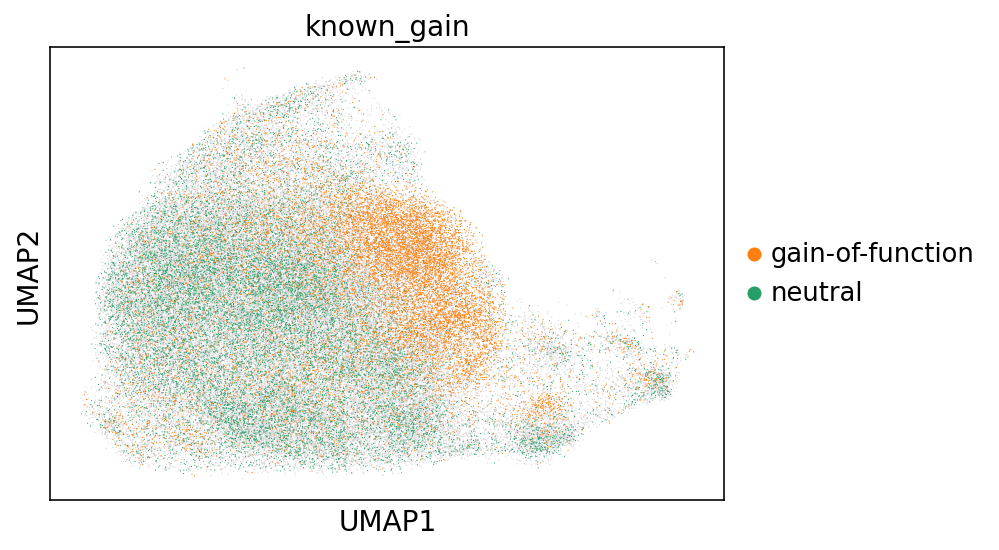

In [13]:
gain_pos=[]
for i in range(adata.n_obs):
    anno_here='NA'
    if adata.obs['guide.compact'][i] in gain_pos_var:
        anno_here='gain-of-function'
    if adata.obs['guide.compact'][i] in neutrals:
        anno_here='neutral'
    gain_pos.append(anno_here)
adata.obs['known_gain']=gain_pos

sc.pl.umap(adata,color=['known_gain'],groups=['gain-of-function','neutral'])

In [14]:
#ttest PC between known gain and the wildtypes
#genes in each PC

pc_pval=pd.DataFrame({'pc':range(50),'p':1,'t':0,'auPRC':0})
pc_pval.index=list(pc_pval['pc'])


attr='known_gain'
g1='gain-of-function'
g2='neutral'

for pc in range(50):
    if pc%10==0:
        print(pc)

    val='PC'+str(pc)
    g1_cells=adata.obs_names[adata.obs[attr]==g1]
    g2_cells=adata.obs_names[adata.obs[attr]==g2]
    g1_values=adata[g1_cells,:].obs[val]
    g2_values=adata[g2_cells,:].obs[val]

    from scipy.stats import ttest_ind
    
    res=ttest_ind(g1_values,g2_values)
    pc_pval.loc[pc,'p']=res[1]
    pc_pval.loc[pc,'t']=res[0]

0
10
20
30
40


In [15]:
from statsmodels.stats.multitest import multipletests

pc_pval['p.adj']=multipletests(pc_pval['p'],method='fdr_bh')[1]
pc_pval=pc_pval.sort_values(by='p.adj')

fdr=0.01
print(pc_pval.loc[pc_pval['p.adj']<=fdr,:].shape)
pc_pval.loc[pc_pval['p.adj']<=fdr,:]

(32, 5)


,pc,p,t,auPRC,p.adj
3,3,0.000000e+00,157.895655,0,0.000000e+00
4,4,0.000000e+00,91.268096,0,0.000000e+00
5,5,0.000000e+00,-49.114984,0,0.000000e+00
8,8,9.958969e-137,25.024259,0,1.244871e-135
14,14,1.407039e-92,20.483348,0,1.407039e-91
10,10,1.119948e-80,-19.082714,0,9.332904e-80
2,2,9.084127e-73,18.093965,0,6.488662e-72
13,13,1.551281e-72,18.064117,0,9.695505e-72
17,17,1.727868e-63,-16.862414,0,9.599268e-63
12,12,6.353827e-55,15.642206,0,3.176913e-54


In [12]:
#classification by PCs
adata2=adata[adata.obs['known_gain'].isin(['neutral','gain-of-function']),:]
print(adata2)

adata3=perturb.pp.subsample_cells(adata2,10000,'known_gain')
print(adata3)

#X = expression
pcs=range(10)

fig,plots=plt.subplots(1)
fig.set_size_inches(5,5)

for pc in pcs:
    X=pd.DataFrame(adata3.obsm['X_pca'][:,pc],index=adata3.obs_names)

    #y=variant class
    variant_mapping={'neutral':0,'gain-of-function':1}
    y=[]
    for i in range(len(adata3.obs_names)):
        var_group=variant_mapping[adata3.obs['known_gain'][i]]
        y.append(var_group)
    classes=['neutral','gain-of-function']
   
    from sklearn.model_selection import train_test_split
    X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.7)
    
    from sklearn.datasets import make_gaussian_quantiles
    from sklearn.ensemble import AdaBoostClassifier
    from sklearn.metrics import accuracy_score
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.linear_model import LogisticRegression
    import numpy as np
    import matplotlib.pyplot as plt
    from sklearn import svm, datasets
    from sklearn.model_selection import train_test_split
    from sklearn.metrics import confusion_matrix
    from sklearn.utils.multiclass import unique_labels
    from sklearn.linear_model import LogisticRegression
    from sklearn.metrics import roc_curve



    clf = LogisticRegression(random_state=0, multi_class='multinomial',penalty='l2',
                            max_iter=500)
    clf.fit(X_train, y_train)

    #predict===================
    pred_valid=clf.predict(X_valid)
    pred_train=clf.predict(X_train)
    pred_valid_scores=clf.predict_proba(X_valid)[:,1]
    print(pred_valid.shape)
    
    #plot_confusion_matrix(y_valid, 
    #                  pred_valid, 
    #                  classes=classes,normalize=True,title='PC'+str(pc))
    
    print(pc,clf.score(X_valid, y_valid))
    import matplotlib
    import matplotlib.cm as cm
    norm = matplotlib.colors.Normalize(vmin=0, vmax=len(pcs), clip=True)
    mapper = cm.ScalarMappable(norm=norm, cmap=cm.rainbow)
    mapped_color=mapper.to_rgba(pc) #where v is the value
    fpr_rt, tpr_rt, _ = roc_curve(y_valid, pred_valid_scores)
    from sklearn import metrics
    auROC=round(metrics.auc(fpr_rt, tpr_rt),2)

    
    plots.plot(fpr_rt, tpr_rt, label='PC'+str(pc)+': '+"%.2f" % auROC,color=mapped_color)
plots.set_xlabel('False positive rate')
plots.set_ylabel('True positive rate')
plots.set_title('ROC curve')
plots.legend(loc='best')
plots.grid(False)
plt.savefig(FIGS+'/'+PROTEIN+'.PCauROC.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PCauROC.png',bbox_inches = "tight")

NameError: name 'adata' is not defined

In [15]:
bulk_programs_pc_un,p_pc_un=get_bulk_programs_with_sig(adata,['PC'+str(x) for x in range(10)],
                                           ref='unassigned',variant_col='guide.compact',
                                           fdr=0.1)

PC0
PC1
PC2
PC3
PC4
PC5
PC6
PC7
PC8
PC9


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


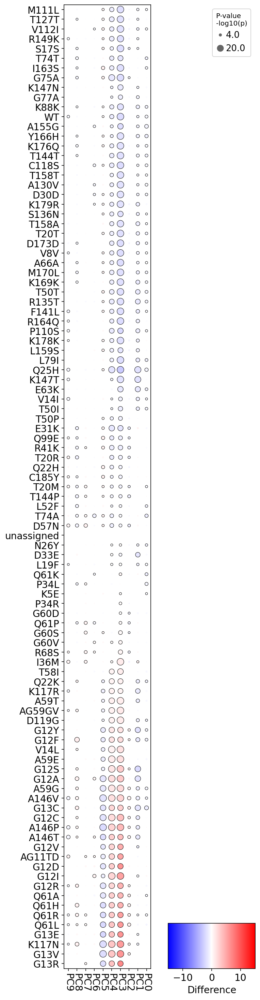

In [24]:
dotplot_programs(bulk_programs_pc_un,p_pc_un,
                 myorder=['PC'+str(x) for x in range(10)],
                 sorted_variants=sorted_variants,
                 best_p=1e-20,
                 vmin=-15,vmax=15)

plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_unassigned.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_unassigned.png',bbox_inches = "tight")

In [16]:
bulk_programs_pc,p_pc=get_bulk_programs_with_sig(adata,['PC'+str(x) for x in range(10)],
                                           ref='WT',variant_col='guide.compact',
                                           fdr=0.1)

PC0
PC1
PC2
PC3
PC4
PC5
PC6
PC7
PC8
PC9


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


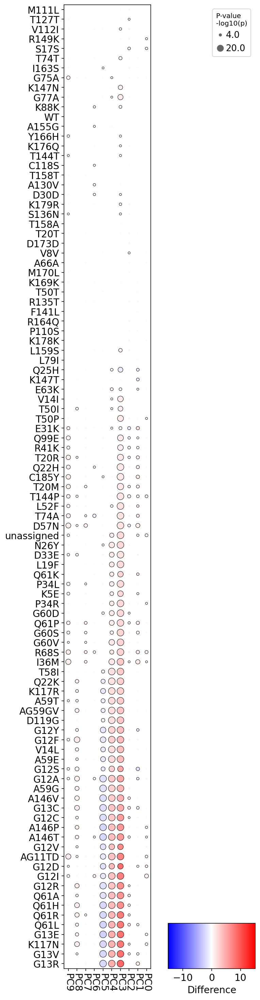

In [17]:
dotplot_programs(bulk_programs_pc,p_pc,
                 myorder=['PC'+str(x) for x in range(10)],
                 sorted_variants=sorted_variants,
                 best_p=1e-20,
                 vmin=-15,vmax=15)

plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_WT.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_dotplot_vs_WT.png',bbox_inches = "tight")

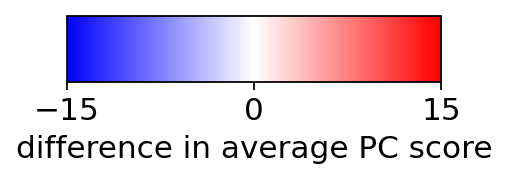

In [137]:
import matplotlib.pyplot as plt
import matplotlib as mpl

fig, ax = plt.subplots(figsize=(3, 1))
fig.subplots_adjust(bottom=0.5)

cmap = mpl.cm.bwr
norm = mpl.colors.Normalize(vmin=-15, vmax=15)

cb1 = mpl.colorbar.ColorbarBase(ax, cmap=cmap,
                                norm=norm,
                                orientation='horizontal',ticks=[-15,0,15])
cb1.set_label('difference in average PC score')
fig.show()

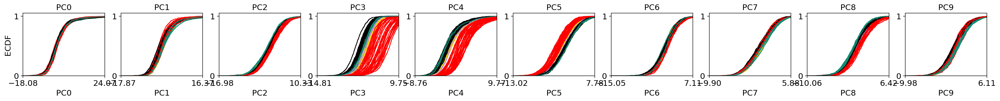

In [130]:
ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             ['PC'+str(x) for x in range(10)],
             grouping_variable='guide.compact',
             grouping_variable_color=anno['Cluster'])

plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_variant.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_variant.png',bbox_inches = "tight")

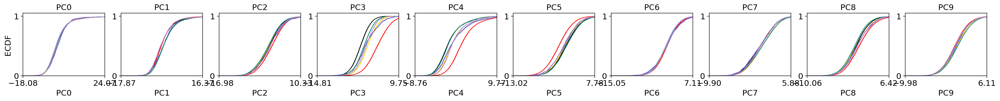

In [131]:
colors=list(set(anno['Cluster2']))
colors_df=pd.DataFrame({'color':colors},index=colors)

ecdf_program(adata[adata.obs['guide.compact']!='multiple',:],
             ['PC'+str(x) for x in range(10)],
             grouping_variable='Cluster2',
             grouping_variable_color=colors_df)

plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_module.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.PC_ecdf_module.png',bbox_inches = "tight")

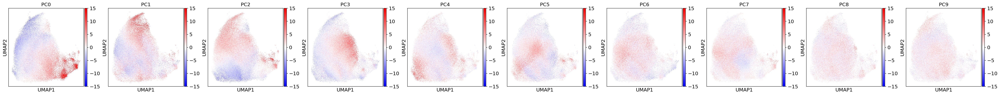

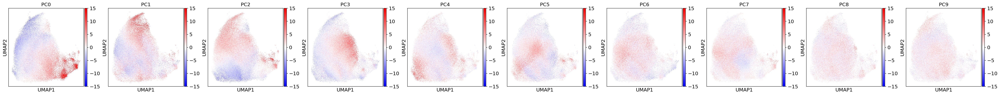

In [135]:
#plot the umaps
x=15
sc.set_figure_params(figsize=(4,4),dpi=80)
sc.pl.umap(adata,color=['PC'+str(x) for x in range(10)],cmap='bwr',ncols=10,vmin=-x,vmax=x,
          save='KRAS_PC_scores.pdf')
sc.pl.umap(adata,color=['PC'+str(x) for x in range(10)],cmap='bwr',ncols=10,vmin=-x,vmax=x,
          save='KRAS_PC_scores.png')

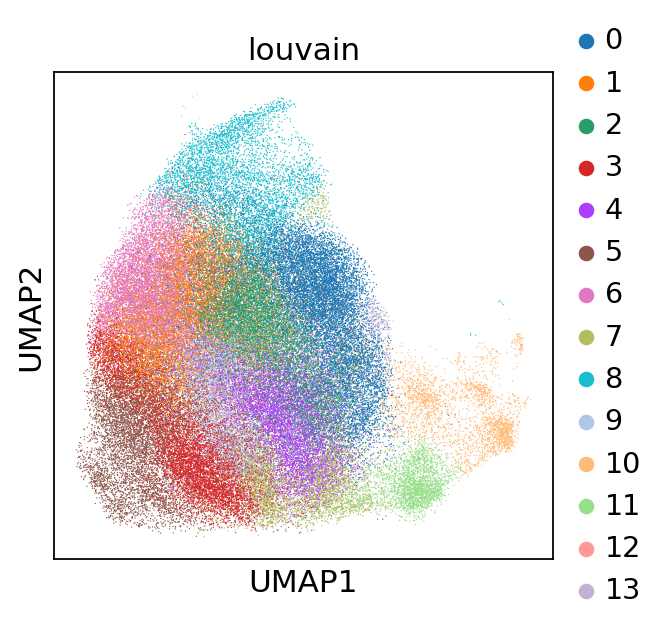

In [138]:
sc.pl.umap(adata,color=['louvain'])

In [19]:
bulk_programs_louvain_pro,p_louvain_pro=get_bulk_programs_with_sig(adata[adata.obs['guide.compact']!='multiple',:],
                                                                         ['P'+str(x) for x in range(14)],
                                           ref=None,variant_col='louvain',
                                           fdr=0.1)

P0
P1
P2
P3
P4
P5
P6
P7
P8
P9
P10
P11
P12
P13


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


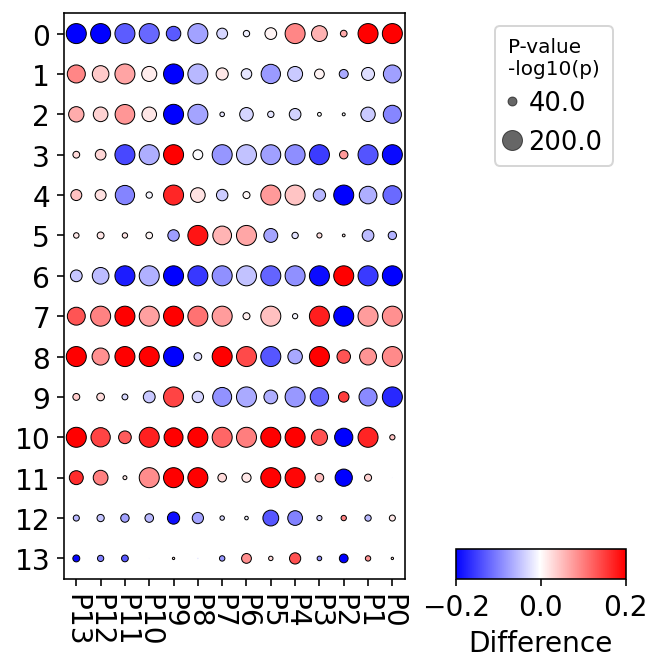

In [26]:
louvains=['0','1','2','3','4','5','6','7','8','9','10','11','12','13']
my_programs=['P'+str(x) for x in range(14)]
dotplot_programs(bulk_programs_louvain_pro,p_louvain_pro,
                 myorder=my_programs,
                 sorted_variants=louvains,
                 best_p=1e-200,
                 vmin=-0.2,vmax=0.2,w=5,h=5,cbar_percent='6%',widths=[2,1])

plt.savefig(FIGS+'/'+PROTEIN+'.louvain_vs_programs.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.louvain_vs_programs.png',bbox_inches = "tight")

In [8]:
import matplotlib

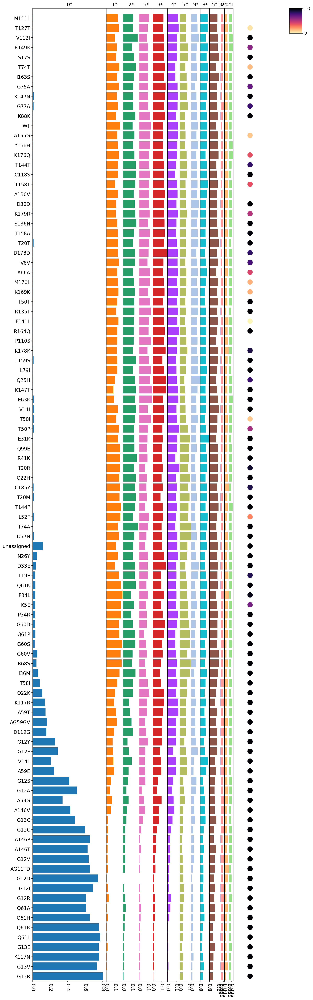

In [9]:
adata.uns['phase.multi_colors']=['gray','purple','red','orange','gold','lightblue']
def obs_split(adata_here,obs_of_interest,pref='',copy_adata=False):
    #convert one vector of obs into one obs for each encountered value 
    
    import pandas as pd
    import copy
    
    if copy_adata:
        adata_here=copy.deepcopy(adata_here)
    encountered_values=list(set(adata_here.obs[obs_of_interest]))
    cells=adata_here.obs_names
    df=pd.DataFrame(0,columns=encountered_values,index=cells)
    
    for val_idx,value in enumerate(encountered_values):
        df[value]=1.0*(adata_here.obs[obs_of_interest]==value)
    
    for col in df.columns:
        adata_here.obs[pref+col]=df[col]
    
    if copy_adata:
        return(adata_here)


def perturbation2cluster(adata_here,perturbations,cluster_variable):

    clusters=list(set(adata_here.obs[cluster_variable]))
    perturbations_found=list(set(perturbations).intersection(set(adata_here.obs.columns)))
    cluster_counts=pd.DataFrame(index=perturbations_found,columns=clusters)
    for perturbation in perturbations:
        if perturbation not in adata_here.obs.columns:
            print("WARNING: The perturbation "+perturbation+' is not saved in adata as an obs. It will not be included in this analysis.')
            continue
        perturbation_cells=adata_here[adata_here.obs[perturbation]>0,:]
        for cl in clusters:
            count=np.sum(perturbation_cells.obs[cluster_variable]==cl)
            cluster_counts.loc[perturbation,cl]=count
    return(cluster_counts)

   
def chisq_test_from_table(compositional_counts_table,reference):

    from scipy.stats import chisquare

    #compute expected fractions                                                                              
    #- either from a control perturbation or from the total                                                  
    if reference=='total':
        exp_counts=np.rint(compositional_counts_table.sum(axis=0))
    else:
        exp_counts=compositional_counts_table.loc[reference,:]
    exp_total=np.array(exp_counts).sum()
    exp_fractions=np.array(exp_counts)/np.array(exp_counts).sum()

    #go through each line of counts and perform chi-square test                                              
    chisq_stats_here=pd.DataFrame(index=compositional_counts_table.index,columns=['p','test_stat'])
    for item in compositional_counts_table.index:

        obs_counts_init=compositional_counts_table.loc[item,:]
        obs_fractions=np.array(obs_counts_init)/np.array(obs_counts_init).sum()
        obs_total=np.array(obs_counts_init).sum()
        #obs_counts=np.rint(exp_total*obs_fractions)
        obs_counts=obs_counts_init
        exp_counts=np.rint(obs_total*exp_fractions)

        test_result=chisquare(np.array(obs_counts)+1, exp_counts+1)

        chisq_stats_here.loc[item,'p']=test_result[1]
        chisq_stats_here.loc[item,'test_stat']=test_result[0]
    #adjust p-values with BH
    from statsmodels.stats.multitest import multipletests
    chisq_stats_here['p.adj']=multipletests(chisq_stats_here['p'])[1]

    chisq_stats_here=chisq_stats_here.sort_values(by='test_stat',ascending=False)
    return(chisq_stats_here)


def compositional_test(compositional_counts,reference):
    
    chisq_stats={}
    chisq_stats['perturbation']=chisq_test_from_table(compositional_counts,reference=reference)
    chisq_stats['composition']=chisq_test_from_table(compositional_counts.T,reference='total')
    sorted_compositional_counts=compositional_counts.loc[chisq_stats['perturbation'].index,
                                                         chisq_stats['composition'].index]
    chisq_stats['data']=sorted_compositional_counts
    chisq_stats['data.norm']=sorted_compositional_counts.div(sorted_compositional_counts.sum(axis=1), axis=0)
    
    return(chisq_stats)
        
def plot_compositional_test(chisq_stats,ax=None,specific_order=None,plot_kind='bar',my_colors=None,
                           FDR=0.1,ps=1e-10,multi=1):
    
    if specific_order==None:
        my_order=list(chisq_stats['data.norm'].index)
    else:
        my_order=specific_order
    compositions=list(chisq_stats['data.norm'].columns)
    
    widths=list(chisq_stats['data.norm'].max(axis=0))
    widths.append(1.0*np.sum(np.array(widths))/6)
    
    if plot_kind=='bar':
        #make the nice bar chart
        from matplotlib import gridspec

        fig = plt.figure()
        spec = gridspec.GridSpec(ncols=len(compositions)+1, nrows=1,
                         width_ratios=widths)
        
        fig.set_size_inches(1.0*(len(compositions)+1)*multi,0.5*len(my_order))

        for col_idx in range(len(compositions)):
            col=compositions[col_idx]
            if my_colors==None:
                color='black'
            else:
                color=my_colors[col_idx]
            ax = fig.add_subplot(spec[col_idx])
            
            ax.barh(my_order,chisq_stats['data.norm'].loc[my_order,col],
                               color=color,alpha=1)
            ylabel=str(col)
            if chisq_stats['composition'].loc[col,'p.adj']<=FDR:
                ylabel=ylabel+'*'
            ax.set_title(ylabel)
            ax.grid(False)
            
            if col_idx!=0:
                ax.set_yticks([])
            ax.set_ylim(-0.5,len(my_order))
            for tick in ax.get_xticklabels():
                tick.set_rotation(270) 
        ax = fig.add_subplot(spec[col_idx+1])
        
        colors=[]

        import matplotlib.cm as cm
        norm = matplotlib.colors.Normalize(vmin=0, vmax=-np.log10(ps), clip=True)
        mapper = cm.ScalarMappable(norm=norm, cmap=cm.magma_r)

        vals=[]
        sigs=[]
        for i in range(len(my_order)):
            v=-np.log10(chisq_stats['perturbation'].loc[my_order[i],'p.adj'].astype(float)+ps)
            
            v_color_vec=mapper.to_rgba(v)
            if v>=(-np.log10(FDR)):
                vals.append(v)
                sigs.append(i)

        mini=-np.log10(FDR)
        stuff=ax.scatter([1 for x in range(len(sigs))],sigs,s=200,c=vals,cmap='magma_r',
                         vmin=mini,vmax=max(vals))#c=colors)
        ax.spines['right'].set_visible(False)
        
        from mpl_toolkits.axes_grid1.inset_locator import inset_axes
        axins = inset_axes(ax,
                   width=0.5,  # width = 5% of parent_bbox width
                   height=1,  # height : 50%
                   loc='upper right',
                   bbox_to_anchor=(1.05, 0., 1, 1),
                   bbox_transform=ax.transAxes,
                   borderpad=0,
                   )
        
        fig.colorbar(stuff, cax=axins,fraction=0.5,aspect=1,ticks=[mini,max(vals)])
        ax.set_yticks([])
        ax.set_xticks([])
        ax.spines['bottom'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.set_ylim(-0.5,len(my_order))
        plt.subplots_adjust(wspace=0, hspace=0)
        
def run_compositional_test(adata_here,
                          perturbations,
                          cluster_variable,
                          reference='total',
                          specific_order=None,
                          my_colors=None,
                          FDR=0.01,
                          figsize_multi=1):
    compositional_counts=perturbation2cluster(adata_here,
                                          perturbations=perturbations,
                                          cluster_variable=cluster_variable)
    result=compositional_test(compositional_counts,reference=reference)
    
    if cluster_variable+'_colors' in adata_here.uns:
        old_color_order=adata_here.uns[cluster_variable+'_colors']
        old_color_names=list(adata_here.obs[cluster_variable].cat.categories)
        new_color_order=[]
        for i in range(result['data.norm'].shape[1]):
            cl=result['data.norm'].columns[i]
            col=old_color_order[old_color_names.index(cl)]
            new_color_order.append(col)
        my_colors=new_color_order
    plot_compositional_test(result,
                        specific_order=specific_order,
                       my_colors=my_colors,FDR=FDR,multi=figsize_multi)
    
    return(result)



louv_res=run_compositional_test(adata,
                          perturbations=sorted_variants,
                          cluster_variable='louvain',
                          reference='WT',
                          specific_order=sorted_variants[::-1],figsize_multi=0.8)

plt.savefig(FIGS+'/'+PROTEIN+'.louvain_bars.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.louvain_bars.png',bbox_inches = "tight")

In [13]:
louv_res['data.norm'].loc['unassigned','0']

0.117

In [41]:
adata=adata[adata.obs['guide.compact']!='multiple',]
adata

View of AnnData object with n_obs × n_vars = 89262 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60

Trying to set attribute `.obs` of view, copying.


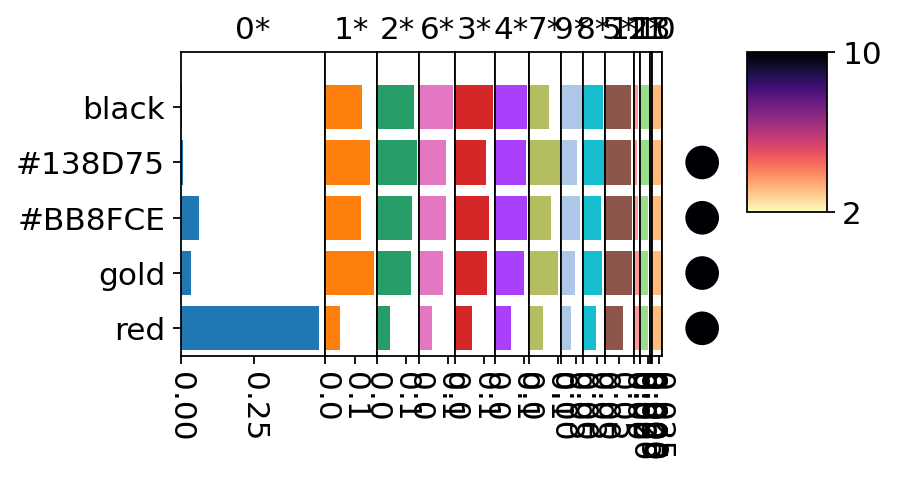

In [42]:
obs_split(adata,obs_of_interest='Cluster')
louv_res2=run_compositional_test(adata,
                          perturbations=['black', '#BB8FCE', 'gold', '#138D75', 'red'],
                          cluster_variable='louvain',
                          reference='black',
                          specific_order=['black', '#138D75','#BB8FCE', 'gold', 'red'][::-1],
                                figsize_multi=0.3)

plt.savefig(FIGS+'/'+PROTEIN+'.louvain_bars_bygroup.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.louvain_bars_bygroup.png',bbox_inches = "tight")

In [46]:
categories=adata.obs['guide.compact'].cat.categories

In [63]:
#assign the colors
new_colors=[]
for i in range(len(categories)):
    v=categories[i]
    cl=anno.loc[v,'Cluster']
    if cl=='black':
        if v=='WT':
            new_colors.append('black')
        else:
            new_colors.append('pink')
    elif v=='G12D':
        new_colors.append('darkred')
    else:
        new_colors.append('pink')


In [64]:
adata.uns['guide.compact_colors']=new_colors

0.3


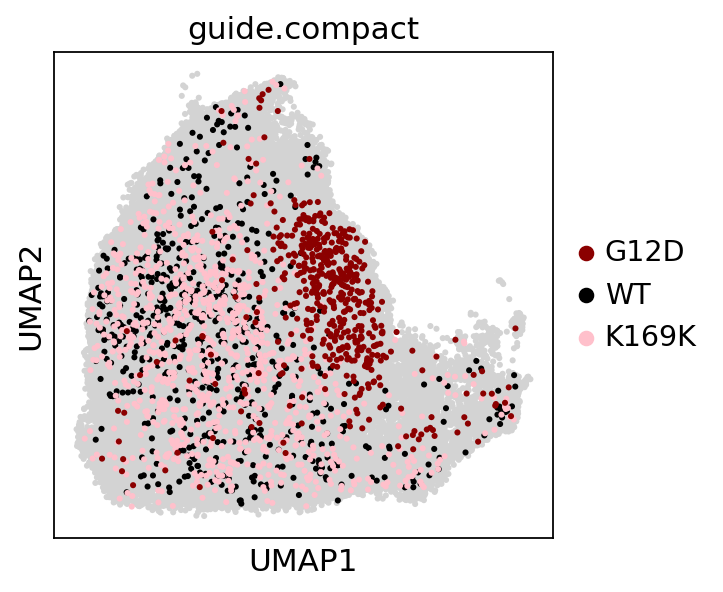

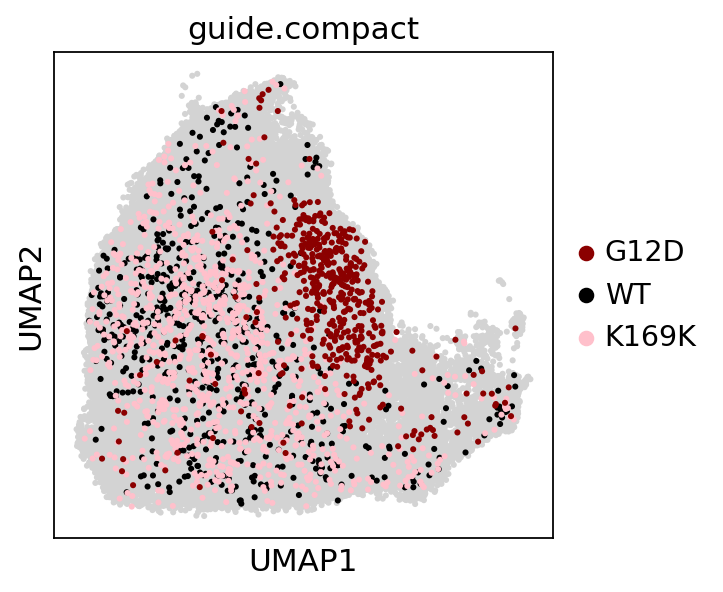

10.847457627118644


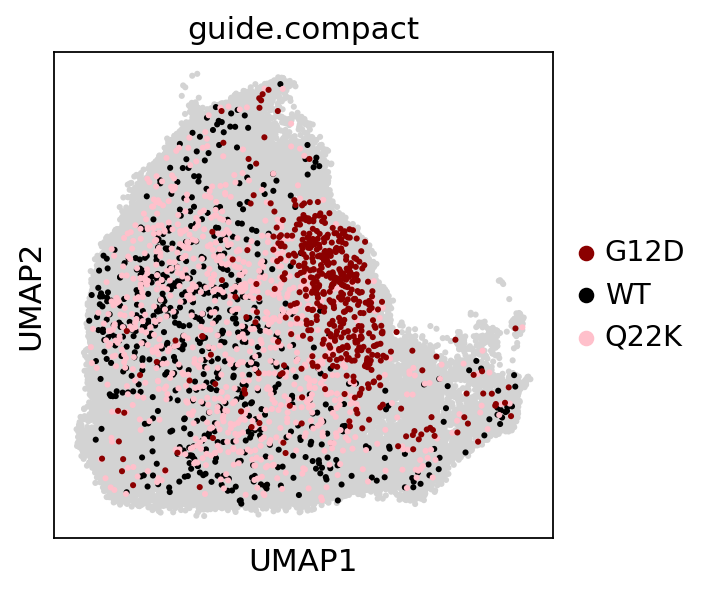

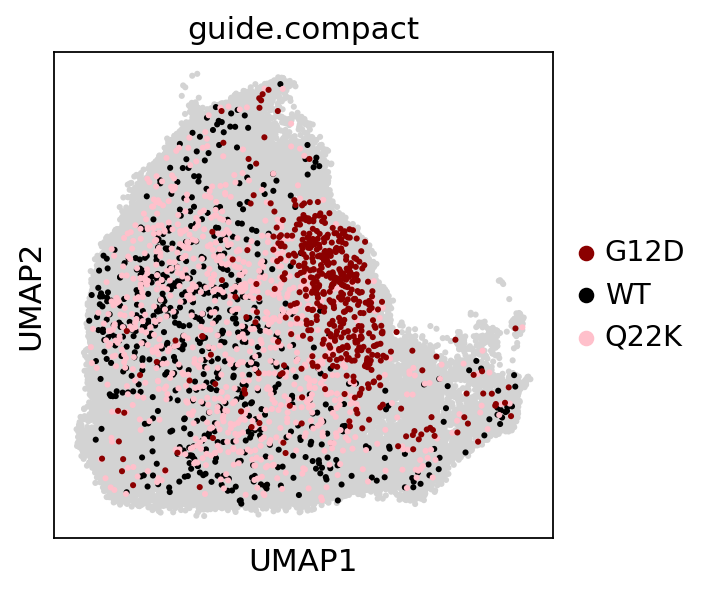

21.2


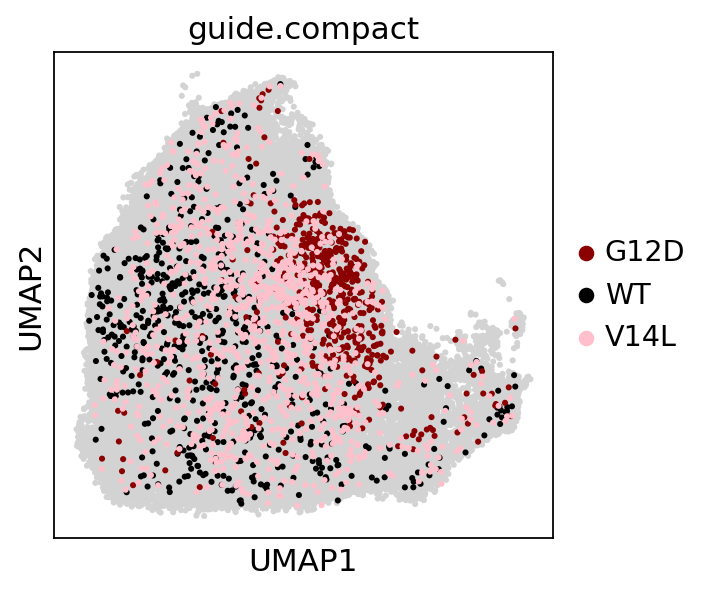

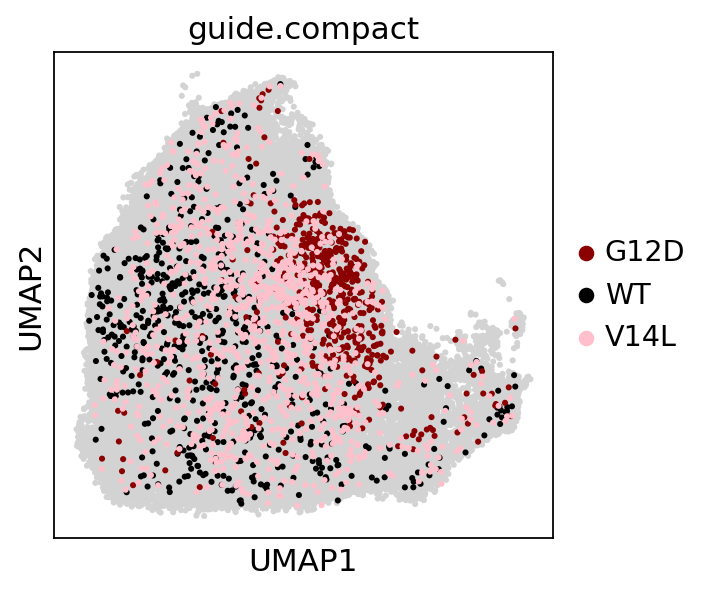

48.761408083441985


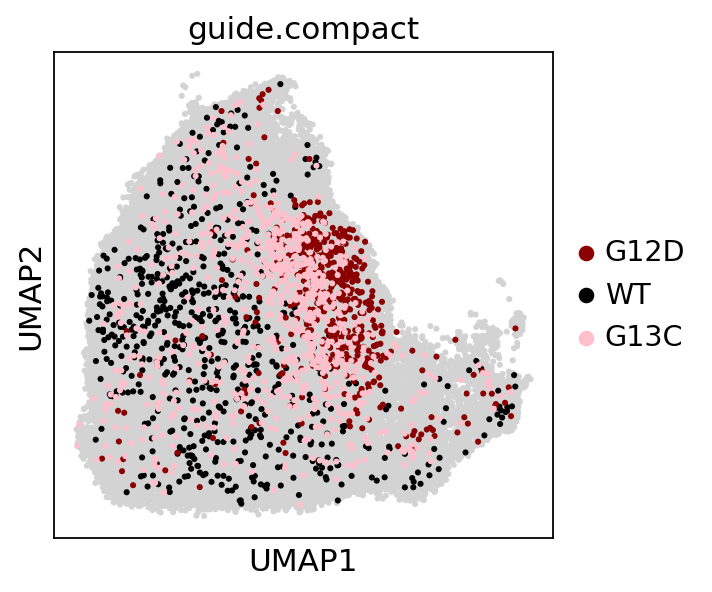

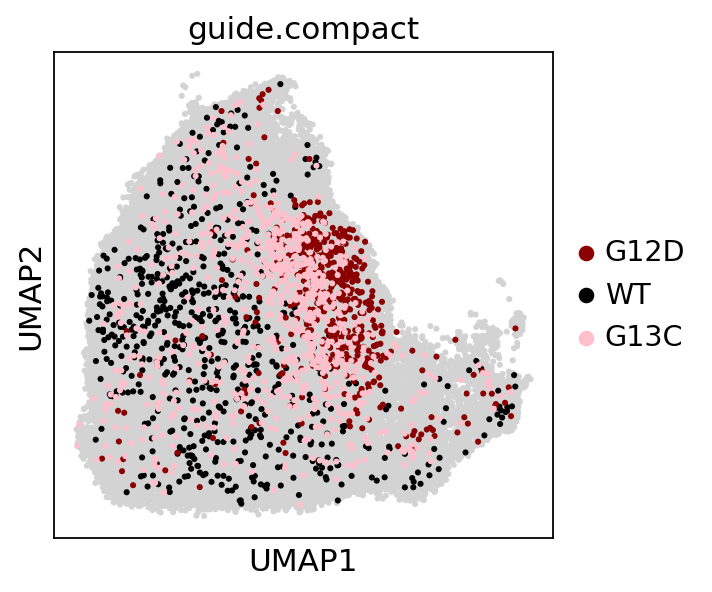

61.34094151212553


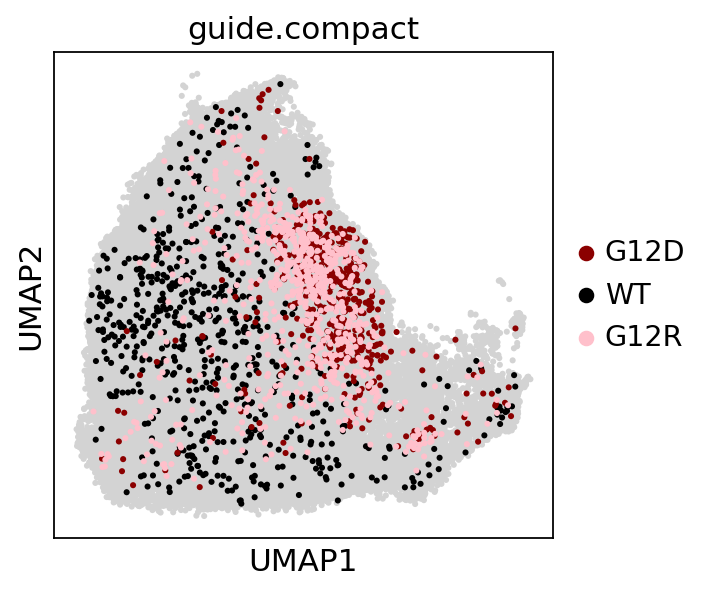

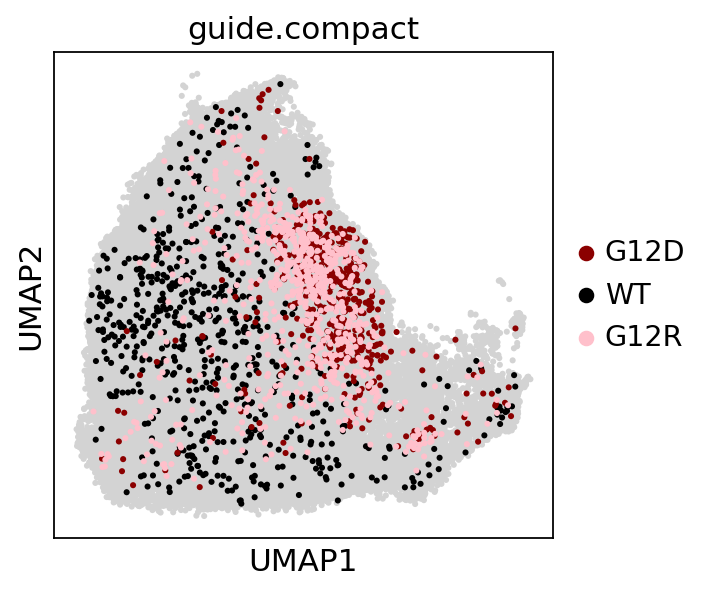

81.17469879518072


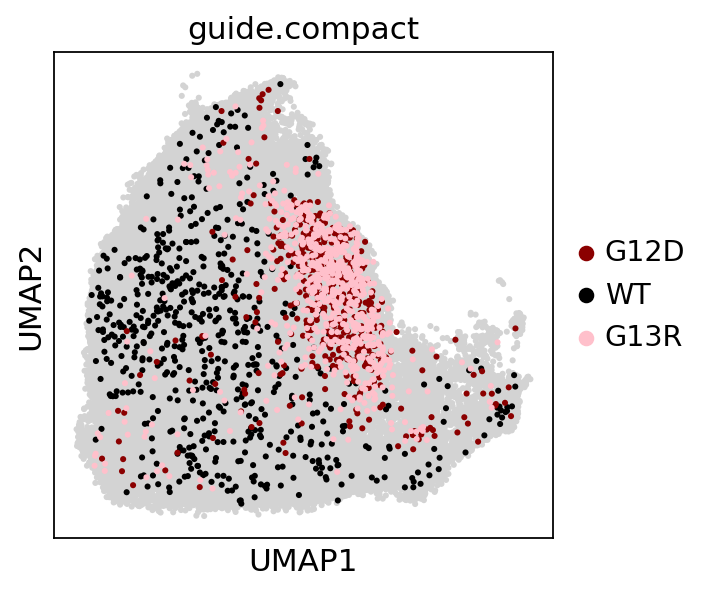

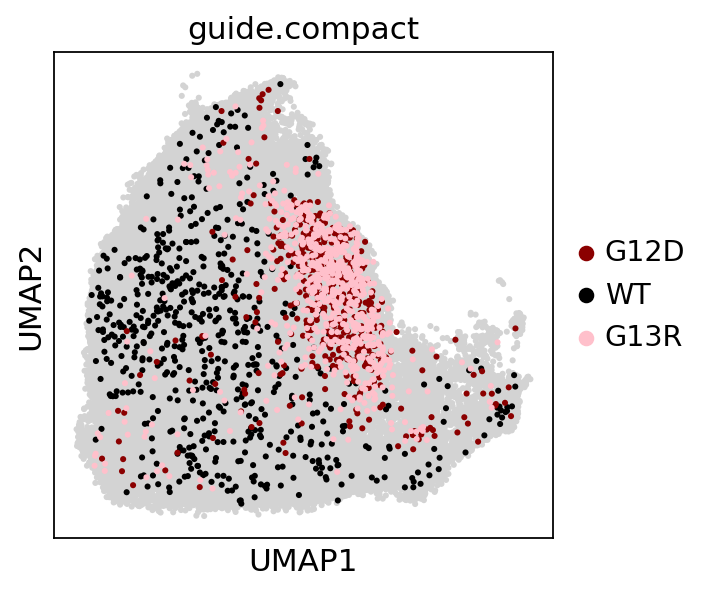

In [66]:
for variant in ['K169K','Q22K','V14L','G13C','G12R','G13R']:
    #get the percents
    print(100*adata[adata.obs['guide.compact']==variant,:].obs['louvain'].value_counts()[0]/adata[adata.obs['guide.compact']==variant,:].shape[0])
    sc.pl.umap(adata,color=['guide.compact'],groups=['G12D','WT',variant],
          s=30,save='gradient_'+variant+'.png')
    sc.pl.umap(adata,color=['guide.compact'],groups=['G12D','WT',variant],
          s=30,save='gradient_'+variant+'.pdf')

In [68]:
#corr louvain proportions with assays
#barplot with all the correlations

for assay in func_data.columns:
    louvs=set(adata.obs['louvain'])
    corr_assay=pd.DataFrame({'corr':0},index=louvs)
    for cl in louvs:
        from scipy.stats import spearmanr
        corres=spearmanr(louv_res['data.norm'].loc[sorted_variants,cl],
                   func_data.loc[sorted_variants,assay],nan_policy='omit')
        print(cl,corres)
        c=corres[0]
        corr_assay.loc[cl,'corr']=c

    corr_assay=corr_assay.sort_values(by='corr')

    #cluster colors
    categories=adata.obs['louvain'].cat.categories
    colors=pd.DataFrame({'cl':categories,'color':adata.uns['louvain_colors']},index=categories)
    print(colors)

    fig,plots=plt.subplots(1)
    fig.set_size_inches(4,4)
    plots.barh(corr_assay.index,corr_assay['corr'],color=colors.loc[corr_assay.index,'color'])
    plots.set_xlim(-1,1)
    plots.grid(False)
    plots.set_xlabel('Spearman correlation\n'+assay+' vs proportion cells in cluster')
    plots.set_ylabel('Louvain cluster')

    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'.png',bbox_inches = "tight")

NameError: name 'func_data' is not defined

3 SpearmanrResult(correlation=-0.5580345214008627, pvalue=5.1159643270354035e-09)
8 SpearmanrResult(correlation=-0.5607603583687328, pvalue=4.15210376886295e-09)
9 SpearmanrResult(correlation=-0.5221698015873811, pvalue=6.75108930597544e-08)
4 SpearmanrResult(correlation=-0.6135389088607006, pvalue=4.879718516319647e-11)
11 SpearmanrResult(correlation=-0.20900525994794977, pvalue=0.043212063691274304)
12 SpearmanrResult(correlation=0.5139821619060023, pvalue=1.1679554115870595e-07)
10 SpearmanrResult(correlation=-0.1822530011817752, pvalue=0.07872665781898922)
2 SpearmanrResult(correlation=-0.60143343845012, pvalue=1.453175917679776e-10)
1 SpearmanrResult(correlation=-0.5899348671827733, pvalue=3.930722076996199e-10)
13 SpearmanrResult(correlation=0.13033675566647, pvalue=0.21053240212790844)
7 SpearmanrResult(correlation=-0.5797599872508102, pvalue=9.183127155815879e-10)
6 SpearmanrResult(correlation=-0.5686190932233347, pvalue=2.250396917785274e-09)
0 SpearmanrResult(correlation=0.78

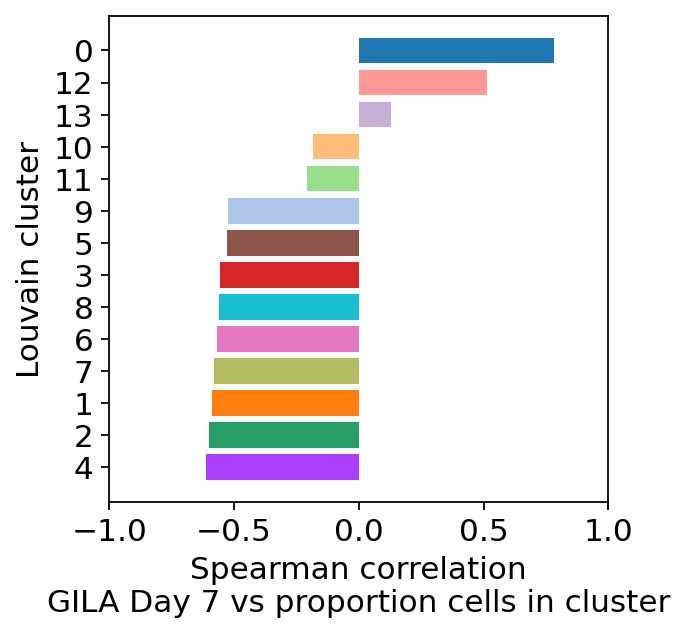

In [67]:
#corr louvain proportions with gila
#barplot with all the correlations
louvs=set(adata.obs['louvain'])
corrgila=pd.DataFrame({'corr':0},index=louvs)
for cl in louvs:
    from scipy.stats import spearmanr
    corres=spearmanr(louv_res['data.norm'].loc[sorted_variants,cl],
               anno.loc[sorted_variants,'Z-Low-D7'],nan_policy='omit')
    print(cl,corres)
    c=corres[0]
    corrgila.loc[cl,'corr']=c
 
print(corrgila)

corrgila=corrgila.sort_values(by='corr')

#cluster colors
categories=adata.obs['louvain'].cat.categories
colors=pd.DataFrame({'cl':categories,'color':adata.uns['louvain_colors']},index=categories)
print(colors)

fig,plots=plt.subplots(1)
fig.set_size_inches(4,4)
plots.barh(corrgila.index,corrgila['corr'],color=colors.loc[corrgila.index,'color'])
plots.set_xlim(-1,1)
plots.grid(False)
plots.set_xlabel('Spearman correlation\nGILA Day 7 vs proportion cells in cluster')
plots.set_ylabel('Louvain cluster')

plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_gila.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_gila.png',bbox_inches = "tight")

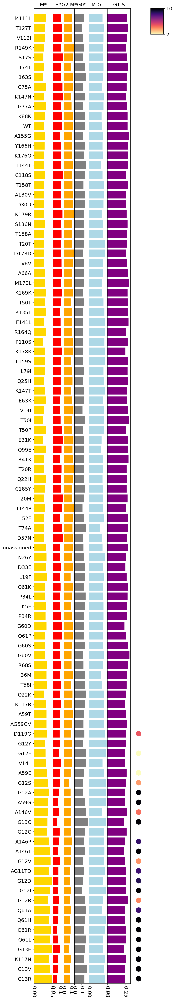

In [75]:
ccycle_res=run_compositional_test(adata,
                          perturbations=sorted_variants,
                          cluster_variable='phase.multi',
                          reference='WT',
                          specific_order=sorted_variants[::-1],figsize_multi=0.8)

plt.savefig(FIGS+'/'+PROTEIN+'.ccycle_bars.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.ccycle_bars.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


                  red   #138D75      gold   #BB8FCE         black
red      1.000000e+00  0.000001  0.000757  0.081442  3.990272e-09
#138D75  1.242273e-06  1.000000  0.103723  0.260525  8.144219e-02
gold     7.569013e-04  0.103723  1.000000  0.953086  9.530861e-01
#BB8FCE  8.144219e-02  0.260525  0.953086  1.000000  8.446969e-01
black    3.990272e-09  0.081442  0.953086  0.844697  1.000000e+00


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #138D75: t-test independent samples with Bonferroni correction, P_val=1.298e-01 stat=-2.198e+00
black v.s. #BB8FCE: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=6.167e-01
black v.s. gold: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=3.039e-01
black v.s. red: t-test independent samples with Bonferroni correction, P_val=1.277e-09 stat=7.308e+00
                  red   #138D75      gold   #BB8FCE         black
red      1.000000e+00  0.000002  0.000420  0.065523  2.197471e-15
#138D75  1.941639e-06  1.000000  0.047636  0.010974  1.000000e+00
gold     4.199993e-04  0.047636  1.000000  0.191518  1.097365e-02
#BB8FCE  6.552289e-02  0.010974  0.191518  1.000000  4.445689e-03
black    2.197471e-15  1.000000  0.010974  0.004446  1.000000e+00


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #138D75: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=-2.530e-01
black v.s. #BB8FCE: t-test independent samples with Bonferroni correction, P_val=5.690e-03 stat=-3.405e+00
black v.s. gold: t-test independent samples with Bonferroni correction, P_val=2.107e-02 stat=-2.918e+00
black v.s. red: t-test independent samples with Bonferroni correction, P_val=7.032e-16 stat=-1.071e+01
                  red   #138D75      gold   #BB8FCE         black
red      1.000000e+00  0.000006  0.000219  0.222632  3.975097e-11
#138D75  5.771462e-06  1.000000  1.000000  0.222632  1.000000e+00
gold     2.189862e-04  1.000000  1.000000  0.482946  1.000000e+00
#BB8FCE  2.226322e-01  0.222632  0.482946  1.000000  1.476143e-01
black    3.975097e-11  1.000000  1.000000  0.147614  1.000000e+00
p-value annotation 

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


              red   #138D75      gold   #BB8FCE     black
red      1.000000  0.001462  0.013166  0.431337  0.005470
#138D75  0.001462  1.000000  0.418851  0.301748  0.037982
gold     0.013166  0.418851  1.000000  0.416211  0.416211
#BB8FCE  0.431337  0.301748  0.416211  1.000000  0.843920
black    0.005470  0.037982  0.416211  0.843920  1.000000
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #138D75: t-test independent samples with Bonferroni correction, P_val=4.862e-02 stat=2.598e+00
black v.s. #BB8FCE: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=-4.219e-01
black v.s. gold: t-test independent samples with Bonferroni correction, P_val=8.799e-01 stat=1.242e+00
black v.s. red: t-test independent samples with Bonferroni correction, P_val=3.501e-03 stat=-3.475e+00


/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


                  red       #138D75      gold   #BB8FCE         black
red      1.000000e+00  1.509240e-07  0.001194  0.039051  4.357291e-15
#138D75  1.509240e-07  1.000000e+00  0.039051  0.041804  3.403171e-01
gold     1.194164e-03  3.905079e-02  1.000000  0.895071  3.412505e-02
#BB8FCE  3.905079e-02  4.180409e-02  0.895071  1.000000  3.905079e-02
black    4.357291e-15  3.403171e-01  0.034125  0.039051  1.000000e+00
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #138D75: t-test independent samples with Bonferroni correction, P_val=9.801e-01 stat=-1.176e+00
black v.s. #BB8FCE: t-test independent samples with Bonferroni correction, P_val=6.965e-02 stat=2.471e+00
black v.s. gold: t-test independent samples with Bonferroni correction, P_val=4.368e-02 stat=2.644e+00
black v.s. red: t-test independent samples with Bonferroni correction, P_val=1.394e-15 stat=1.055e+0

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]


              red   #138D75      gold   #BB8FCE     black
red      1.000000  0.485204  0.918566  0.949997  0.026391
#138D75  0.485204  1.000000  0.960972  1.000000  1.000000
gold     0.918566  0.960972  1.000000  1.000000  0.918566
#BB8FCE  0.949997  1.000000  1.000000  1.000000  1.000000
black    0.026391  1.000000  0.918566  1.000000  1.000000
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

black v.s. #138D75: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=-2.443e-01
black v.s. #BB8FCE: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=-4.991e-01
black v.s. gold: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=-1.156e+00
black v.s. red: t-test independent samples with Bonferroni correction, P_val=8.445e-03 stat=-3.191e+00


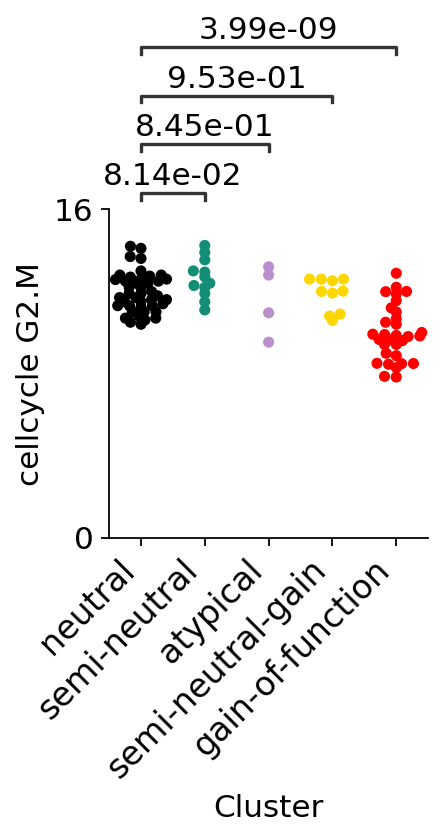

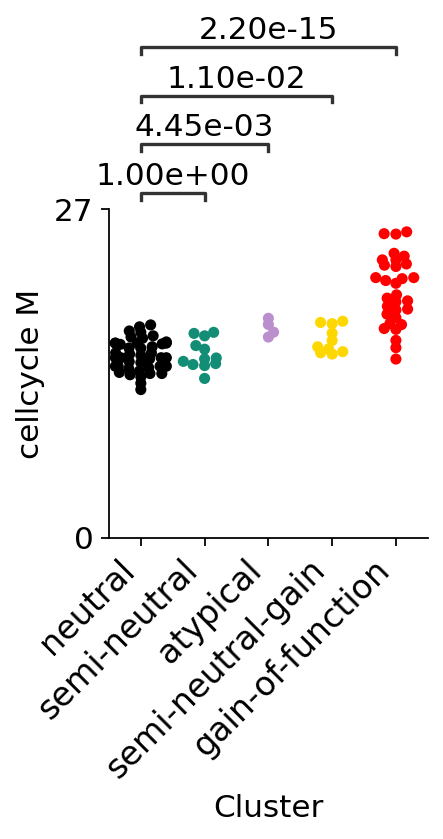

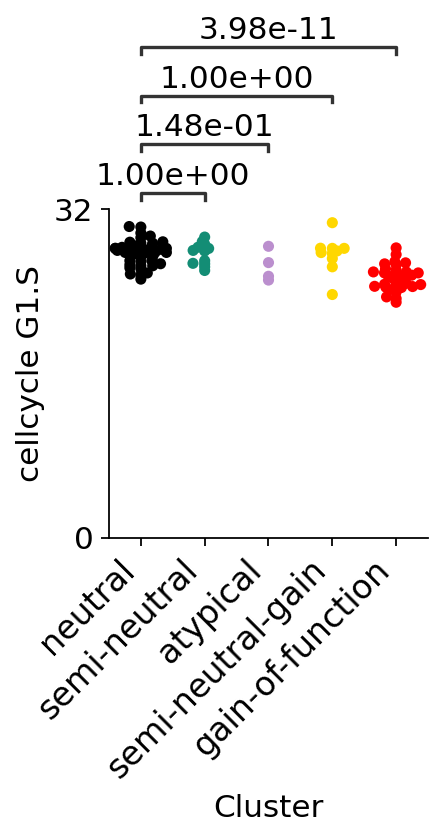

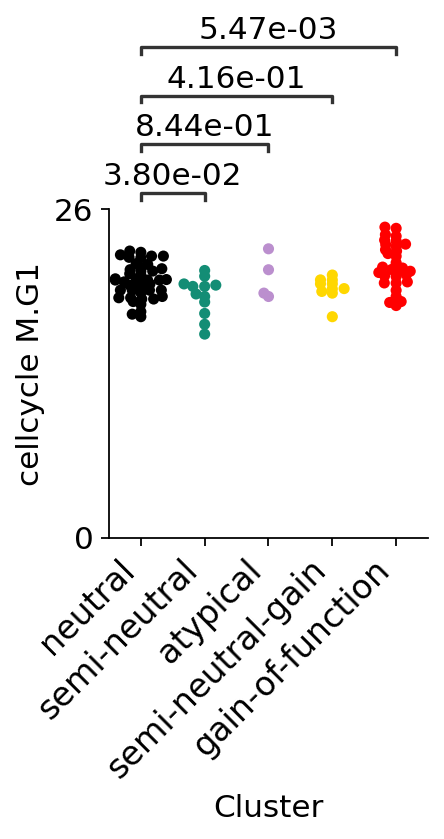

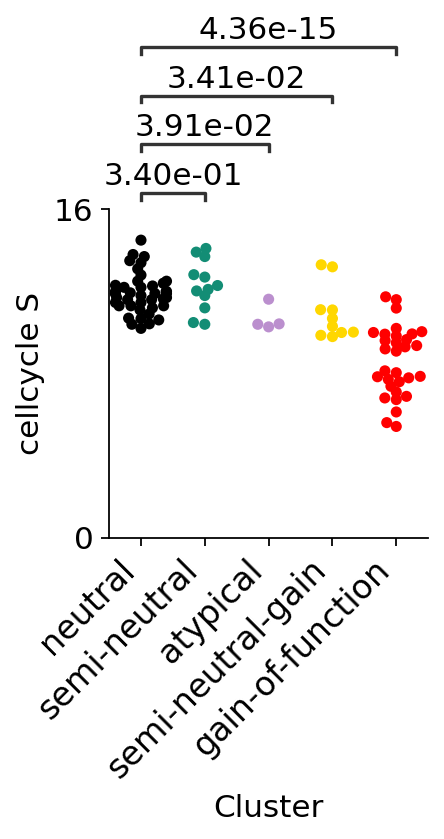

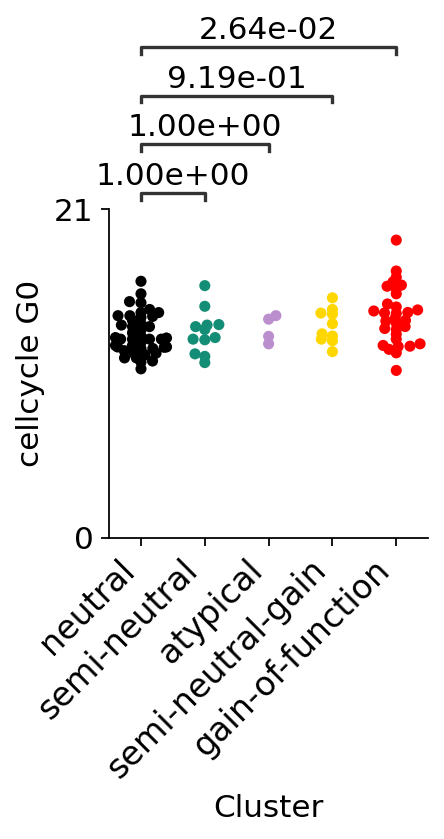

In [78]:
import seaborn as sns
from statannot import add_stat_annotation


def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)



for cc in set(adata.obs['phase.multi']):
    anno['cellcycle '+cc]=100*ccycle_res['data.norm'].loc[anno.index,cc]

    mypal={}
    for c in set(anno['Cluster']):
        mypal[c]=c
        
    df=pd.DataFrame({'condition':anno.loc[anno['Cluster'].isin(['black','#138D75','#BB8FCE','gold','red']),'Cluster'],
                'value':anno.loc[anno['Cluster'].isin(['black','#138D75','#BB8FCE','gold','red']),'cellcycle '+cc]})

    condition='condition'
    value='value'
    conditions=set(df[condition])
    pval_m=pairwise_ttests(df,'condition','value')
    print(pval_m)

    g =sns.catplot(x="Cluster", y='cellcycle '+cc, hue='Cluster',
                   data=anno,palette=mypal,
                  order=['black','#138D75','#BB8FCE','gold','red'],
                  height=3, # make the plot 5 units high
                    aspect=1,legend=False,kind='swarm')
    ax1 = g.axes[0,0]
    ax1.set_yticks([0,int(np.max(anno['cellcycle '+cc]))+2])
    
    ax1.grid(False)
    
    
    test_results = add_stat_annotation(ax1, data=anno, x="Cluster", y='cellcycle '+cc, 
                                       order=['black','#138D75','#BB8FCE','gold','red'],
                                       #hue='Cluster',
                                   box_pairs=[('black','#138D75'),
                                             ("black","#BB8FCE"),('black','gold'),
                                             ('black','red')],
                                   test='t-test_ind', #text_format='full',
                                   text_annot_custom=[
                                                     '{:0.2e}'.format(pval_m.loc['black','#138D75']),
                                                     '{:0.2e}'.format(pval_m.loc["black","#BB8FCE"]),
                                                      '{:0.2e}'.format(pval_m.loc["black","gold"]),
                                                      '{:0.2e}'.format(pval_m.loc["black","red"]),
                                                     ],
                                   loc='outside', verbose=2)
    
    ax1.set_xticklabels(['neutral','semi-neutral',
                         'atypical',
                         'semi-neutral-gain',
                        'gain-of-function'],
                        rotation=45,fontsize=15,
                       ha='right')

    plt.savefig(FIGS+'/'+PROTEIN+'.'+'cellcycle'+cc+'_swarm.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.'+'cellcycle'+cc+'_swarm.png',bbox_inches = "tight") 

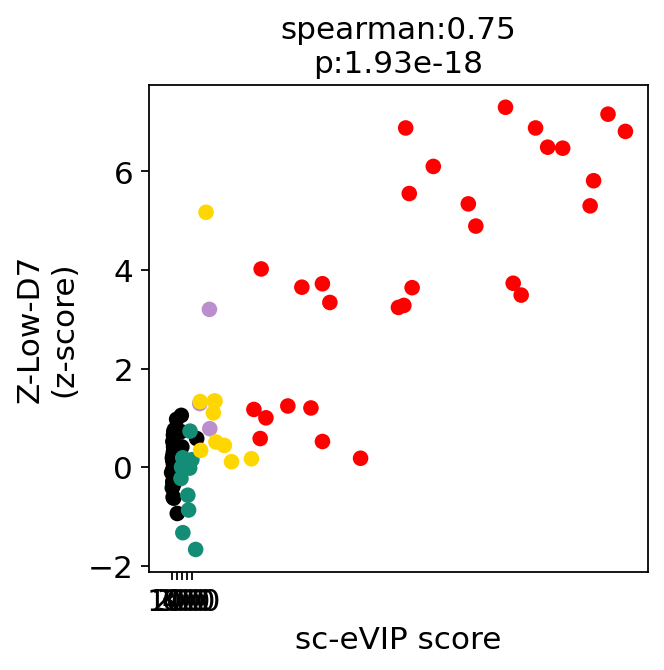

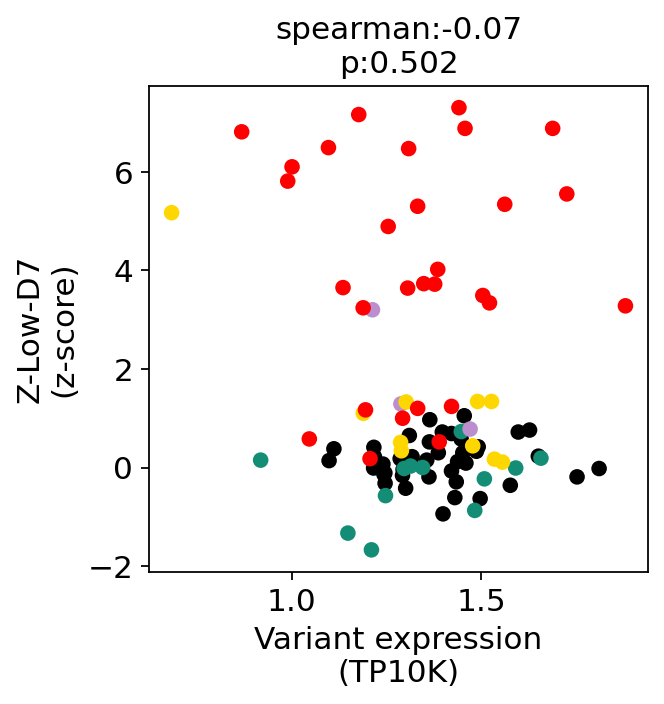

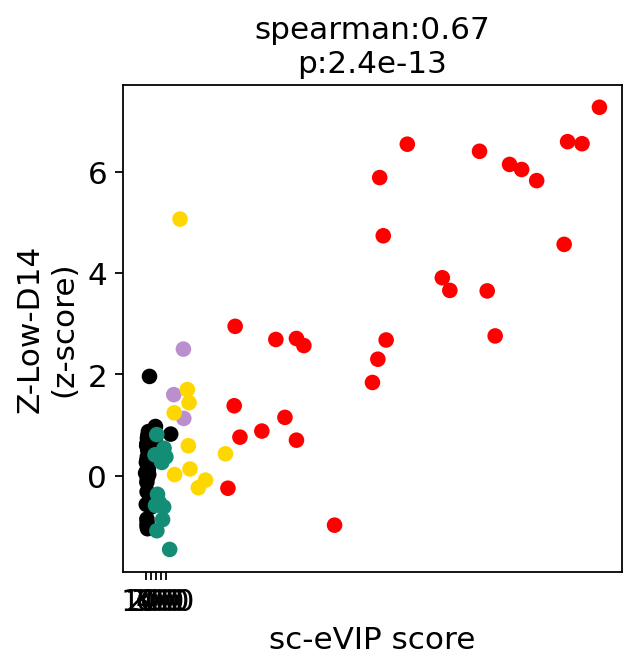

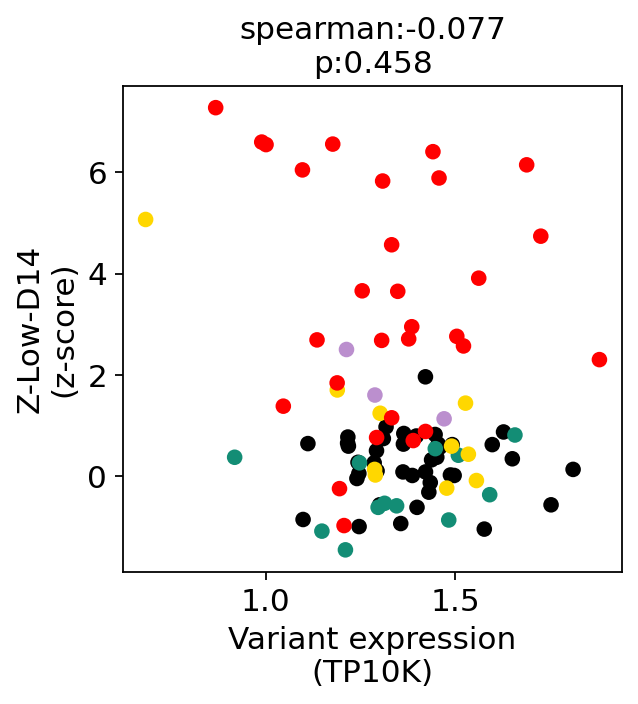

In [79]:

for assay in func_data.columns:
    
    fun_scatter(anno.loc[sorted_variants,score],
                 func_data.loc[sorted_variants,assay],
                 color=anno.loc[sorted_variants,'cluster_color'])

    plt.grid(False)
    plt.xlabel('sc-eVIP score')
    plt.ylabel(assay+'\n(z-score)')

    plt.xticks([0,100,200,300,400])

    plt.savefig(FIGS+'/'+PROTEIN+'func_scatter_'+assay+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'func_scatter_'+assay+'.png',bbox_inches = "tight")
    
    fun_scatter(anno.loc[sorted_variants,'variant_expression'],
                 func_data.loc[sorted_variants,assay],
                 color=anno.loc[sorted_variants,'cluster_color'])

    plt.grid(False)
    plt.xlabel('Variant expression\n(TP10K)')
    plt.ylabel(assay+'\n(z-score)')
    plt.savefig(FIGS+'/'+PROTEIN+'func_vs_expr_'+assay+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'func_vs_expr_'+assay+'.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]
/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return getattr(section, self.name)[new_key]
/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1017: FutureWarning: 
Passing list-likes to .loc or [] with any mi

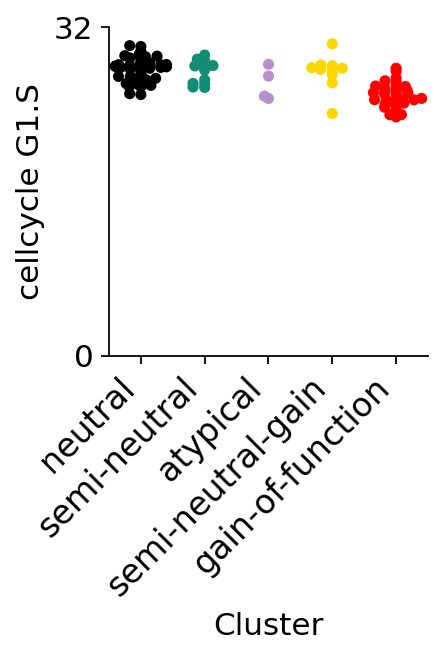

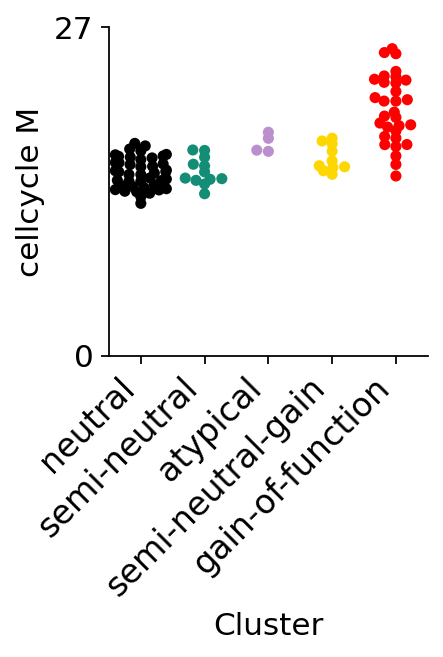

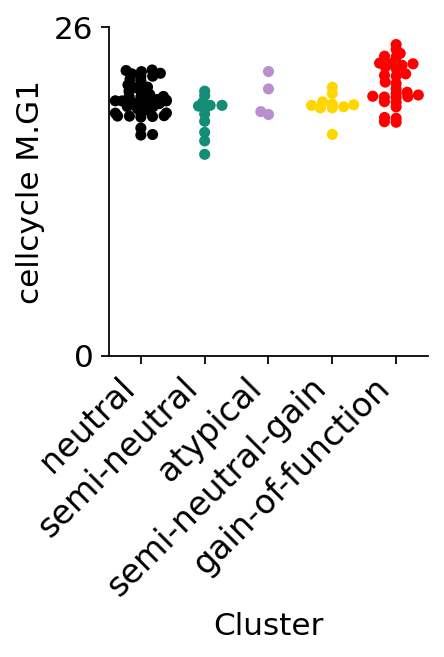

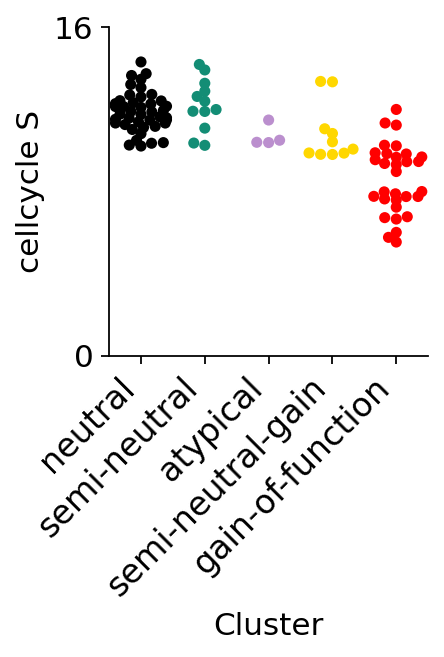

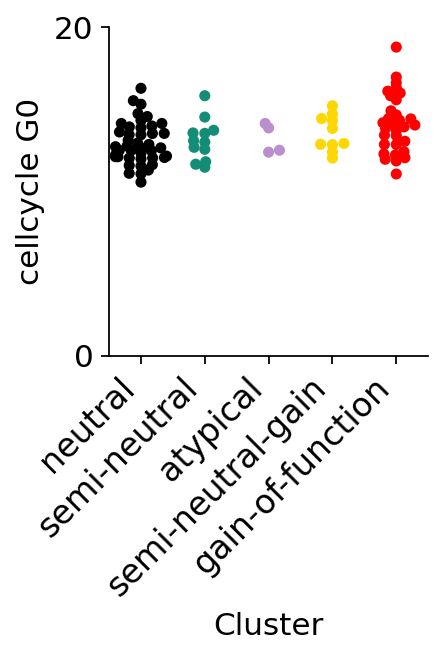

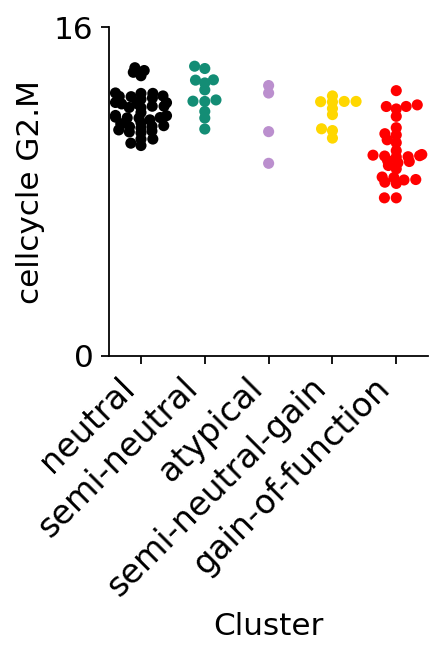

In [169]:
for cc in set(adata.obs['phase.multi']):
    anno['cellcycle '+cc]=100*ccycle_res['data.norm'].loc[anno.index,cc]

    mypal={}
    for c in set(anno['Cluster']):
        mypal[c]=c

    g =sns.catplot(x="Cluster", y='cellcycle '+cc, hue='Cluster',
                   data=anno,palette=mypal,
                  order=['black','#138D75','#BB8FCE','gold','red'],
                  height=3, # make the plot 5 units high
                    aspect=1,legend=False,kind='swarm')
    ax1 = g.axes[0,0]
    g.set(yticks=[0,int(np.max(anno['cellcycle '+cc]))+2])
    ax1.set_xticklabels(['neutral','semi-neutral','atypical','semi-neutral-gain','gain-of-function'],
                        rotation=45,fontsize=15,
                       ha='right')
    plt.grid(False)

    plt.savefig(FIGS+'/'+PROTEIN+'.'+'cellcycle'+cc+'_swarm.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.'+'cellcycle'+cc+'_swarm.png',bbox_inches = "tight") 

In [175]:
def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)

cc='M'
df=pd.DataFrame({'condition':anno.loc[sorted_variants,'Cluster'],
                'value':anno.loc[sorted_variants,'cellcycle '+cc]})
condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)

cc='S'
df=pd.DataFrame({'condition':anno.loc[sorted_variants,'Cluster'],
                'value':anno.loc[sorted_variants,'cellcycle '+cc]})
condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)

             gold         black           red   #138D75   #BB8FCE
gold     1.000000  1.564344e-02  2.874203e-04  0.062307  0.088962
black    0.015643  1.000000e+00  1.305541e-15  0.963394  0.001355
red      0.000287  1.305541e-15  1.000000e+00  0.000002  0.086878
#138D75  0.062307  9.633939e-01  1.645906e-06  1.000000  0.005173
#BB8FCE  0.088962  1.354947e-03  8.687805e-02  0.005173  1.000000
             gold         black           red       #138D75   #BB8FCE
gold     1.000000  2.143278e-02  2.080753e-03  4.141631e-02  1.000000
black    0.021433  1.000000e+00  4.497038e-15  4.398910e-01  0.041416
red      0.002081  4.497038e-15  1.000000e+00  2.205496e-07  0.041416
#138D75  0.041416  4.398910e-01  2.205496e-07  1.000000e+00  0.053954
#BB8FCE  1.000000  4.141631e-02  4.141631e-02  5.395422e-02  1.000000


Classifier
==

In [177]:
adata3=perturb.pp.subsample_cells(adata,3000,'Cluster')
adata3=adata3[adata3.obs['Cluster'].isin(['black', '#BB8FCE', 'gold', '#138D75', 'red']),:]
print(adata3)

View of AnnData object with n_obs × n_vars = 15000 × 1145 
    obs: 'batch', 'known', 'n_counts', 'n_genes', 'percent_mito', 'n_counts_downsampled', 'n_counts_original', 'vbc.counts', 'batch_num4', 'batch_num7', 'batch_num11', 'batch_num8', 'batch_num13', 'batch_num23', 'batch_num9', 'batch_num2', 'batch_num24', 'batch_num10', 'batch_num12', 'batch_num16', 'batch_num20', 'batch_num18', 'batch_num25', 'batch_num31', 'batch_num28', 'batch_num5', 'batch_num14', 'batch_num15', 'batch_num29', 'batch_num3', 'batch_num6', 'batch_num22', 'batch_num26', 'batch_num17', 'batch_num27', 'batch_num1', 'batch_num19', 'batch_num21', 'batch_num0', 'batch_num30', 'louvain', 'G1.S', 'G2.M', 'M', 'M.G1', 'S', 'phase.multi', 'guide', 'guide.compact', 'A146P', 'K117R', 'Y166H', 'K169K', 'K178K', 'T50P', 'A146V', 'L52F', 'K176Q', 'A155G', 'G60D', 'T158T', 'K88K', 'D119G', 'L159S', 'G13V', 'Q61P', 'D33E', 'S136N', 'K179R', 'T74T', 'G60S', 'Q99E', 'G13R', 'G12D', 'R164Q', 'I36M', 'C185Y', 'I163S', 'P34R', 'G60

(array([3000.,    0., 3000.,    0.,    0., 3000.,    0., 3000.,    0.,
        3000.]),
 array([0. , 0.4, 0.8, 1.2, 1.6, 2. , 2.4, 2.8, 3.2, 3.6, 4. ]),
 <a list of 10 Patch objects>)

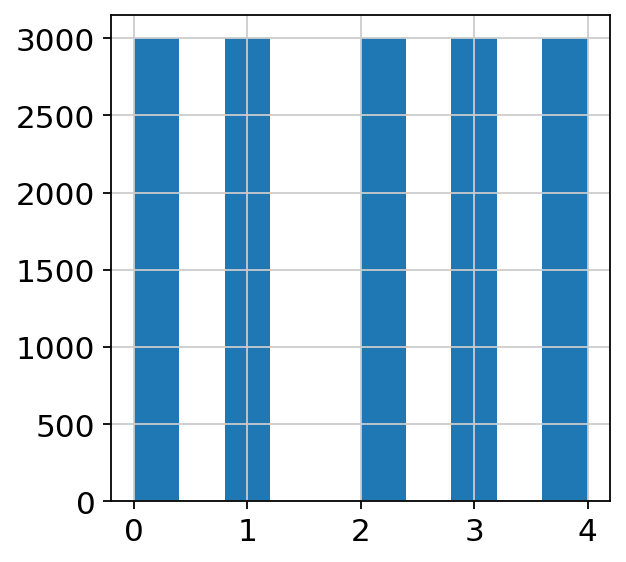

In [179]:
#X = expression
X=pd.DataFrame(adata3.X,index=adata3.obs_names,columns=adata3.var_names)

#y=variant class
variant_mapping={'black':0,'#138D75':1,'#BB8FCE':2,'gold':3,'red':4}
y=[]
for i in range(len(adata3.obs_names)):
    var_group=variant_mapping[adata3.obs['Cluster'][i]]
    y.append(var_group)
plt.hist(y)

In [180]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.5)

In [181]:
from sklearn.datasets import make_gaussian_quantiles
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from sklearn.linear_model import LogisticRegression


clf = LogisticRegression(random_state=0, multi_class='multinomial',
                         class_weight='balanced',
                        max_iter=500)
clf.fit(X_train, y_train)

#predict===================
pred_valid=clf.predict(X_valid)
pred_train=clf.predict(X_train)
print(pred_valid.shape)

(7500,)


Confusion matrix, without normalization
[[1134  178  134   76   18]
 [ 166  992  115  164   25]
 [ 174  137  901  164  129]
 [  92  165  180 1013   60]
 [  14   22   86   61 1300]]
Normalized confusion matrix
[[0.73636364 0.11558442 0.08701299 0.04935065 0.01168831]
 [0.11354309 0.67852257 0.07865937 0.1121751  0.01709986]
 [0.11561462 0.0910299  0.5986711  0.1089701  0.08571429]
 [0.06092715 0.10927152 0.1192053  0.67086093 0.0397351 ]
 [0.00944032 0.01483479 0.05799056 0.04113284 0.87660148]]
Confusion matrix, without normalization
[[666 356 259 123  56]
 [347 545 220 348  78]
 [311 220 417 276 271]
 [191 300 316 482 201]
 [ 48  32 281 190 966]]
Normalized confusion matrix
[[0.45616438 0.24383562 0.17739726 0.08424658 0.03835616]
 [0.22561769 0.35435631 0.14304291 0.22626788 0.05071521]
 [0.20802676 0.14715719 0.27892977 0.18461538 0.1812709 ]
 [0.12818792 0.20134228 0.21208054 0.32348993 0.13489933]
 [0.0316414  0.02109426 0.18523401 0.1252472  0.63678312]]


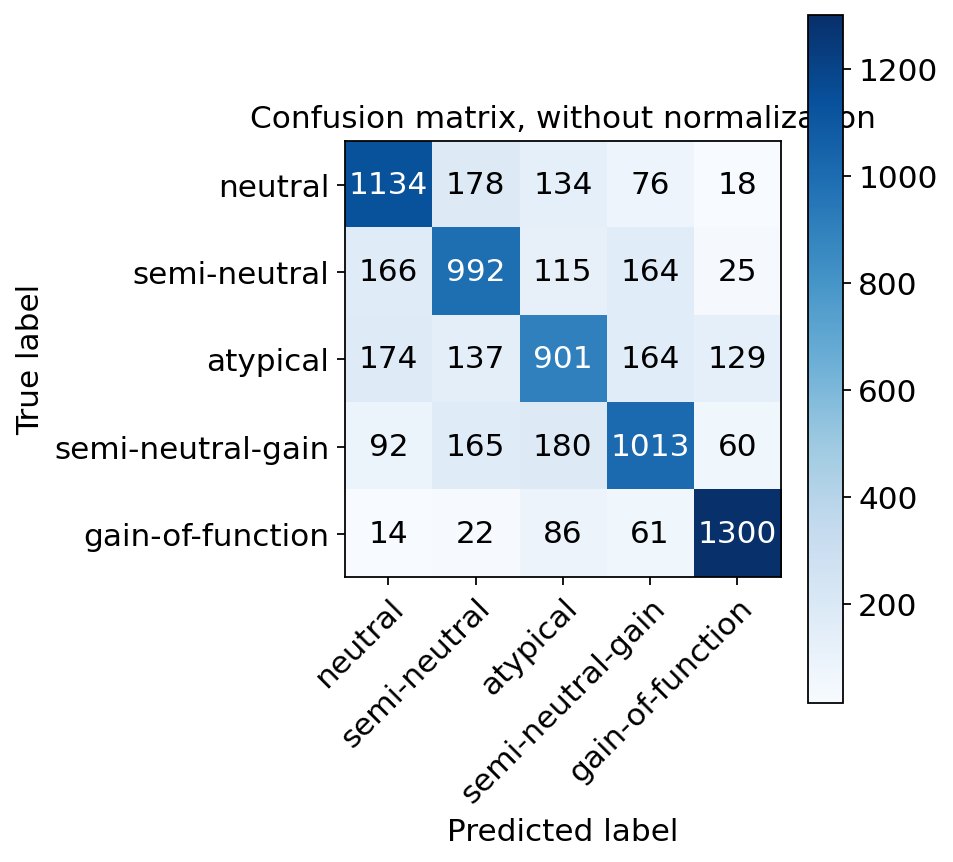

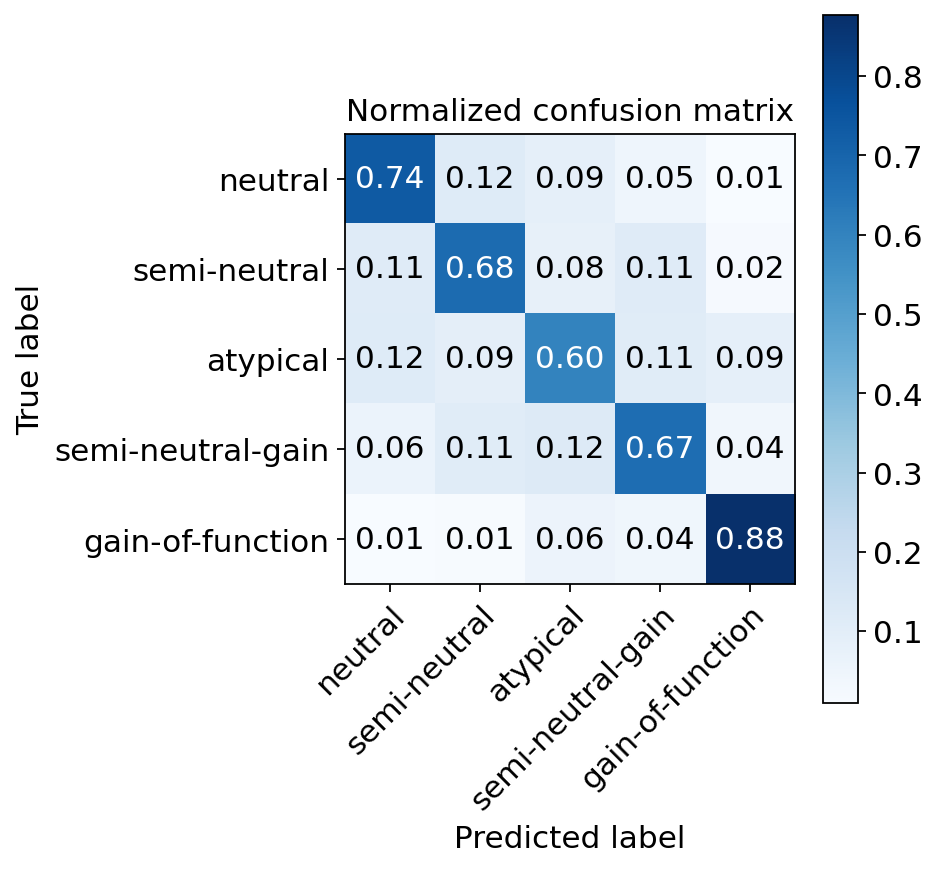

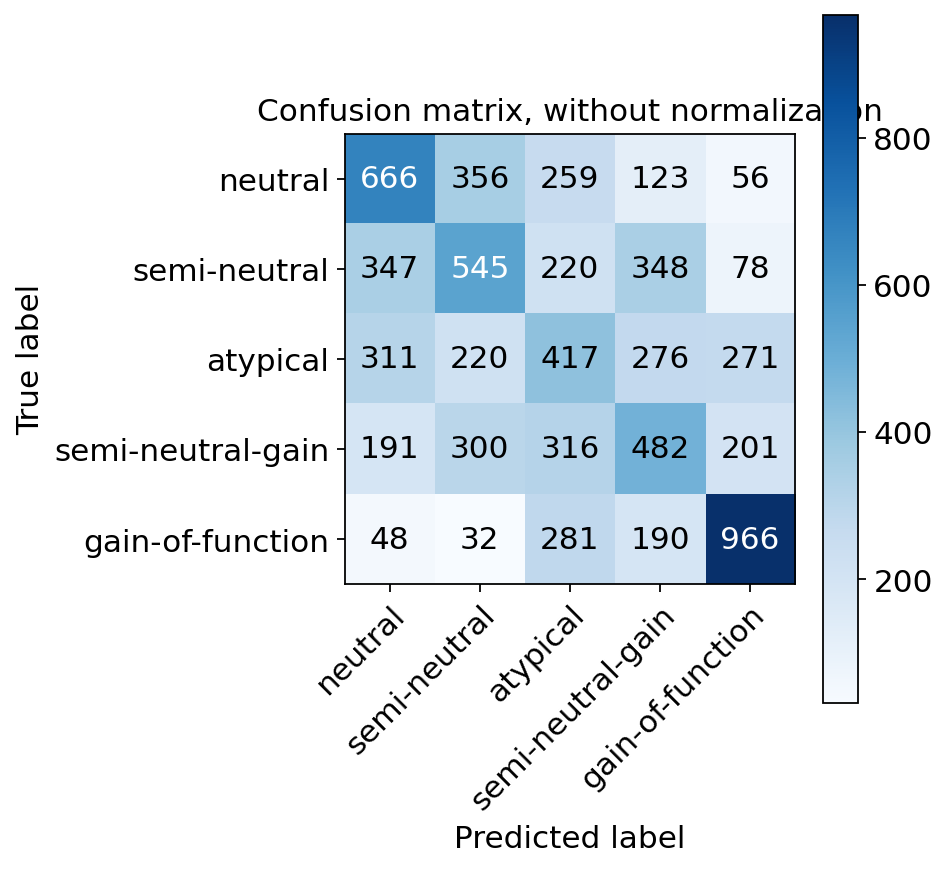

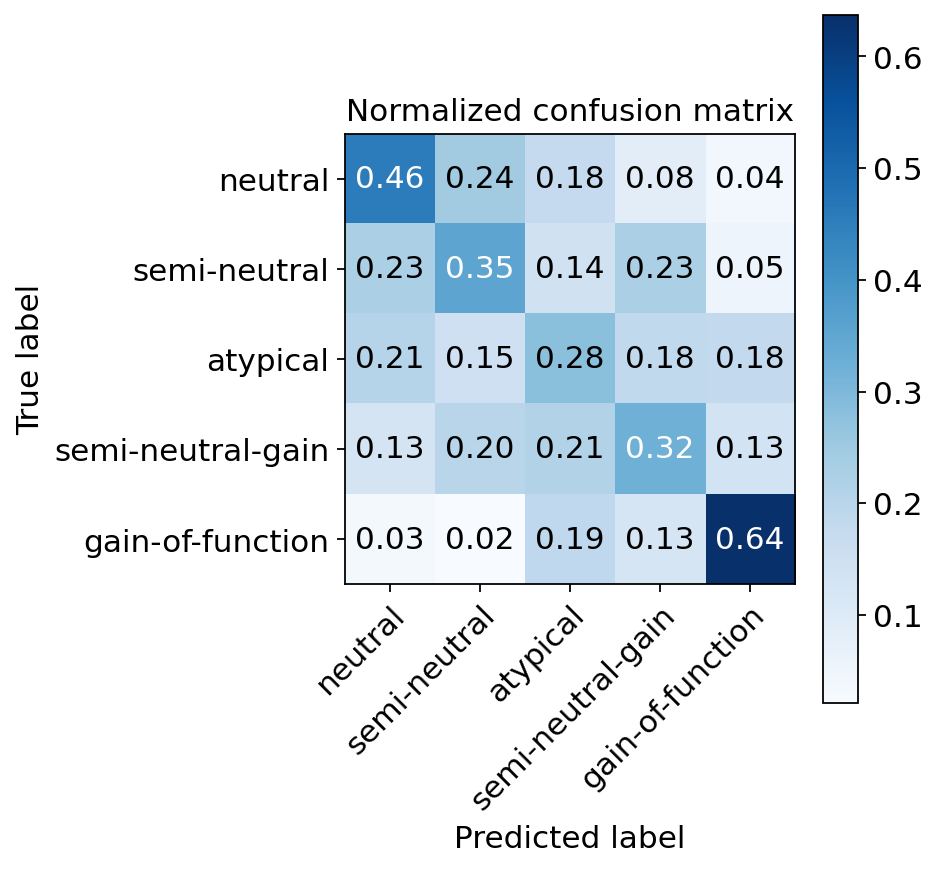

In [229]:
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes#classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    fig.set_size_inches(6,6)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')
    ax.grid(False)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

classes=['neutral','semi-neutral','atypical','semi-neutral-gain','gain-of-function']
plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes)

plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes,normalize=True)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes)

plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes,normalize=True)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat.png',bbox_inches = "tight")

In [187]:
#look at error by louvain
errors=pd.DataFrame({'louvain':adata[X_valid.index,:].obs['louvain'],
                    'pred':pred_valid,
                    'true':y_valid})
errors['error']=errors['pred']!=errors['true']

In [204]:
error_table=pd.DataFrame(0.0,index=list(set(errors['louvain'])),
                         columns=classes)

for louv in set(errors['louvain']):
    for vclass in set(errors['true']):
        error_here=errors.loc[errors['louvain']==louv,:]
        error_here=error_here.loc[error_here['true']==vclass,'error']
        error_counts=error_here.value_counts()
        print('Louvain',louv,'class',classes[vclass],'error',error_counts[True]/error_counts.sum())
        error_table.loc[louv,classes[vclass]]=error_counts[True]/error_counts.sum()

Louvain 2 class neutral error 0.5652173913043478
Louvain 2 class semi-neutral error 0.6371681415929203
Louvain 2 class atypical error 0.7653631284916201
Louvain 2 class semi-neutral-gain error 0.6794871794871795
Louvain 2 class gain-of-function error 0.6666666666666666
Louvain 12 class neutral error 0.6875
Louvain 12 class semi-neutral error 0.75
Louvain 12 class atypical error 0.6842105263157895
Louvain 12 class semi-neutral-gain error 0.6428571428571429
Louvain 12 class gain-of-function error 0.631578947368421
Louvain 0 class neutral error 0.6666666666666666
Louvain 0 class semi-neutral error 1.0
Louvain 0 class atypical error 0.788235294117647
Louvain 0 class semi-neutral-gain error 0.6724137931034483
Louvain 0 class gain-of-function error 0.17166212534059946
Louvain 3 class neutral error 0.5077720207253886
Louvain 3 class semi-neutral error 0.6060606060606061
Louvain 3 class atypical error 0.7090909090909091
Louvain 3 class semi-neutral-gain error 0.6964285714285714
Louvain 3 class

In [205]:
error_table

,neutral,semi-neutral,atypical,semi-neutral-gain,gain-of-function
2,0.565217,0.637168,0.765363,0.679487,0.666667
12,0.687500,0.750000,0.684211,0.642857,0.631579
0,0.666667,1.000000,0.788235,0.672414,0.171662
3,0.507772,0.606061,0.709091,0.696429,0.565657
10,0.644444,0.650794,0.892857,0.722222,0.416667
13,0.875000,0.857143,0.777778,0.500000,0.333333
1,0.536723,0.684211,0.708108,0.625442,0.674419
7,0.587156,0.555556,0.807692,0.678322,0.388060
4,0.559006,0.662791,0.578947,0.675862,0.587500
5,0.538462,0.645390,0.698113,0.652482,0.488889


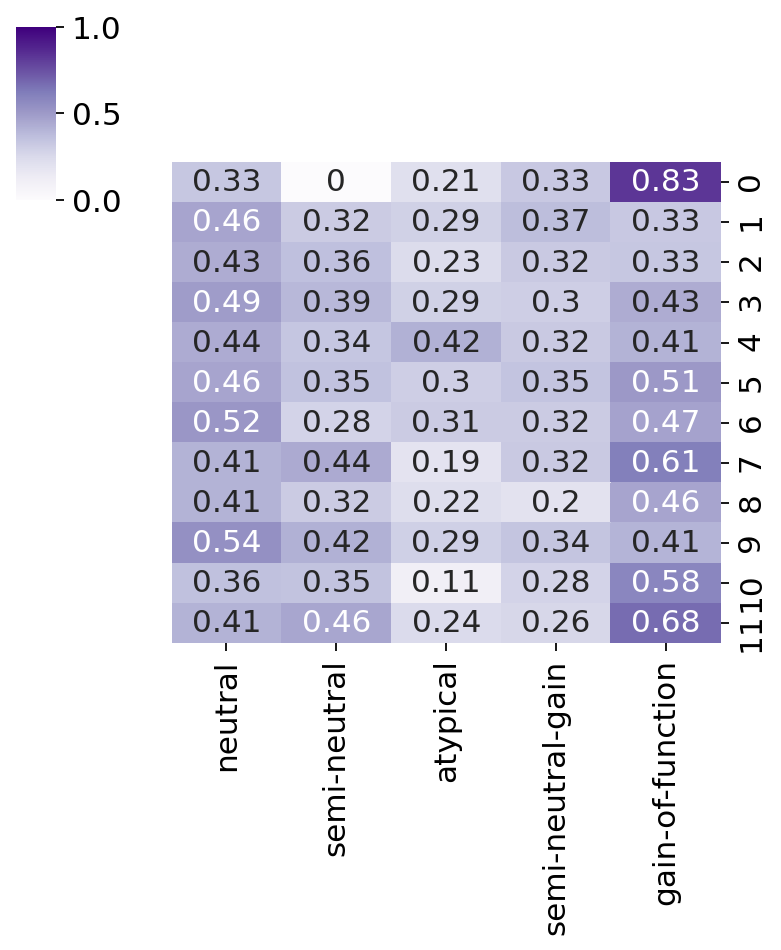

In [227]:
sns.clustermap(1-error_table.loc[['0','1','2','3','4','5','6','7','8','9','10','11'],:],
                cmap='Purples',row_cluster=False,annot=True,figsize=(5,6),
              col_cluster=False,vmin=0,vmax=1)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'performance.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'performance.png',bbox_inches = "tight")

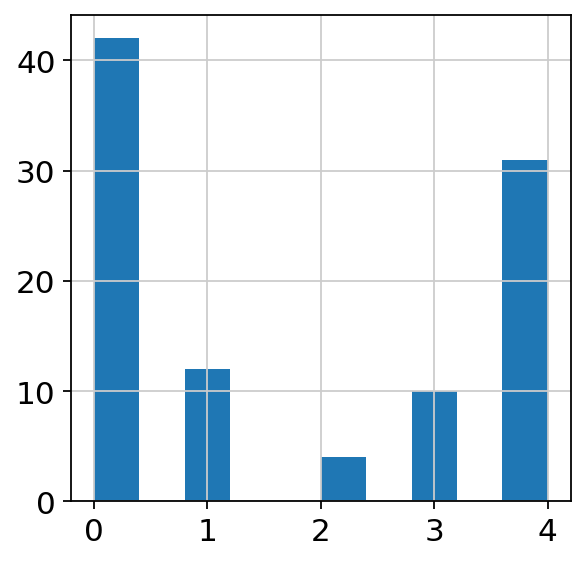

In [234]:
#now, a classifier with the bulk
X=sc_bulk

variant_mapping={'black':0,'#138D75':1,'#BB8FCE':2,'gold':3,'red':4}
keep=[]
y=[]
for i in range(len(sorted_variants)):
    variant=sorted_variants[i]
    if anno.loc[variant,'Cluster'] not in variant_mapping:
        continue
    keep.append(variant)
    var_group=variant_mapping[anno.loc[variant,'Cluster']]
    y.append(var_group)
plt.hist(y)
X=X.loc[keep,:]

In [241]:
from sklearn.model_selection import train_test_split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, random_state=0,train_size=0.5)
clf = LogisticRegression(random_state=0, multi_class='multinomial',
                         solver='saga',
                         penalty='elasticnet',
                         l1_ratio=0.5,
                         class_weight='balanced',
                        max_iter=500)
clf.fit(X_train, y_train)

#predict===================
pred_valid=clf.predict(X_valid)
pred_train=clf.predict(X_train)
print(pred_valid.shape)

(50,)


Confusion matrix, without normalization
[[20  0  0  0  0]
 [ 0  6  0  0  0]
 [ 0  0  1  0  0]
 [ 0  0  0  6  0]
 [ 0  0  2  0 14]]
Normalized confusion matrix
[[1.    0.    0.    0.    0.   ]
 [0.    1.    0.    0.    0.   ]
 [0.    0.    1.    0.    0.   ]
 [0.    0.    0.    1.    0.   ]
 [0.    0.    0.125 0.    0.875]]
Confusion matrix, without normalization
[[22  0  0  0  0]
 [ 0  6  0  0  0]
 [ 0  0  3  0  0]
 [ 0  0  1  3  0]
 [ 0  0  1  1 13]]
Normalized confusion matrix
[[1.         0.         0.         0.         0.        ]
 [0.         1.         0.         0.         0.        ]
 [0.         0.         1.         0.         0.        ]
 [0.         0.         0.25       0.75       0.        ]
 [0.         0.         0.06666667 0.06666667 0.86666667]]


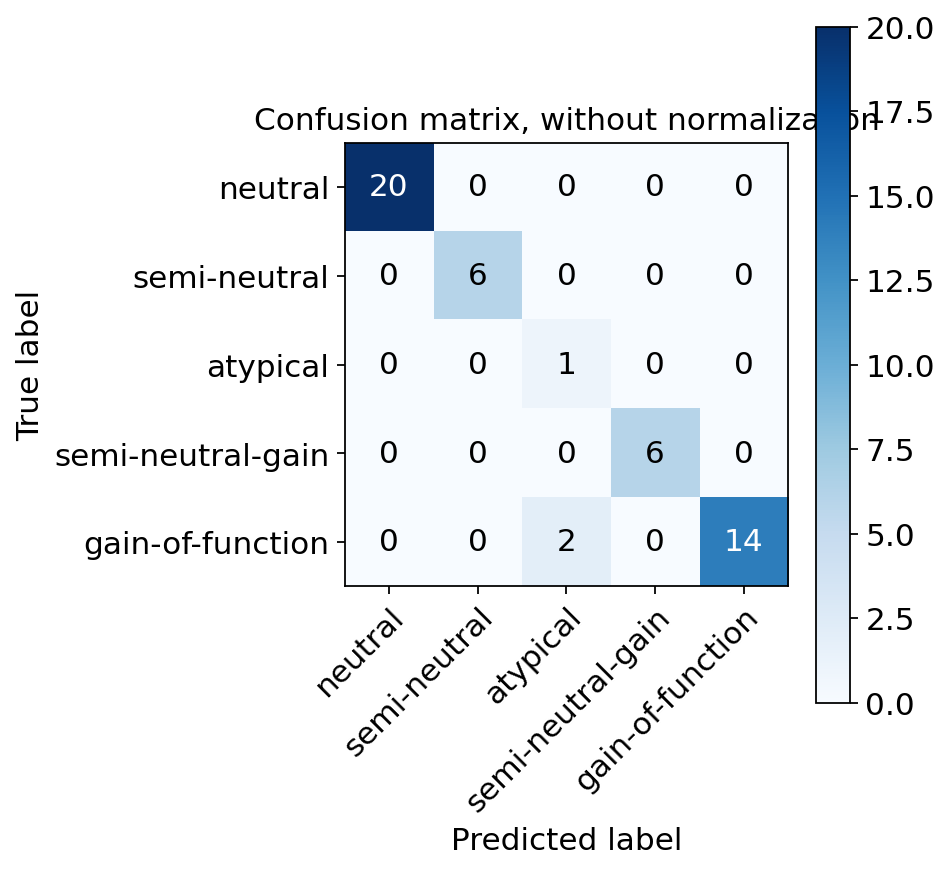

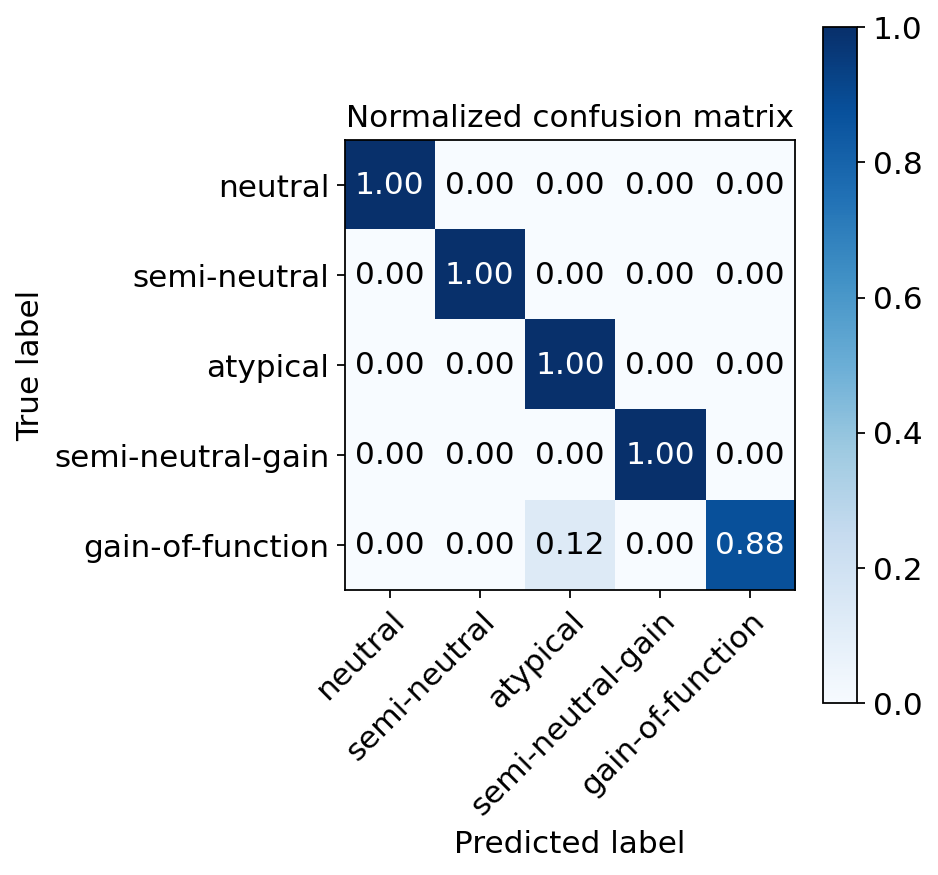

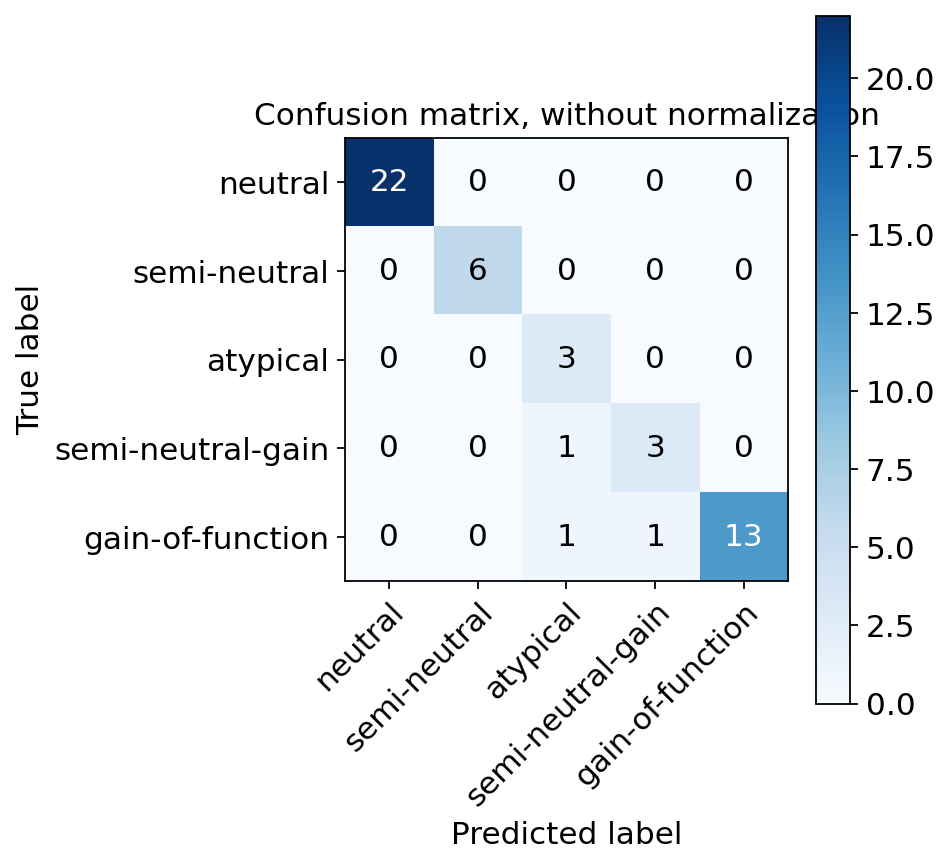

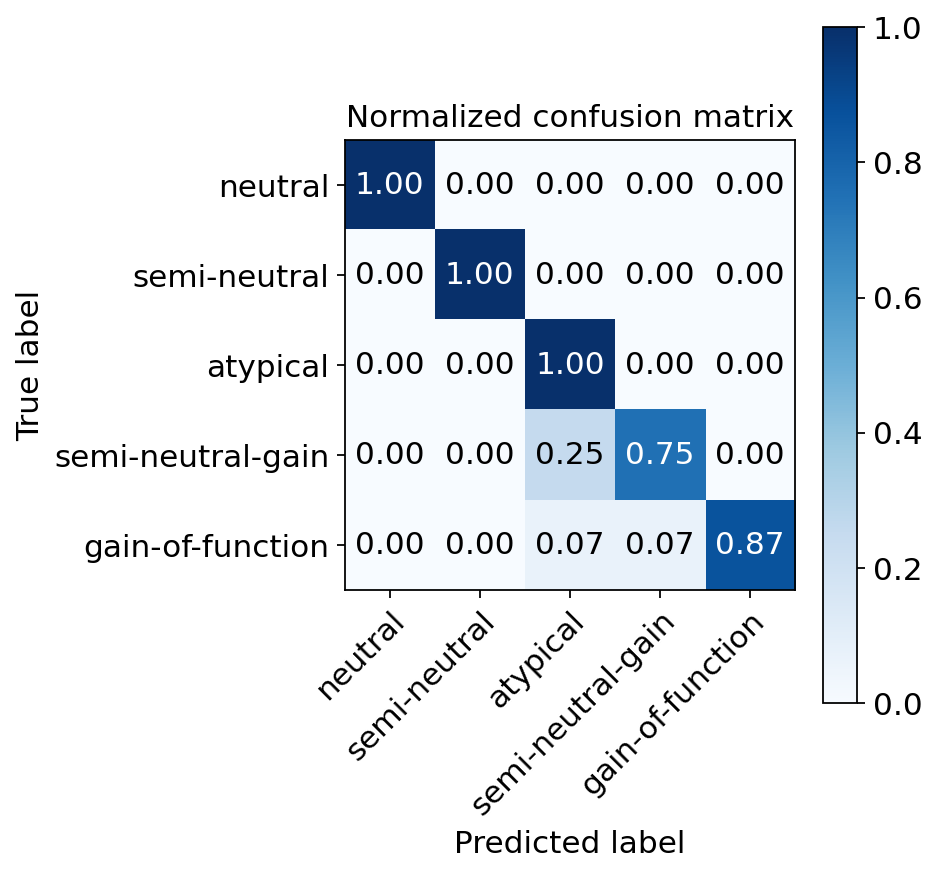

In [242]:
classes=['neutral','semi-neutral','atypical','semi-neutral-gain','gain-of-function']
plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes)

plot_confusion_matrix(y_train, 
                      pred_train, 
                      classes=classes,normalize=True)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes)

plot_confusion_matrix(y_valid, 
                      pred_valid, 
                      classes=classes,normalize=True)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat_bulk.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'confmat_bulk.png',bbox_inches = "tight")

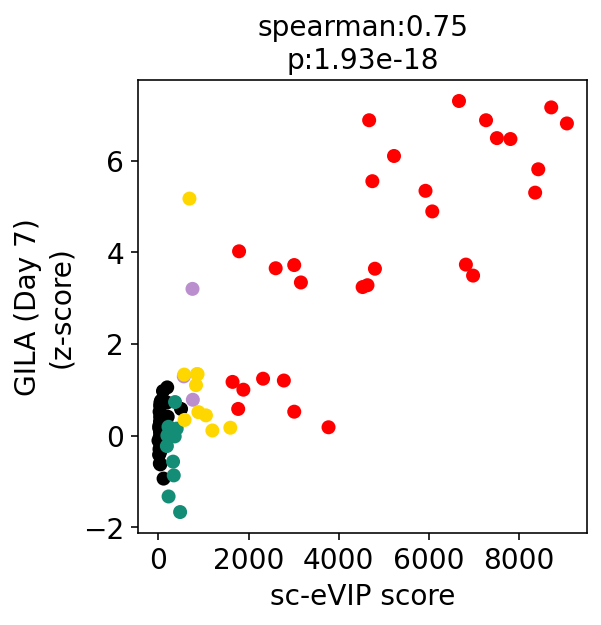

In [20]:
fun_scatter(anno.loc[sorted_variants,score],
           anno.loc[sorted_variants,'Z-Low-D7'],
           color=anno.loc[sorted_variants,'Cluster'])
plt.grid(False)
plt.xlabel('sc-eVIP score')
plt.ylabel('GILA (Day 7)\n(z-score)')
plt.savefig(FIGS+'/'+PROTEIN+'.'+'gila_vs_score.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'gila_vs_score.png',bbox_inches = "tight")

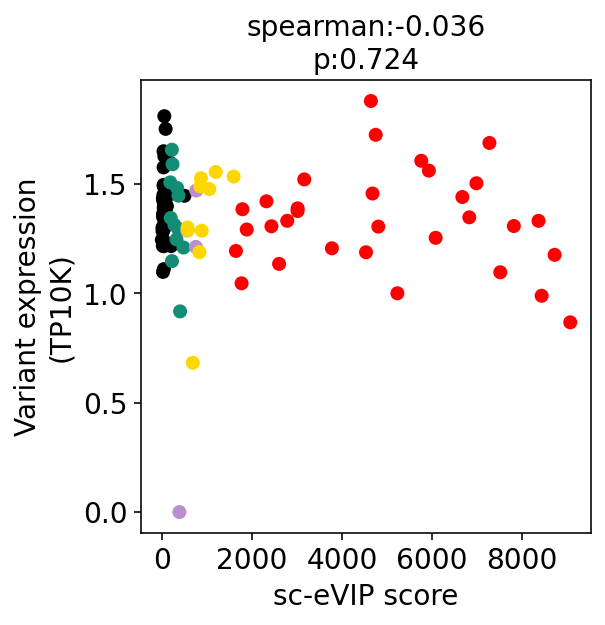

In [21]:
fun_scatter(anno.loc[sorted_variants,score],
           anno.loc[sorted_variants,'variant_expression'],
           color=anno.loc[sorted_variants,'Cluster'])
plt.grid(False)
plt.xlabel('sc-eVIP score')
plt.ylabel('Variant expression\n(TP10K)')
plt.savefig(FIGS+'/'+PROTEIN+'.'+'score_vs_vbcexpr.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'score_vs_vbcexpr.png',bbox_inches = "tight")

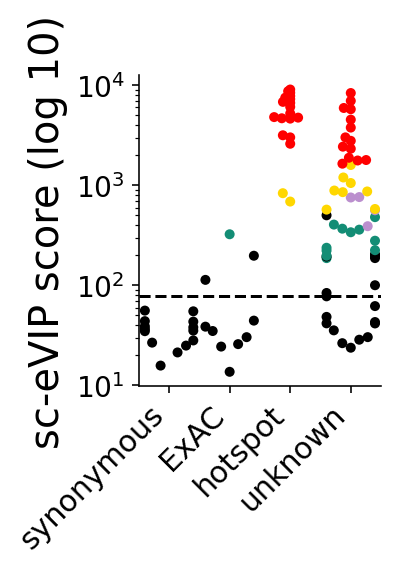

In [30]:
mypal={}
for c in set(anno['Cluster']):
    mypal[c]=c

g =sns.catplot(x="control_status2", y=score, hue='Cluster',
               data=anno,palette=mypal,
              order=['synonymous','ExAC','hotspot','unknown'],
              height=3, 
                aspect=1,legend=False,kind='swarm',s=5)
ax1 = g.axes[0,0]
ax1.axhline(y=score_thresh_value,color='black',linestyle='--')
ax1.set_xlabel('',fontsize=20)
ax1.set_ylabel('sc-eVIP score (log 10)',fontsize=20)
ax1.set_xticklabels(['synonymous','ExAC','hotspot','unknown'],rotation=45,fontsize=15,
                   ha='right')
ax1.set_yscale('log')
ax1.grid(False)
#g.set(ylim=(0,2000))
#g.set(yticks=[0.025,0.05,0.075,0.1])

plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.sceVIPscore_swarm.png',bbox_inches = "tight")

In [14]:
def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)

In [33]:
df=pd.DataFrame({'condition':anno['control_status2'],
                'value':anno[score]})

condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)

                ExAC    synonymous       unknown       hotspot
ExAC        1.000000  8.286281e-02  8.286281e-02  1.178437e-06
synonymous  0.082863  1.000000e+00  3.056084e-02  8.929788e-09
unknown     0.082863  3.056084e-02  1.000000e+00  6.174691e-10
hotspot     0.000001  8.929788e-09  6.174691e-10  1.000000e+00


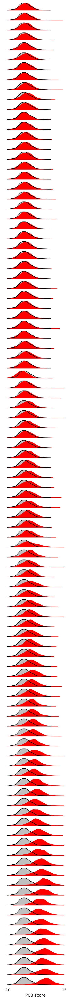

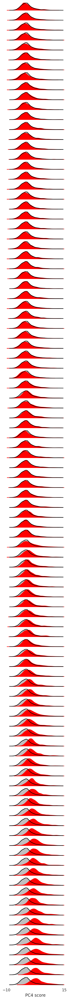

In [35]:
for PC in [3,4]:
    variants=[]
    pcs=[]
    pc_color='red'

    sns.set(rc={'axes.facecolor':'white'})
    fig, ax = plt.subplots(len(sorted_variants),1)
    fig.set_size_inches(3,50)
    mini=-10
    maxi=15
    wt=adata[adata.obs['guide.compact']=='WT',:].obsm['X_pca'][:,PC]
    for idx in range(len(sorted_variants)):
        v=sorted_variants[idx]
        #print(v,anno_known.loc[v,'variant_fullname'])
        a=adata[adata.obs['guide.compact']==v,:].obsm['X_pca'][:,PC]
        outplot=sns.distplot(-a, ax=ax[idx], kde=True,hist=False,color=pc_color,kde_kws={"shade": True})
        outplot=sns.distplot(-wt, ax=ax[idx], kde=True,hist=False,color='black',kde_kws={"shade": True})
        ax[idx].set_xlim(mini,maxi)
        #ax[idx].set_ylim(0,0.2)

        # Get the two lines from the axes to generate shading
        l1 = outplot.lines[0]

        # Get the xy data from the lines so that we can shade
        x1 = l1.get_xydata()[:,0]
        y1 = l1.get_xydata()[:,1]
        outplot.fill_between(x1,y1, color=pc_color, alpha=1)
        ax[idx].axes.get_xaxis().set_ticks([])
        ax[idx].axes.get_yaxis().set_ticks([])
        #ax[idx].axis('off')
        ax[idx].spines['left'].set_visible(True)
        ax[idx].spines['bottom'].set_visible(True)
        ax[idx].spines['right'].set_visible(True)
        ax[idx].spines['top'].set_visible(True)
        for item_idx in range(len(a)):
            variants.append(v)
            pcs.append(a[item_idx])
    ax[idx].set_xticks([mini,maxi])
    ax[idx].set_xlabel('PC'+str(PC)+' score')
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(PC)+'hist.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(PC)+'hist.png',bbox_inches = "tight")

In [17]:
bulk_programs_pc_raw=get_bulk_programs(adata,['PC'+str(x) for x in range(10)],
                                           variant_col='guide.compact',
                                           fdr=0.1)

PC0
PC1
PC2
PC3
PC4
PC5
PC6
PC7
PC8
PC9


In [21]:
bulk_programs_pc_raw.columns

Index(['PC0', 'PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9'], dtype='object')

In [20]:
anno.columns

Index(['Variant.1', 'Variant.1.1', 'Position', 'From', 'To', 'mutation_type',
       'Count_pancan', 'Count_ExAC', 'control_status', 'control_color',
       'Library_synthesis', 'long_name', 'control_status2', 'text_color',
       'HotellingT2', 'FDR.HotellingT2', 'cluster_color', 'Z-Low-D7',
       'Z-Low-D14', 'Cells/variant', 'variant expression',
       'variant_expression', 'Control', 'Cluster', 'Cluster2'],
      dtype='object')

In [27]:
pc_audata=pd.DataFrame({'pc3':bulk_programs_pc_raw.loc[sorted_variants,'PC3'],
                       'gila_d7':1.0*(anno.loc[sorted_variants,'Z-Low-D7']>3.0)})
print(pc_audata.head())
pc_audata.to_csv(DATADUMP+'/pc3_auprc.csv')

              pc3  gila_d7
Variant                   
M111L   -1.814265      0.0
T127T   -1.652536      0.0
V112I   -1.689008      0.0
R149K   -1.760109      0.0
S17S    -1.899811      0.0


In [17]:
def fun_scatter(x,y,xname='x',yname='y',width=4,height=4,corrtype='spearman',
                xlim=None,ylim=None,
                **kwargs):
    from scipy.stats import spearmanr, pearsonr
    if corrtype=='spearman':
        corr=spearmanr(x,y,nan_policy='omit')
    if corrtype=='pearson':
        corr=pearsonr(x,y)
    c,p="%.2g" % corr[0],"%.3g" % corr[1]
    fig,plots=plt.subplots(1)
    fig.set_size_inches(width,height)
    plots.scatter(x,y,**kwargs)
    plots.set_xlabel(xname)
    plots.set_ylabel(yname)
    if xlim!=None:
        plots.set_xlim(xlim)
    if ylim!=None:
        plots.set_ylim(ylim)
    plots.set_title(corrtype+':'+str(c)+'\n'+'p:'+str(p))

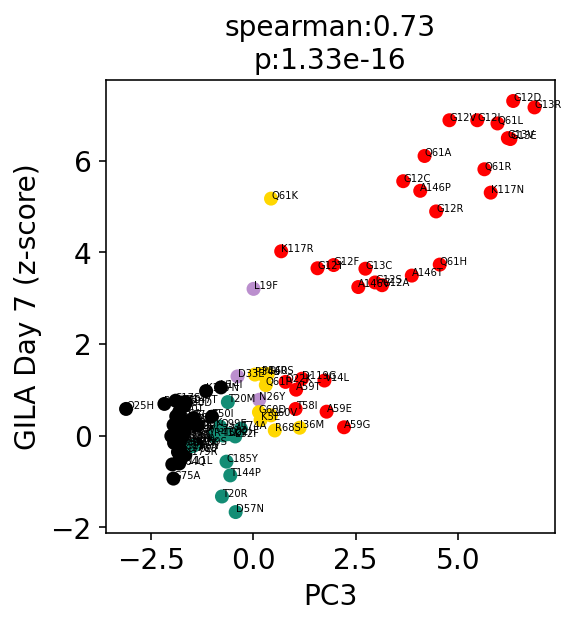

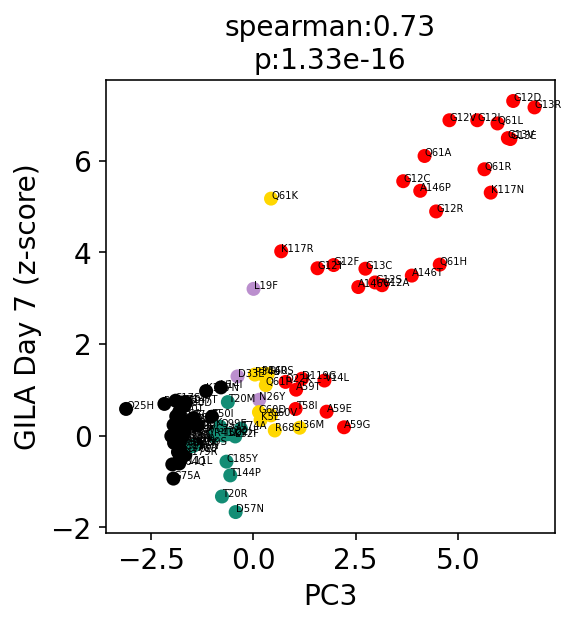

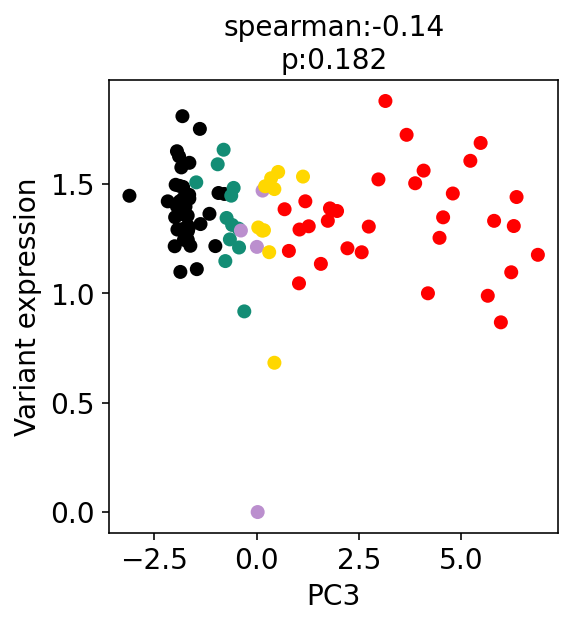

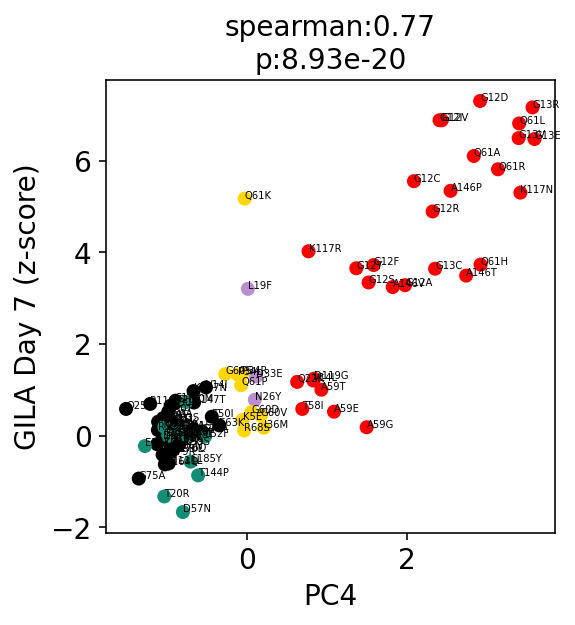

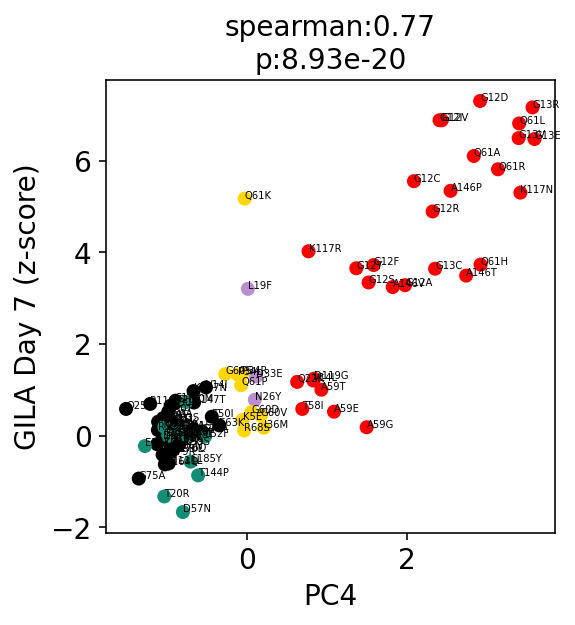

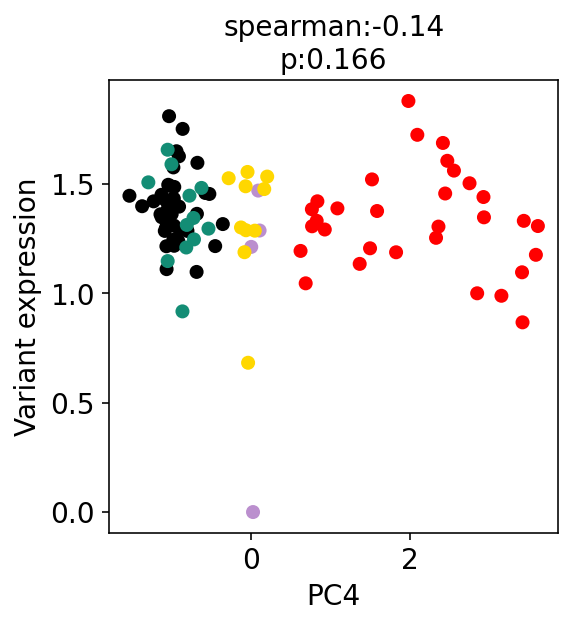

In [23]:
for pc in range(3,5):
    x='PC'+str(pc)
    y='Z-Low-D7'
    for texting in ["with_text","without_text"]:
        fun_scatter(bulk_programs_pc_raw.loc[sorted_variants,x],
                    anno.loc[sorted_variants,y],
                   c=anno.loc[sorted_variants,'Cluster'])
        plt.grid(False)
        plt.xlabel(x)
        plt.ylabel('GILA Day 7 (z-score)')
        if texting:
            for i, txt in enumerate(sorted_variants):
                plt.annotate(txt, (bulk_programs_pc_raw.loc[sorted_variants,x][i], 
                              anno.loc[sorted_variants,y][i]),fontsize=5)
        plt.savefig(FIGS+'/'+PROTEIN+'.'+texting+'.PC'+str(pc)+'vsGILA.pdf',bbox_inches = "tight") 
        plt.savefig(FIGS+'/'+PROTEIN+'.'+texting+'.PC'+str(pc)+'vsGILA.png',bbox_inches = "tight")
    plt.show()
    
    y='variant_expression'
    fun_scatter(bulk_programs_pc_raw.loc[sorted_variants,x],
            anno.loc[sorted_variants,y],
           c=anno.loc[sorted_variants,'Cluster'])
    plt.grid(False)
    plt.xlabel(x)
    plt.ylabel('Variant expression')
    #plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'vsExpr.pdf',bbox_inches = "tight") 
    #plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'vsExpr.png',bbox_inches = "tight")
    plt.show()

In [ ]:
sc.set_figure_params(figsize=(4,4),dpi=80)

for pc in range(3,5):
    sc.pl.umap(adata,color=['PC'+str(pc)],cmap='bwr',vmin=-15,vmax=15,
               save='_'+PROTEIN+'_PC'+str(pc)+'.pdf')
    sc.pl.umap(adata,color=['PC'+str(pc)],cmap='bwr',vmin=-15,vmax=15,
               save='_'+PROTEIN+'_PC'+str(pc)+'.png')

In [ ]:
pc=3
bulk_programs.loc[sorted_variants,'PC'+str(pc)].sort_values()

In [ ]:
for pc in range(3,5):
    df=pd.DataFrame({'pc':bulk_programs.loc[sorted_variants,'PC'+str(pc)],
                    'Cluster':anno.loc[sorted_variants,'Cluster']})
    mypal={}
    for i in set(df['Cluster']):
        mypal[i]=i
    g =sns.catplot(x="Cluster", y='pc', 
                  order=['black','#138D75','#BB8FCE','gold','red'],
                  height=3, 
                    aspect=1,legend=False,kind='swarm',data=df,
                  hue='Cluster',palette=mypal)

    ax1 = g.axes[0,0]
    ax1.set_xlabel('',fontsize=20)
    ax1.set_ylabel('PC'+str(pc)+' score',fontsize=20)
    ax1.set_xticklabels(['neutral','semi-neutral','atypical',
                         'semi-neutral-gain','gain-of-function'],
                        rotation=45,fontsize=15,
                       ha='right')
    ax1.grid(False)
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'means.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.PC'+str(pc)+'means.png',bbox_inches = "tight")

NameError: name 'bulk_programs' is not defined

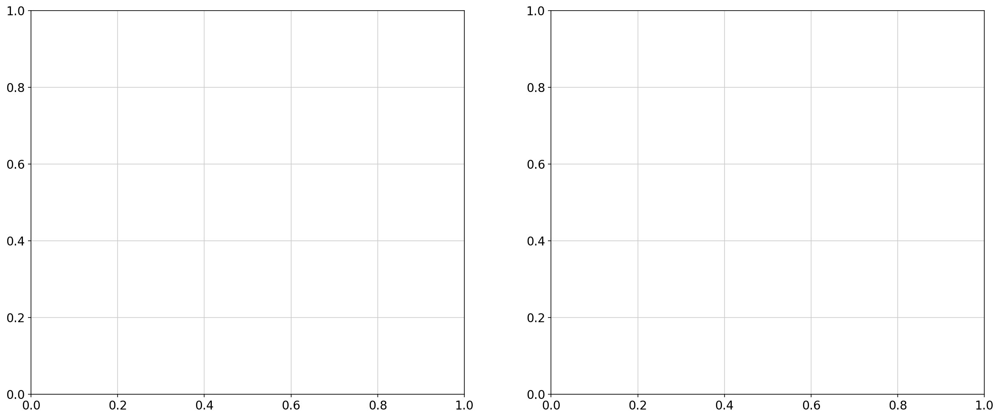

In [7]:
n_pro=2
fig,plots=plt.subplots(1,n_pro)
fig.set_size_inches(n_pro*10,8)
fig.subplots_adjust(wspace=0.2, hspace=0)

idx=0
for pro in ['PC3','PC4']:
    plots[idx].scatter(bulk_programs.loc[sorted_variants,pro],
               anno.loc[sorted_variants,'Z-Low-D7'],
                       color=anno.loc[sorted_variants,'Cluster'])
    plots[idx].set_xlabel('Mean '+pro)
    plots[idx].set_ylabel('GILA Day 7')

    for i, txt in enumerate(sorted_variants):
        plots[idx].annotate(txt, (bulk_programs.loc[sorted_variants,pro][i], 
                           anno.loc[sorted_variants,'Z-Low-D7'][i]),fontsize=7)   
    if idx!=0:
        plots[idx].set_yticks([])
    
    idx+=1

In [ ]:
FIGS

In [ ]:
anno.columns

In [ ]:
#gene analysis in the PCs
sc.set_figure_params(figsize=(4,4),dpi=200)
sc.pl.umap(adata,color=['PC3','PC4','PC5'],cmap='bwr_r')
sc.set_figure_params(figsize=(4,4),dpi=80)

In [ ]:
#now get the genes that contribute and GO them
def extract_genes_per_program(program2gene,method='zscore_on_abs_value',threshold=0,pref=''):
    
    from scipy.stats import zscore
    
    n_programs=program2gene.shape[0]
    
    program2gene_dict={}
    if method=='zscore_on_abs_value':
        #also make a nice plot with the distribution of the scores and the chosen cutoff
        program2gene_abs=np.abs(program2gene)
        program2gene_abs_z=pd.DataFrame(zscore(np.array(program2gene_abs),axis=1),
                                        index=program2gene.index,
                                        columns=program2gene.columns)
        fig,plots=plt.subplots(1,n_programs)
        fig.set_size_inches(1.5*n_programs,1)
        idx=0
        for program in list(program2gene.index):
            program2gene_dict[program]=list(program2gene_abs_z.loc[:,program2gene_abs_z.loc[program,:]>threshold].columns)
            num_genes=len(program2gene_dict[program])
            plots[idx].hist(program2gene_abs_z.loc[program,:],color='black')
            plots[idx].set_yticks([])
            plots[idx].axvline(x=threshold,color='red')
            plots[idx].grid(False)
            plots[idx].set_title(pref+str(program)+'\n'+str(num_genes)+' genes')
            idx+=1
        return(program2gene_dict)
    
def programs2go(program2gene_dict,organism="hsapiens",pref=''):
    
    gotable=pd.DataFrame(columns=['name','p_value','program'])
    
    for program in program2gene_dict:
        genes=program2gene_dict[program]
        go_res=sc.queries.enrich(genes, org=organism)
        go_res=go_res.loc[go_res['significant'],:]
        #print(go_res.head())
        gotable_current=go_res.loc[go_res['source']=='GO:BP',['name','p_value']]
        gotable_current['program']=pref+str(program)
        gotable=pd.concat([gotable,gotable_current],axis=0)
    go_table_result=gotable.pivot(index='name',columns='program')[['p_value']]
    go_table_result=go_table_result.fillna(1)
    go_table_result=-np.log10(go_table_result)
    return(go_table_result)

def programs2go(program2gene_dict,organism="hsapiens"):
    
    gotable=pd.DataFrame(columns=['name','p_value','program'])
    
    for program in program2gene_dict:
        genes=program2gene_dict[program]
        go_res=sc.queries.enrich(genes, org=organism)
        go_res=go_res.loc[go_res['significant'],:]
        #print(go_res.head())
        gotable_current=go_res.loc[go_res['source']=='GO:BP',['name','p_value']]
        if gotable_current.shape[0]==0:
            continue
        #correct p-value for multiple testing
        from statsmodels.stats.multitest import multipletests
        gotable_current['p_value']=multipletests(gotable_current['p_value'],method='fdr_bh')[1]
        gotable_current['program']='Pro: '+str(program)
        gotable=pd.concat([gotable,gotable_current],axis=0)
    go_table_result=gotable.pivot(index='name',columns='program')[['p_value']]
    go_table_result=go_table_result.fillna(1)
    go_table_result=-np.log10(go_table_result)
    
    #go through each program and print me the sig go terms
    for program in go_table_result.columns:
        keep=go_table_result.loc[go_table_result[program]>1.0,:]
        keep=keep.sort_values(by=program,ascending=False)[program]
        print(program)
        print(keep)
        print('======')
    return(go_table_result)

gene_prog=pd.DataFrame(adata.varm['PCs'],columns=range(50),index=adata.var_names)
program2gene_out=extract_genes_per_program(gene_prog.iloc[:,:10].T,threshold=2,pref='PC:')


In [ ]:
gos=programs2go(program2gene_out)
gos.shape

In [ ]:
gos['p_value'].sort_values(by='PC:3',ascending=False)

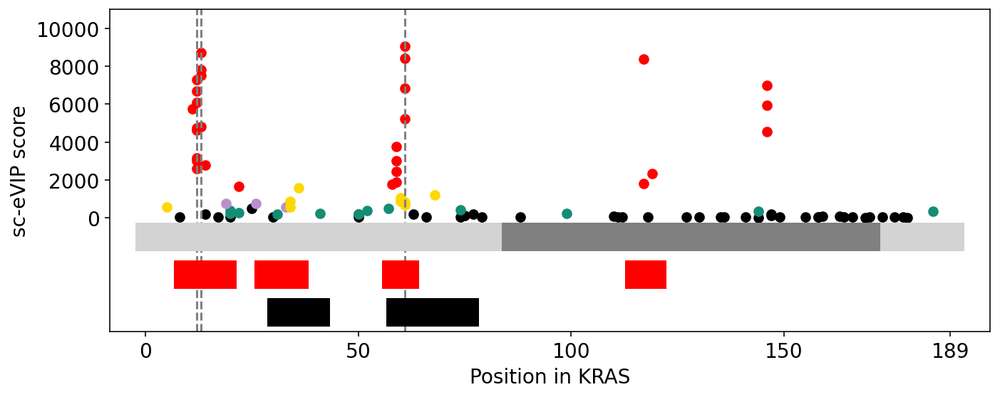

In [6]:
figwidth=11
figheight=4
fig = plt.figure()
plots = fig.add_subplot(111)
fig.set_size_inches(figwidth,figheight)


c='gray'
ymin=1000
ymax=12000

plots.axvline(x=12,linestyle='--',color=c)#,ymin=ymin,ymax=ymax)
plots.axvline(x=13,linestyle='--',color=c)
plots.axvline(x=61,linestyle='--',color=c)

#nucleotide binding domains
lw=20
plots.plot(range(10,19),[-2000 for i in range(9)],linewidth=lw,color='red')
plots.plot(range(29,36),[-2000 for i in range(7)],linewidth=lw,color='red')
plots.plot([59,61],[-2000,-2000],linewidth=lw,color='red')
plots.plot(range(116,120),[-2000 for i in range(4)],linewidth=lw,color='red')

#switches
#plots.plot(range(30,41),[0 for i in range(11)],linewidth=lw,color='gray')
#plots.plot(range(60,76),[0 for i in range(16)],linewidth=lw,color='gray')

#effector binding domains
#plots.plot(range(32,41),[-1 for i in range(9)],linewidth=lw,color='black')
#plots.plot(range(60,76),[-1 for i in range(16)],linewidth=lw,color='black')
plots.plot(range(32,41),[-4000 for i in range(9)],linewidth=lw,color='black')
plots.plot(range(60,76),[-4000 for i in range(16)],linewidth=lw,color='black')


#lobes
plots.plot(range(1,87),[0 for i in range(86)],linewidth=lw,color='lightgray')
plots.plot(range(87,173),[0 for i in range(86)],linewidth=lw,color='gray')
plots.plot(range(176,190),[0 for i in range(14)],linewidth=lw,color='lightgray')


#plots.axvline(x=61)
#plots.set_xlim(0,190)
#plots.set_ylim(-3.5,5)
plots.set_xticklabels([0,50,100,150,189])
plots.set_xticks([0,50,100,150,189])
plots.grid(False)

for var_idx in sorted_variants:
    pos=anno.loc[var_idx,'Position']
    #color by the variant type
    mut_col=anno.loc[var_idx,'cluster_color']
    y_value=anno.loc[var_idx,'HotellingT2']+1000
    plots.scatter([pos],[y_value],color=mut_col,s=40)
plots.set_yticks([1000,3000,5000,7000,9000,11000])
plots.set_yticklabels([0,2000,4000,6000,8000,10000])
plots.set_ylim(-5000,12000)

'''
plots.axvline(x=12,linestyle='dotted',color='red',ymin=0.3,ymax=1)
plots.axvline(x=13,linestyle='dotted',color='red',ymin=0.3,ymax=1)
plots.axvline(x=61,linestyle='dotted',color='red',ymin=0.3,ymax=1)
plots.axvline(x=117,linestyle='dotted',color='red',ymin=0.3,ymax=1)
plots.axvline(x=146,linestyle='dotted',color='red',ymin=0.3,ymax=1)
'''
#plots.set_yticklabels([])

plots.set_ylabel('sc-eVIP score')
plots.set_xlabel('Position in KRAS')
plt.savefig(FIGS+'/'+PROTEIN+'.ontoStr.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.ontoStr.png',bbox_inches = "tight")

In [ ]:
#===== cells/variant
#======================

adata_full=sc.read(SUBSAMPLED+'.channel_1to32.counts_per_cell'+str(counts)+'.analysis.h5ad')
print(adata_full)

new_mutstd=[]
for i in range(len(adata_full.obs_names)):
    muthere=adata_full.obs['mut.std'][i]
    if muthere=='uninfected':
        muthere='unassigned'
    new_mutstd.append(muthere)
adata_full.obs['mut.std']=new_mutstd

cells_per_variant=pd.DataFrame(adata_full.obs['mut.std'].value_counts())
cells_per_variant['variant']=list(cells_per_variant.index)
print(cells_per_variant.head())

fig,plots=plt.subplots(1)
fig.set_size_inches(0.8,20)
plots.barh(cells_per_variant.loc[sorted_variants,'variant'].iloc[::-1],
           cells_per_variant.loc[sorted_variants,'mut.std'].iloc[::-1],
          color='lightgray')
#cells_per_variant.plot.bar(x='variant',y='mut.std',ax=plots)
plots.set_xlim(0,2000)
plots.set_ylim(-0.5,len(sorted_variants)-0.5)
a=[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants[::-1],'text_color'],plots.yaxis.get_ticklabels())]
plots.grid(False)


plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.cellsPerVariant_bar.png',bbox_inches = "tight")
plt.show()

In [69]:
#mutation frequency
#functional data
f='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/results/2019-06-07/KRAS/mutational_signatures/KRAS_mutationalSignatures_Andrew.txt'
mutsig=pd.read_csv(f,sep='\t')
mutsig.index=mutsig['Mutation']

#modify the names for the synonymous ones
import re
new_vars=[]
for i in range(mutsig.shape[0]):
    v=mutsig.index[i]
    new_var_here=v
    if 'B' in v:
        new_var_here=re.sub('B',v[0],v)
    new_vars.append(new_var_here)
mutsig.index=new_vars

In [70]:
func_data=mutsig.loc[sorted_variants,['Z-Low-D7','Z-Low-D14']]

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1494: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


['P0', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7', 'P8', 'P9', 'P10', 'P11', 'P12', 'P13']


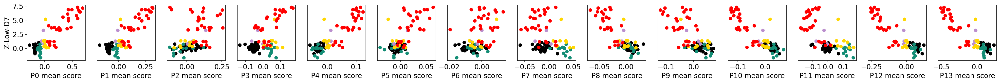

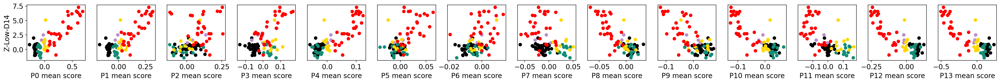

In [30]:
print(my_programs)
n_pro=len(my_programs)
for assay in func_data.columns:

    fig,plots=plt.subplots(1,n_pro)
    fig.set_size_inches(n_pro*2.5,2)
    fig.subplots_adjust(wspace=0.2, hspace=0)

    idx=0
    for pro in my_programs:

        plots[idx].scatter(adata.uns['bulk.programs.avg'].loc[sorted_variants,pro],
                   func_data.loc[sorted_variants,assay],color=anno.loc[sorted_variants,'Cluster'])
        plots[idx].set_xlabel(pro+' mean score')
        plots[idx].set_ylabel(assay)
        plots[idx].grid(False)

        if idx!=0:
            plots[idx].set_yticks([])
            plots[idx].set_ylabel('')

        idx+=1

        plt.savefig(FIGS+'/'+PROTEIN+'programs_vs_'+assay+'.pdf',bbox_inches = "tight") 
        plt.savefig(FIGS+'/'+PROTEIN+'programs_vs_'+assay+'.png',bbox_inches = "tight")
 

3 SpearmanrResult(correlation=-0.5580345214008627, pvalue=5.1159643270354035e-09)
8 SpearmanrResult(correlation=-0.5607603583687328, pvalue=4.15210376886295e-09)
9 SpearmanrResult(correlation=-0.5221698015873811, pvalue=6.75108930597544e-08)
4 SpearmanrResult(correlation=-0.6135389088607006, pvalue=4.879718516319647e-11)
11 SpearmanrResult(correlation=-0.20900525994794977, pvalue=0.043212063691274304)
12 SpearmanrResult(correlation=0.5139821619060023, pvalue=1.1679554115870595e-07)
10 SpearmanrResult(correlation=-0.1822530011817752, pvalue=0.07872665781898922)
2 SpearmanrResult(correlation=-0.60143343845012, pvalue=1.453175917679776e-10)
1 SpearmanrResult(correlation=-0.5899348671827733, pvalue=3.930722076996199e-10)
13 SpearmanrResult(correlation=0.13033675566647, pvalue=0.21053240212790844)
7 SpearmanrResult(correlation=-0.5797599872508102, pvalue=9.183127155815879e-10)
6 SpearmanrResult(correlation=-0.5686190932233347, pvalue=2.250396917785274e-09)
0 SpearmanrResult(correlation=0.78

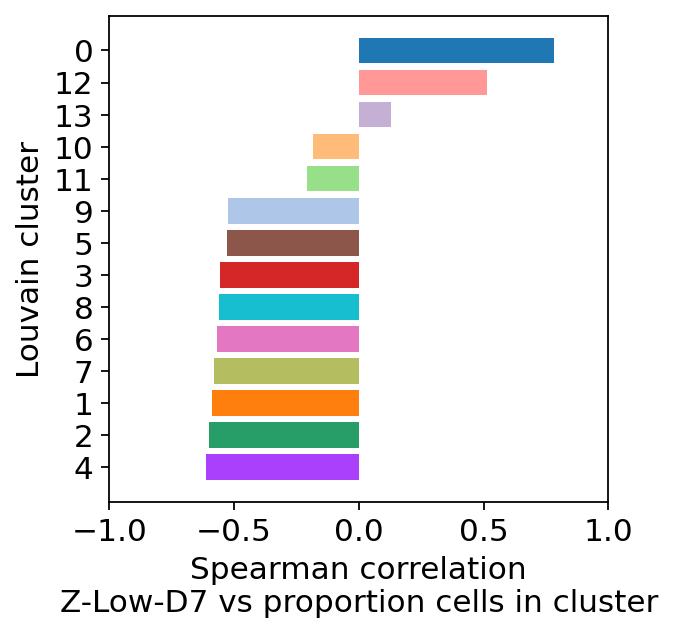

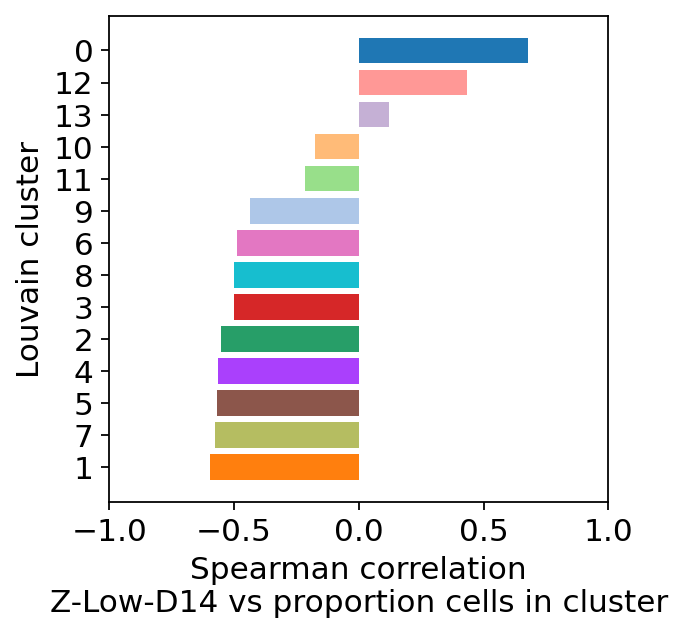

In [71]:
#corr louvain proportions with assays
#barplot with all the correlations

for assay in func_data.columns:
    louvs=set(adata.obs['louvain'])
    corr_assay=pd.DataFrame({'corr':0},index=louvs)
    for cl in louvs:
        from scipy.stats import spearmanr
        corres=spearmanr(louv_res['data.norm'].loc[sorted_variants,cl],
                   func_data.loc[sorted_variants,assay],nan_policy='omit')
        print(cl,corres)
        c=corres[0]
        corr_assay.loc[cl,'corr']=c

    corr_assay=corr_assay.sort_values(by='corr')

    #cluster colors
    categories=adata.obs['louvain'].cat.categories
    colors=pd.DataFrame({'cl':categories,'color':adata.uns['louvain_colors']},index=categories)
    print(colors)

    fig,plots=plt.subplots(1)
    fig.set_size_inches(4,4)
    plots.barh(corr_assay.index,corr_assay['corr'],color=colors.loc[corr_assay.index,'color'])
    plots.set_xlim(-1,1)
    plots.grid(False)
    plots.set_xlabel('Spearman correlation\n'+assay+' vs proportion cells in cluster')
    plots.set_ylabel('Louvain cluster')

    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'.png',bbox_inches = "tight")

In [72]:
set(adata.obs['louvain'])

{'0', '1', '10', '11', '12', '13', '2', '3', '4', '5', '6', '7', '8', '9'}

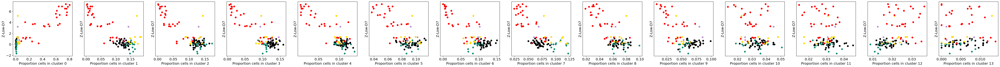

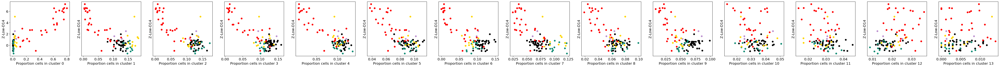

In [73]:
#proportion of each Louvain vs the func data

for assay in func_data.columns:

    n=len(list(set(adata.obs['louvain'])))
    fig,plots=plt.subplots(1,n)
    fig.set_size_inches(n*5,4)
    fig.subplots_adjust(wspace=0.2, hspace=0)

    idx=0
    for cl in ['0','1','2','3','4',
               '5','6','7','8','9',
               '10','11','12','13']:

        plots[idx].scatter(louv_res['data.norm'].loc[sorted_variants,cl],
                   func_data.loc[sorted_variants,assay],
                          color=anno.loc[sorted_variants,'cluster_color'])
        plots[idx].set_xlabel('Proportion cells in cluster '+cl)
        plots[idx].set_ylabel(assay)
        plots[idx].grid(False)

        '''
        for i, txt in enumerate(sorted_variants):
            plots[idx].annotate(txt, (louv_res['data.norm'].loc[sorted_variants,cl][i], 
                               func_data.loc[sorted_variants,assay][i]),fontsize=7)
        '''
        if idx!=0:
            plots[idx].set_yticks([])

        idx+=1
    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'_scatter.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'.louvain_proportion_vs_'+assay+'_scatter.png',bbox_inches = "tight")
    plt.show()

In [34]:
sc_bulk.head()

,G13E,G13R,G13V,K117N,Q61L,Q61R,A146P,A146T,A146V,A59G,...,K179R,L79I,M170L,P110S,Q25H,R135T,T158A,T20T,T50T,WT
A1BG,-0.096726,-0.036361,-0.060067,-0.081137,-0.066663,-0.040436,-0.052176,-0.072127,-0.022090,-0.022751,...,0.007972,0.023299,-0.024442,-0.048761,-0.054824,-0.004463,-0.014970,0.032751,0.062655,-0.034554
AATF,0.110289,0.033220,0.006779,0.057024,0.005038,-0.019057,0.112566,-0.037636,0.014879,0.018725,...,-0.007224,-0.036627,-0.029880,-0.022016,-0.083035,-0.030357,-0.018516,-0.024425,0.003086,0.046707
ABCA1,0.121770,0.192711,0.050862,0.191308,0.106640,0.044954,0.074089,-0.059338,0.009009,-0.014361,...,-0.024531,-0.070880,-0.078216,-0.077464,-0.103335,-0.034884,-0.035422,-0.052188,-0.092621,-0.064164
ABCC2,-0.150713,-0.085963,-0.166408,-0.054443,-0.030185,-0.111912,0.007726,-0.103092,-0.012153,-0.029566,...,0.003234,0.061033,0.033396,0.040851,0.048439,0.011032,0.012974,0.017917,0.027819,0.019893
ABCD4,0.044629,-0.011120,-0.024924,0.024469,-0.016362,-0.038176,-0.012374,0.014204,0.034862,-0.017719,...,0.048267,-0.039773,0.009566,0.003351,-0.036858,-0.016242,-0.015570,0.014823,0.000994,-0.027527


0
100
200
300
400
500
600
700
800
900
1000
1100


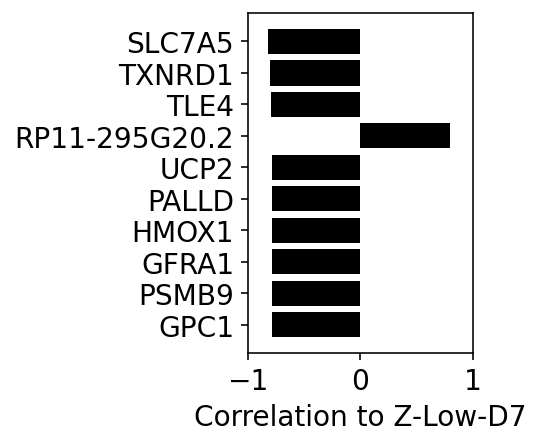

0
100
200
300
400
500
600
700
800
900
1000
1100


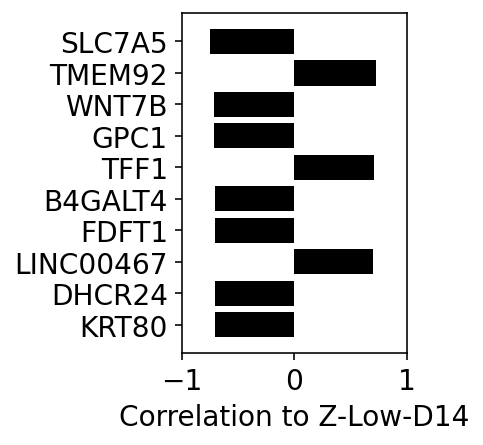

In [35]:
for assay in func_data.columns:

    f_corr=pd.DataFrame({'gene':adata.var_names,'corr':0},index=adata.var_names)
    from scipy.stats import spearmanr,pearsonr
    counter=0
    for gene in adata.var_names:
        if counter%100==0:
            print(counter)
        counter+=1
        c=spearmanr(sc_bulk.T.loc[sorted_variants,gene],
                    func_data.loc[sorted_variants,assay],nan_policy='omit')[0]
        f_corr.loc[gene,'corr']=c
        
    #plot me the top correlated/anticorr genes
    fig,plots=plt.subplots(1)
    fig.set_size_inches(2,3)


    absolutes=pd.DataFrame(f_corr['corr']).abs()
    top_genes=absolutes.sort_values(by='corr',ascending=False).index[:10]



    plots.barh(top_genes,f_corr.loc[top_genes,'corr'],color='black')
    plots.invert_yaxis()
    plots.grid(False)
    plots.set_xlabel('Correlation to '+assay)
    plots.set_title('')
    plots.set_xlim(-1,1)
    plt.savefig(FIGS+'/'+PROTEIN+'func_genes_'+assay+'.pdf',bbox_inches = "tight") 
    plt.savefig(FIGS+'/'+PROTEIN+'func_genes_'+assay+'.png',bbox_inches = "tight")
    plt.show()
    

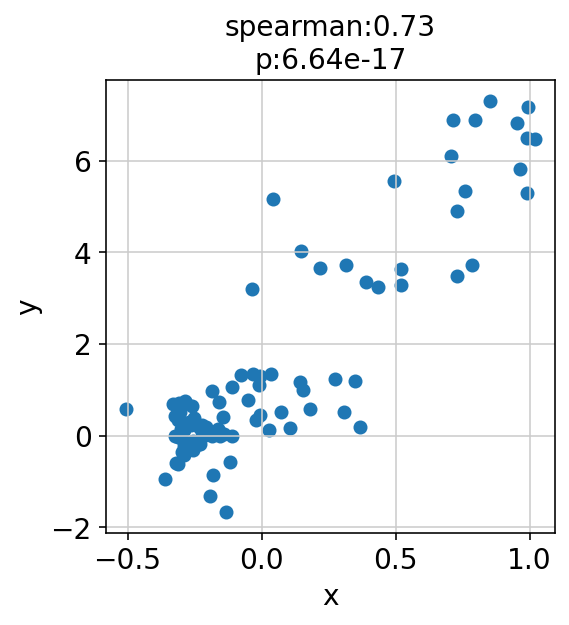

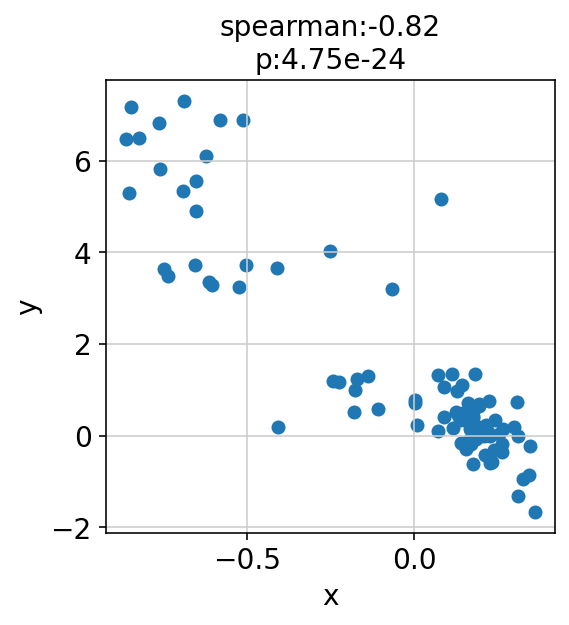

In [38]:
#phenotyping vs program scores
def fun_scatter(x,y,xname='x',yname='y',width=4,height=4,corrtype='spearman',
                xlim=None,ylim=None,
                **kwargs):
    from scipy.stats import spearmanr, pearsonr
    if corrtype=='spearman':
        corr=spearmanr(x,y,nan_policy='omit')
    if corrtype=='pearson':
        corr=pearsonr(x,y)
    c,p="%.2g" % corr[0],"%.3g" % corr[1]
    fig,plots=plt.subplots(1)
    fig.set_size_inches(width,height)
    plots.scatter(x,y,**kwargs)
    plots.set_xlabel(xname)
    plots.set_ylabel(yname)
    if xlim!=None:
        plots.set_xlim(xlim)
    if ylim!=None:
        plots.set_ylim(ylim)
    plots.set_title(corrtype+':'+str(c)+'\n'+'p:'+str(p))


fun_scatter(sc_bulk.T.loc[sorted_variants,'DUSP4'],
           func_data.loc[sorted_variants,'Z-Low-D7'])

fun_scatter(sc_bulk.T.loc[sorted_variants,'SLC7A5'],
           func_data.loc[sorted_variants,'Z-Low-D7'])

             DepMap_ID  A1BG (1)  A1CF (29974)   A2M (2)  A2ML1 (144568)  \
DepMap_ID                                                                  
ACH-000004  ACH-000004  0.181037      0.088391 -0.198152       -0.017571   
ACH-000005  ACH-000005 -0.090250      0.239763  0.189079        0.160173   
ACH-000007  ACH-000007  0.071568      0.075337 -0.062467        0.157945   
ACH-000009  ACH-000009  0.110311     -0.007609 -0.050729        0.054225   
ACH-000011  ACH-000011  0.275160      0.079905  0.015479        0.437617   

            A3GALT2 (127550)  A4GALT (53947)  A4GNT (51146)  AAAS (8086)  \
DepMap_ID                                                                  
ACH-000004          0.042043       -0.192351       0.353854    -0.442200   
ACH-000005         -0.190621       -0.335628       0.248029    -0.583917   
ACH-000007          0.102321        0.141652       0.067589    -0.474084   
ACH-000009          0.079221       -0.040144       0.082471    -0.641426   
ACH-000011 

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (19,29,30) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


  Hugo_Symbol  Entrez_Gene_Id  NCBI_Build Chromosome  Start_position  \
0        A1BG               1          37         19        58858743   
1        A1BG               1          37         19        58858810   
2        A1BG               1          37         19        58858867   
3        A1BG               1          37         19        58858872   
4        A1BG               1          37         19        58858914   

   End_position Strand Variant_Classification Variant_Type Reference_Allele  \
0      58858743      +      Missense_Mutation          SNP                C   
1      58858810      +                 Silent          SNP                C   
2      58858867      +      Missense_Mutation          SNP                C   
3      58858872      +      Missense_Mutation          SNP                C   
4      58858914      +      Missense_Mutation          SNP                C   

   ...   ExAC_AF CGA_WES_AC SangerWES_AC SangerRecalibWES_AC RNAseq_AC HC_AC  \
0  ...      

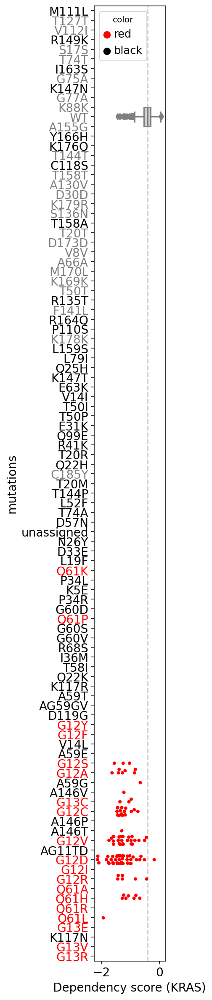

In [10]:
#depmap

import re

depdata='/ahg/regevdata/projects/bn10_cancer_variants/bn10_oana_2018-06-22/results/2018-06-22/data/functional_data/dependency/2020-Q3'
dep=pd.read_csv(depdata+'/Achilles_gene_effect_20Q3.csv',header=0)
dep.index=dep.iloc[:,0]
print(dep.head())

muts=pd.read_csv(depdata+'/CCLE_mutations_20Q3.csv',sep='\t')
print(muts.head())
muts.index=muts['DepMap_ID']
print(muts.columns)

muts=muts.loc[muts['Hugo_Symbol']=='KRAS',:]

muts['variant_name']=muts['Protein_Change']

#now, go through each cell line in dep, find its variants in muts and annotate
mut_ids=[]
for i in range(dep.shape[0]):
    cellname=dep.index[i]
    mut_set=set()
    if cellname in muts.index:
        for m in range(muts.shape[0]):
            if muts.index[m]!=cellname:
                continue
            mut=muts['variant_name'][m]
            mut_set.add(re.sub('p[.]','',mut))
    mut_id=','.join(list(mut_set))
    if len(list(mut_set))==0:
        mut_id='WT'
    mut_ids.append(mut_id)
    
dep['mutations']=mut_ids

dep['color']='black'

colors=[]
for i in range(dep.shape[0]):
    v=dep['mutations'][i]
    col_add='black'
    if v in anno.index:
        col_add=anno.loc[v,'cluster_color']
    colors.append(col_add)
dep['color']=colors 

figwidth=1.5
figheight=20
fig, ax = plt.subplots(1)
fig.set_size_inches(figwidth,figheight)

palette={'black':'black','gold':'gold','red':'red','pink':'pink','darkred':'darkred',
        'white':'pink'}
ax1 = sns.boxplot(y='mutations',x='KRAS (3845)',data=dep.loc[dep['mutations']=='WT',:],
                  order=sorted_variants,ax=ax,color='lightgray',width=2)
ax1 = sns.swarmplot(y='mutations',x='KRAS (3845)',data=dep.loc[dep['mutations']!='WT',:],
                    order=sorted_variants,ax=ax,hue=dep.loc[dep['mutations']!='WT','color'],
                    s=4,palette=palette)
ax.set_xlabel('Dependency score (KRAS)')
ax.grid(False)
ax.axvline(x=np.median(dep.loc[dep['mutations']=='WT','KRAS (3845)']),
           linestyle='--',color='lightgray')

[t.set_color(i) for (i,t) in
 zip(anno.loc[sorted_variants,'text_color'],ax.yaxis.get_ticklabels())]

plt.savefig(FIGS+'/KRAS.DepMap.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/KRAS.DepMap.png',bbox_inches = "tight")


plt.show()


In [31]:
def pairwise_ttests(df,condition,value):

    pval_m=pd.DataFrame(0.0,index=conditions,columns=conditions)

    for m1 in conditions:
        m1_values=df.loc[df[condition]==m1,value]
        for m2 in conditions:
            m2_values=df.loc[df[condition]==m2,value]

            from scipy.stats import ttest_ind
            res=ttest_ind(m1_values,m2_values,nan_policy='omit')

            pval_m.loc[m1,m2]=res[1]
            pval_m.loc[m2,m1]=pval_m.loc[m1,m2]
            
    #correct for multiple testing
    from statsmodels.stats.multitest import multipletests
    pvals=np.array(pval_m).flatten()
    new_pvals=multipletests(pvals,method='fdr_bh')[1]
    pval_m2=pd.DataFrame(new_pvals.reshape(pval_m.shape),index=pval_m.index,columns=pval_m.columns)
    return(pval_m2)

In [8]:



df=pd.DataFrame({'condition':dep.loc[dep['mutations'].isin(sorted_variants),'mutations']=='WT',
                'value':dep.loc[dep['mutations'].isin(sorted_variants),'KRAS (3845)'],
                'mutations':dep.loc[dep['mutations'].isin(sorted_variants),'mutations']})

condition='condition'
value='value'
conditions=set(df[condition])
pval_m=pairwise_ttests(df,'condition','value')
print(pval_m)

               False          True 
False   1.000000e+00  8.253844e-147
True   8.253844e-147   1.000000e+00


In [9]:
set(df['mutations'])

{'A146T',
 'A146V',
 'A59G',
 'G12A',
 'G12C',
 'G12D',
 'G12R',
 'G12S',
 'G12V',
 'G13C',
 'Q61H',
 'Q61L',
 'WT'}

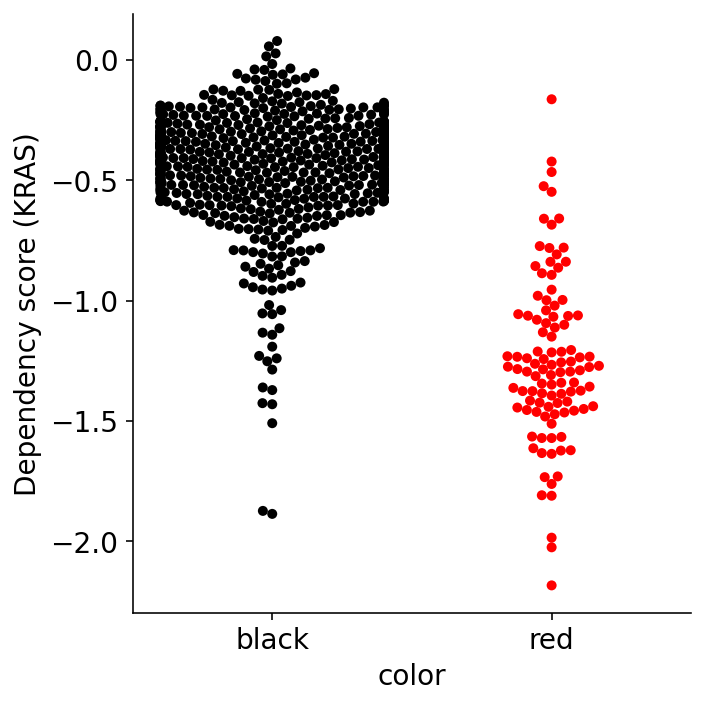

In [10]:
mypal={'black':'black','red':'red'}
sns.catplot(x='color',y='KRAS (3845)',data=dep,order=['black','red'],
           kind='swarm',palette=mypal)
plt.grid(False)
plt.ylabel('Dependency score (KRAS)')
plt.savefig(FIGS+'/KRAS.DepMap_swarm.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/KRAS.DepMap_swarm.png',bbox_inches = "tight")

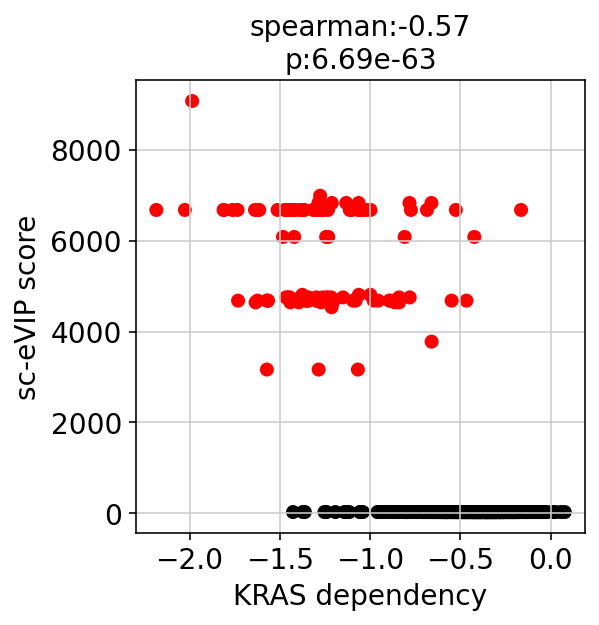

In [17]:
dep_small=dep.loc[dep['mutations'].isin(list(set(adata.obs['guide.compact']))),:]
def fun_scatter(x,y,xname='x',yname='y',width=4,height=4,corrtype='spearman',
                xlim=None,ylim=None,
                **kwargs):
    from scipy.stats import spearmanr, pearsonr
    if corrtype=='spearman':
        corr=spearmanr(x,y,nan_policy='omit')
    if corrtype=='pearson':
        corr=pearsonr(x,y)
    c,p="%.2g" % corr[0],"%.3g" % corr[1]
    fig,plots=plt.subplots(1)
    fig.set_size_inches(width,height)
    plots.scatter(x,y,**kwargs)
    plots.set_xlabel(xname)
    plots.set_ylabel(yname)
    if xlim!=None:
        plots.set_xlim(xlim)
    if ylim!=None:
        plots.set_ylim(ylim)
    plots.set_title(corrtype+':'+str(c)+'\n'+'p:'+str(p))
    
fun_scatter(dep_small['KRAS (3845)'],anno.loc[dep_small['mutations'],score],
           color=anno.loc[dep_small['mutations'],'Cluster'])
plt.xlabel('KRAS dependency')
plt.ylabel('sc-eVIP score')
plt.savefig(FIGS+'/KRAS.DepMap_vs_scevip.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/KRAS.DepMap_vs_scevip.png',bbox_inches = "tight")

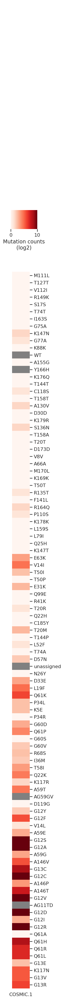

In [14]:
x=10

sns.set(rc={'axes.facecolor':'gray'})
mutdata=pd.DataFrame(np.log2(1+mutsig['COSMIC.1'].astype(float)))

g=sns.clustermap(mutdata.loc[sorted_variants,:],cmap='Reds',
                 vmin=0,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.73, 0.85, 0.015),
                 cbar_kws={'orientation':'horizontal',
                "label": "Mutation counts\n(log2)",
                'ticks':[0,x]},
                figsize=(1,40)) 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_COSMIC.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_COSMIC.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:1190: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


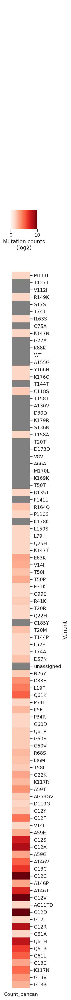

In [15]:
x=10

sns.set(rc={'axes.facecolor':'gray'})
mutdata=pd.DataFrame(np.log2(1+anno['Count_pancan'].astype(float)))

g=sns.clustermap(mutdata.loc[sorted_variants,:],cmap='Reds',
                 vmin=0,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.73, 0.85, 0.015),
                 cbar_kws={'orientation':'horizontal',
                "label": "Mutation counts\n(log2)",
                'ticks':[0,x]},
                figsize=(1,40)) 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_pancan.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'mutfreq_pancan.png',bbox_inches = "tight")

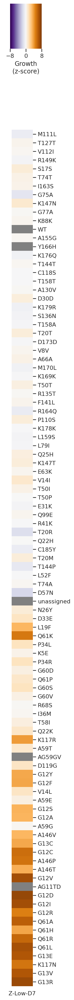

In [18]:
x=8

sns.set(rc={'axes.facecolor':'gray'})
g=sns.clustermap(mutsig.loc[sorted_variants,'Z-Low-D7'],
                 cmap='PuOr_r',vmin=-x,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.75, 0.85, 0.03),
                 cbar_kws={'orientation':'horizontal',
                "label": "Growth\n(z-score)",
                'ticks':[-x,0,x]},
                figsize=(1,40)) 
g.ax_col_dendrogram.set_visible(False)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'GILA_D7.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'GILA_D7.png',bbox_inches = "tight")

/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1494: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)
/ahg/regevdata/users/oursu/software/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:1190: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  self.fig.tight_layout(**tight_params)


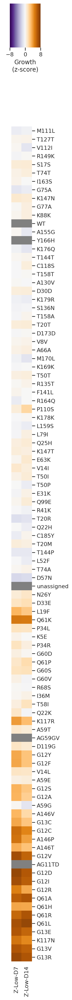

In [19]:
x=8

sns.set(rc={'axes.facecolor':'gray'})
g=sns.clustermap(mutsig.loc[sorted_variants,['Z-Low-D7','Z-Low-D14']],
                 cmap='PuOr_r',vmin=-x,vmax=x,
              row_cluster=False,yticklabels=True,col_cluster=False,
                 cbar_pos=(0.35, 0.75, 0.85, 0.03),
                 cbar_kws={'orientation':'horizontal',
                "label": "Growth\n(z-score)",
                'ticks':[-x,0,x]},
                figsize=(1,40)) 
g.ax_col_dendrogram.set_visible(False)
plt.savefig(FIGS+'/'+PROTEIN+'.'+'GILA_D7D14.pdf',bbox_inches = "tight") 
plt.savefig(FIGS+'/'+PROTEIN+'.'+'GILA_D7D14.png',bbox_inches = "tight")